## **Name of group members:**

- **NGUEPONWOUO Joseph-Marie**
- **GARDIN Emmanuel**



### **NUMERICAL METHODS FOR PDE IN FINANCE : MEAN FIELD GAMES WITH CONGESTION EFFECTS**

In [ ]:
import numpy as np
import scipy
import time

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# **1. Finite Differences Operators**

We introduce the following finite differences operators:

$$
∂_t \ w(t_n, x) \Longleftrightarrow  (D_t \ W)^n = \frac{W^{n+1} - W^n}{\Delta t}, \ \ n \in {0, ..., N_T - 1}, \ W \in \mathbb{R}^{N_T + 1} \\
∂_x \ w(t, x_i) \Longleftrightarrow  (D_x \ W)_i = \frac{W_{i+1} - W_i}{h}, \ \ i \in {0, ..., N_h - 1}, \ W \in \mathbb{R}^{N_h} \\
∂_x^2 \ w(t, x_i) \Longleftrightarrow  (\Delta_h \ W)_i = \frac{W_{i+1} - 2W_i + W_{i-1}}{h^2}, \ \ i \in {0, ..., N_h - 1}, \ W \in \mathbb{R}^{N_h} \\
[∇_h W]_i = ((DW)_i, (DW)_{i-1}), \ \ i \in {0, ..., N_h - 1}, \ W \in \mathbb{R}^{N_h}
$$


$$
\left(\partial_x (t_n, x_i) \right)_{}
\longleftrightarrow
\frac{1}{h}
\begin{pmatrix}
-1 & 1 & 0 & 0 & \cdots & 0 \\\\
0 & -1 & 1 & 0 & \cdots & 0 \\\\
0 & 0 & -1 & 1 & \cdots & 0 \\\\
\vdots & \vdots & \vdots & \ddots & \ddots & \vdots \\\\
0 & 0 & 0 & \cdots & -1 & 1 \\\\
0 & 0 & 0 & \cdots & 0 & 0
\end{pmatrix}
\quad
\begin{pmatrix}
W_0^0 & W_0^1 & \cdots & W_0^{N_T} \\\\
W_1^0 & W_1^1 & \cdots & W_1^{N_T} \\\\
\vdots & \vdots & \ddots & \vdots \\\\
W_{N_h-1}^0 & W_{N_h-1}^1 & \cdots & W_{N_h-1}^{N_T}
\end{pmatrix}
$$

In the last row, we took into account Neumann conditions, considering the fact that $U_{N_h} = U_{N_h - 1}$ and $M_{N_h} = M_{N_h - 1}$. Let $D_x$ be the matrix above.

Again, taking into account Neumann conditions:

$$
\left( \partial_x^2 (t_n, x_i) \right)_{\substack{0 \leq n \leq N_T \\ 0 \leq i \leq N_h - 1}}
\longleftrightarrow
\frac{1}{h^2}
\begin{pmatrix}
-1 & 1 & 0 & 0 & \cdots & 0 \\\\
1 & -2 & 1 & 0 & \cdots & 0 \\\\
0 & 1 & -2 & 1 & \cdots & 0 \\\\
\vdots & \vdots & \ddots & \ddots & \ddots & \vdots \\\\
0 & 0 & \cdots & 0 & -2 & 1 \\\\
0 & 0 & \cdots & 0 & 1 & -1
\end{pmatrix}
\quad
\begin{pmatrix}
W_0^0 & W_0^1 & \cdots & W_0^{N_T} \\\\
W_1^0 & W_1^1 & \cdots & W_1^{N_T} \\\\
\vdots & \vdots & \ddots & \vdots \\\\
W_{N_h-1}^0 & W_{N_h-1}^1 & \cdots & W_{N_h-1}^{N_T}
\end{pmatrix}
$$

Denote by $D_x^2$ the matrix above.

Notice that the matrix of

$$
((DW)_{i-1} = \frac{1}{h}(W_i - W_{i-1}))_{0 \leq i < N_h}
$$

is (because of Neumann conditions):

$$
\frac{1}{h}
\begin{pmatrix}
0 & 0 & 0 & 0 & \cdots & 0 \\\\
-1 & 1 & 0 & 0 & \cdots & 0 \\\\
0 & -1 & 1 & 0 & \cdots & 0 \\\\
\vdots & \vdots & \ddots & \ddots & \ddots & \vdots \\\\
0 & 0 & \cdots & 0 & -1 & 1
\end{pmatrix}
$$




# **2. Solving HJB Equation**

To elaborate a discrete version of the HJB equation, we need to have a discrete version of the Hamiltonian. We will model $H_0(p, \mu) = \frac{1}{\beta} \frac{|p|^\beta}{(c_0 + c_1 \mu)^\alpha}$ by:

$$
\tilde{H}(p_1, p_2, \mu) = \frac{1}{\beta} \frac{\left( (p_1)_-^2 + (p_2)_+^2 \right)^{\frac{\beta}{2}}}{(c_0 + c_1 \mu)^\alpha} \tag{16}
$$

where $x_+ = \max(0, x)$ and $x_- = \max(0, -x)$. Note that $\tilde{H}$ takes three arguments.

We can now consider the following discrete version of the HJB equation, supplemented with the Neumann conditions and the terminal condition:

$$
\left\{
\begin{aligned}
    &-(D_t U_i)^n - \nu (\Delta_h U^n)_i + \tilde{H}(\nabla_h U^n]_i, M_i^{n+1}) = g(x_i) + \tilde{f}_0(M_i^{n+1}), & \quad 0 \le i < N_h, \; 0 \le n < N_T \\\\
    &U_{-1}^n = U_0^n, & \quad 0 \le n < N_T \\\\
    &U_{N_h}^n = U_{N_h-1}^n, & \quad 0 \le n < N_T \\\\
    &U_i^{N_T} = \phi(M_i^{N_T}), & \quad 0 \le i < N_h
\end{aligned}
\right.
\tag{17}
$$

This scheme is an implicit Euler scheme since the equation is backward in time. Given $M^{n+1}$ and $U^{n+1}$, we will solve equation $(17)$ for $U^n$.

We introduce

$$
\mathbb{F}(U^n, U^{n+1}, M^{n+1}) :=
\begin{pmatrix}
-(D_t U_0)^n - \nu (\Delta_h U^n)_0 + \tilde{H}([\nabla_h U^n]_0, M_0^{n+1}) - g(x_0) - \tilde{f}_0(M_0^{n+1}) \\\\
\vdots \\\\
-(D_t U_i)^n - \nu (\Delta_h U^n)_i + \tilde{H}([\nabla_h U^n]_i, M_i^{n+1}) - g(x_i)  - \tilde{f}_0(M_i^{n+1}) \\\\
\vdots \\\\
-(D_t U_{N_h-1})^n - \nu (\Delta_h U^n)_{N_h-1} + \tilde{H}([\nabla_h U^n]_{N_h-1}, M_{N_h - 1}^{n+1}) - g(x_{N_h-1})- \tilde{f}_0(M_{N_h-1}^{n+1})
\end{pmatrix}
$$

When solving the HJB equation, our goal is to find $U^n$ knowing $U^{n+1}$ and $M^{n+1}$. The condition $U_i^{N_T} = \phi(M_i^{N_T})$ allows initialization for $n = N_T$. For $n < N_T$, we use Newton-Raphson iterations, which consists in estimating $U^n$ as the limit of a sequence $(U^{n, k})_k$ defined by

$$
U^{n, k+1} = U^{n, k} - \mathbb{J}^{-1}(U^{n, k}, U^{n+1}, M^{n+1}) \mathbb{F}(U^{n, k}, U^{n+1}, M^{n+1}) \tag{18}
$$

where $\mathbb{J}(V, U^{n+1}, M^{n+1})$ is the Jacobian of the map $V \mapsto \mathbb{F}(V, U^{n+1}, M^{n+1})$.

We may initialize $U^{n, 0} = U^{n+1}$. The Newton iterations are stopped when $\|\mathbb{F}(U^{n, k}, U^{n+1}, M^{n+1})\|$ is below a given threshold, say $10^{-12}$.

**Closed form of the Jacobian**  
Let $\mathbb{F}_i$ be the $i$-th coordinate of $\mathbb{F}(U^n, U^{n+1}, M^{n+1})$. The Jacobian of the function $V \mapsto \mathbb{F}(V, U^{n+1}, M^{n+1})$ is defined as:

$$
\mathbb{J}(V, U^{n+1}, M^{n+1}) =
\begin{pmatrix}
\frac{\partial \mathbb{F}_0}{\partial V_0} & \frac{\partial \mathbb{F}_0}{\partial V_1} & \cdots & \frac{\partial \mathbb{F}_0}{\partial V_{N_h-1}} \\\\
\frac{\partial \mathbb{F}_1}{\partial V_0} & \frac{\partial \mathbb{F}_1}{\partial V_1} & \cdots & \frac{\partial \mathbb{F}_1}{\partial V_{N_h-1}} \\\\
\vdots & \vdots & \ddots & \vdots \\\\
\frac{\partial \mathbb{F}_{N_h-1}}{\partial V_0} & \frac{\partial \mathbb{F}_{N_h-1}}{\partial V_1} & \cdots & \frac{\partial \mathbb{F}_{N_h-1}}{\partial V_{N_h-1}}
\end{pmatrix}
\tag{19}
$$

Notice that (setting $A = -g(x_i) - \tilde{f}_0(M_i^{n+1})$):

$$
\mathbb{F}_i = -(D_t U_i)^n - \nu (\Delta_h U^n)_i + \tilde{H}([\nabla_h U^n]_i, M_i^{n+1}) - g(x_i) - \tilde{f}_0(M_i^{n+1})
$$
$$
= -\frac{U_i^{n+1} - U_i^n}{\Delta t} - \nu \frac{U_{i+1}^n - 2U_i^n + U_{i-1}^n}{h^2} + \frac{1}{\beta (c_0 + c_1 M_i^{n+1})^\alpha h^\beta} \left( ((U_{i+1}^n - U_i^n)_-)^2 + ((U_i^n - U_{i-1}^n)_+)^2 \right)^{\beta/2} + A
$$

This term only depends on $U_{i-1}^n, U_i^n, U_{i+1}^n$, so the Jacobian is a tridiagonal matrix. Moreover:

$$
\frac{\partial \mathbb{F}_i}{\partial U_{i-1}^n} = -\frac{\nu}{h^2} - \frac{1}{(c_0 + c_1 M_i^{n+1})^\alpha h^\beta} (U_i^n - U_{i-1}^n)_+ \left( ((U_{i+1}^n - U_i^n)_-)^2 + ((U_i^n - U_{i-1}^n)_+)^2 \right)^{\beta/2 - 1}
$$

$$
\frac{\partial \mathbb{F}_i}{\partial U_i^n} = \frac{1}{\Delta t} + \frac{2\nu}{h^2} + \frac{1}{(c_0 + c_1 M_i^{n+1})^\alpha h^\beta} \left( (U_{i+1}^n - U_i^n)_- - (U_i^n - U_{i-1}^n)_+ \right) \left( ((U_{i+1}^n - U_i^n)_-)^2 + ((U_i^n - U_{i-1}^n)_+)^2 \right)^{\beta/2 - 1}
$$

$$
\frac{\partial \mathbb{F}_i}{\partial U_{i+1}^n} = -\frac{\nu}{h^2} - \frac{1}{(c_0 + c_1 M_i^{n+1})^\alpha h^\beta} (U_{i+1}^n - U_i^n)_- \left( ((U_{i+1}^n - U_i^n)_-)^2 + ((U_i^n - U_{i-1}^n)_+)^2 \right)^{\beta/2 - 1}
$$

Let us denote $J_H$ the Jacobian of $U^n \mapsto \left( \tilde{H}([\nabla_h U^n]_i, M_i^{n+1}) \right)_{0 \le i < N_h}$ evaluated in $U^n$, in the equations above. It will be useful in the sequel. From what we have above, its coefficients verify:

$$
(J_H)_{i, i-1} = -\frac{1}{(c_0 + c_1 M_i^{n+1})^\alpha h^\beta} (U_i^n - U_{i-1}^n)_+ \left( (U_{i+1}^n - U_i^n)_-^2 + (U_i^n - U_{i-1}^n)_+^2 \right)^{\beta/2 - 1} \tag{20}
$$

$$
(J_H)_{i, i} = \frac{1}{(c_0 + c_1 M_i^{n+1})^\alpha h^\beta} \left( (U_{i+1}^n - U_i^n)_- + (U_i^n - U_{i-1}^n)_+ \right)
\left( (U_{i+1}^n - U_i^n)_-^2 + (U_i^n - U_{i-1}^n)_+^2 \right)^{\beta/2 - 1} \tag{21}
$$

$$
(J_H)_{i, i+1} = -\frac{1}{(c_0 + c_1 M_i^{n+1})^\alpha h^\beta} (U_{i+1}^n - U_i^n)_-
\left( (U_{i+1}^n - U_i^n)_-^2 + (U_i^n - U_{i-1}^n)_+^2 \right)^{\beta/2 - 1} \tag{22}
$$


# **3. Solving KFP Equation**

To define an appropriate discretization of the KFP equation, we first discuss how to discretize

$$
\partial_x \left( m(t, \cdot) |\partial_x u(t, \cdot)|^{\beta - 2} \partial_x u(t, \cdot) \right)(x).
$$

Recall that

$$
\partial_x \left( m(t, x) |\partial_x u(t, \cdot)|^{\beta - 2} \partial_x u(t, \cdot) \right)(x)
= \partial_x \left( m(t, x) \partial_p H_0(\partial_x u(t, x), m(t, x) \right) \tag{23}
$$

Let us consider a function $w \in C^\infty([0, T] \times \Omega)$. Using integration by parts and recalling Neumann boundary conditions, assuming $\partial_p H(x, 0, m) = 0$, we get:

$$
- \int_{\Omega} \partial_x \big( H_p(\partial_x u(t,x), m(t,x)) m(t,x) \big) w(t,x) \,dx
= \int_{\Omega} m(t,x) H_p(\partial_x u(t,x), m(t,x)) \partial_x w(t,x) \,dx,
$$


It is natural to propose the following approximation of the right-hand side above:

$$
h \sum_{i=0}^{N_h - 1} M_i^{n+1} \left(
\partial_{p_1} \tilde{H}(\nabla_h U^n]_i, M_i^{n+1}) \frac{W_{i+1}^n - W_i^n}{h}
+ \partial_{p_2} \tilde{H}([\nabla_h U^n]_i, M_i^{n+1}) \frac{W_i^n - W_{i-1}^n}{h}
\right) \tag{24}
$$

Performing discrete integration by parts, we obtain the discrete counterpart of the left-hand side as

$$
- h \sum_{i=0}^{N_h - 1} \mathbb{T}_i(U^n, M^{n+1}, M^{n+1}) W_i^n,
$$

where

$$
\mathbb{T}_i(U, M, \tilde{M}) = \frac{1}{h} \left(
M_i \partial_{p_1} \tilde{H}([\nabla_h U^n]_i, \tilde{M}_i)
- M_{i-1} \partial_{p_1} \tilde{H}([\nabla_h U^n]_{i-1}, \tilde{M}_i)
\right) \tag{25}
$$
$$
+ \frac{1}{h} \left(
M_{i+1} \partial_{p_2} \tilde{H}(\nabla_h U^n]_{i+1}, \tilde{M}_{i+1})
- M_i \partial_{p_2} \tilde{H}([\nabla_h U^n]_i, \tilde{M}_i)
\right) \tag{26}
$$

We can now consider the following discrete version of the KFP equation, supplemented with the Neumann conditions and the terminal condition:

$$
\left\{
\begin{aligned}
& (D_t M_i)^n - \nu (\Delta_h M^{n+1})_i - \mathbb{T}_i(U^n, M^{n+1}, \tilde{M}^{n+1}) = 0, && 0 \le i < N_h, \; 0 < n < N_T \\\\
& M_{-1}^n = M_0^n, && 0 < n \le N_T \\\\
& M_{N_h}^n = M_{N_h-1}^n, && 0 < n \le N_T \\\\
& M_i^0 = \tilde{m}_0(x_i), && 0 \le i < N_h
\end{aligned}
\right. \tag{27}
$$

where for example:

$$
\tilde{m}_0(x_i) =  \frac{1}{h}\int_{|x - x_i| \le h/2} m_0(x) \, dx \quad \text{or} \quad \tilde{m}_0(x_i) = m_0(x_i) \tag{28}
$$

This scheme is also implicit, but contrary to the HJB scheme, it consists in a forward loop. Starting from time step $0$, $M_i^0 = \tilde{m}_0(x_i)$ provides an explicit formula for $M^0$. The $n$-th step consists in computing $M^{n+1}$ given $U^n$ and $M^n$. The KFP system $(26)$ being linear, it can be solved by basic linear algebra methods.

**Proposition 3.**  
We introduce

$$
\mathbb{T}(U, M, \tilde{M}) := (\mathbb{T}_0(U, M,  \tilde{M}), \ldots, \mathbb{T}_{N_h - 1}(U, M,  \tilde{M}))^T.
$$

Notice that $M \mapsto \mathbb{T}(U^n, M, \tilde{M})$ is a linear map. Let $A$ be the associated matrix. Then

$$
A = (-J_H)^T.
$$


Considering the fact that

$$
(D_t M)^n = \frac{1}{\Delta t} (M^{n+1} - M^n),
$$

we can finally rewrite our system:

$$
\frac{M^{n+1} - M^n}{\Delta t} - \nu D_x^2 M^{n+1} + (J_H)^T M^{n+1} = 0 \tag{28}
$$

Finding $M^{n+1}$ then amounts to solving:

$$
\left( I_{N_h} - \nu \Delta t D_x^2 + \Delta t (J_H)^T \right) M^{n+1} = M^n \tag{29}
$$



# **4. Solving the whole forward-backward system**

The idea will be to use fixed points iterations to compute
$$
\mathbb{M} := (M^n)_{0 \le n \le N_T} \quad \text{and} \quad \mathbb{U} := (U^n)_{0 \le n \le N_T}.
$$
Let $0 < \theta < 1$ be a parameter (for instance, $\theta = 0.01$). Let
$$
(\mathbb{M}^{(k)}, \mathbb{U}^{(k)})
$$
be the running approximation of $(\mathbb{M}, \mathbb{U})$. The next approximation
$$
(\mathbb{M}^{(k+1)}, \mathbb{U}^{(k+1)})
$$
is computed as follows:

- Solve the discrete HJB equation given $(\mathbb{M}^{(k)}, \mathbb{U}^{(k)})$. The solution is named $\hat{U}^{(k+1)}$.
- Solve the discrete KFP equation given $(\mathbb{M}^{(k)}, \hat{U}^{(k+1)})$. The solution is named $\hat{\mathbb{M}}^{(k+1)}$.
- Set
$$
(\mathbb{M}^{(k+1)}, \mathbb{U}^{(k+1)}) = (1 - \theta)(\mathbb{M}^{(k)}, \mathbb{U}^{(k)}) + \theta (\hat{\mathbb{M}}^{(k+1)}, \hat{U}^{(k+1)}).
$$

The iterations are stopped when the norm of the increment
$$
(\mathbb{M}^{(k+1)}, \mathbb{U}^{(k+1)}) - (\mathbb{M}^{(k)}, \mathbb{U}^{(k)})
$$
becomes smaller than a given threshold, say $10^{-7}$.

To initialize the loop, we set
$$
M_i^{n, (0)} = \tilde{m}_0(x_i)
$$
for all $0 \le i < N_h$ and $0 \le n \le N_T$. The matrix $U^{(0)}$ initial value has minimum consequence on the convergence of the algorithm. We set
$$
U_i^{n, (0)} = 0
$$
for all $i, n$.


# **Code Section**

In [ ]:
T = 1
sigma = 0.02
nu = sigma**2/2

N_h = 201
N_T = 100
dt = T/N_T
h = 1/(N_h - 1)
time_grid = np.arange(0, T+dt, dt)
space_grid = np.arange(0, 1+h, h)
newton_stopping_criteria = 1e-10
fixed_point_stopping_criteria = 2e-5
beta = 2
theta = 0.01
alpha = 0.5
c0 = 0.1
c1 = 1

In [ ]:
def g(x):
    return 0

def H0(p1, p2, M):
    return (1/beta) * (((np.minimum(0, p1))**2 + (np.maximum(0, p2))**2)**(beta/2)) / ((c0 + c1 * M) ** alpha)

def f0_tilde(m):
    return m/10

def phi(x):
    return - np.exp(-40 * (x - 0.7)**2)

def m0(x):
    return np.sqrt(300/np.pi) * np.exp(-300 * (x - 0.2) ** 2)

def m0_hat(x):
    return m0(x)

In [ ]:
# (DW_i)_{0 \leq i < N_h}
Dx = np.diag([-1]*N_h) + np.diag([1]*(N_h-1), k=1)
Dx[N_h-1, N_h-1] = 0
Dx = Dx/h

# (DW_{i-1})_{0 \leq i < N_h}
Dx_shift = np.diag([1]*N_h) + np.diag([-1]*(N_h-1), k=-1)
Dx_shift[0, 0] = 0
Dx_shift = Dx_shift/h

# Laplacian, 0 \leq i < N_h
Dx2 = np.diag([-2]*N_h) + np.diag([1]*(N_h-1), k=1) + np.diag([1]*(N_h-1), k=-1)
Dx2[0, 0], Dx2[N_h-1, N_h-1] = -1, -1
Dx2 = Dx2/h**2

In [ ]:
def compute_F(U_next, U_now, M):
    F = - (U_next - U_now) / dt - nu * Dx2 @ U_now
    coef = 1 / (beta * (c0 + c1 * M) ** alpha)
    hamiltonian_term = coef * (((np.minimum(0, Dx @ U_now))**2 + (np.maximum(0, Dx_shift @ U_now))**2)**(beta/2))
    F += hamiltonian_term - g(space_grid) - f0_tilde(M)
    return F

def compute_JH(U, M):
    backward_spatial_diff = np.maximum(Dx_shift @ U, 0)
    forward_spatial_diff = -np.minimum(Dx @ U, 0)
    coef = backward_spatial_diff**2 + forward_spatial_diff**2
    coef = (1 / (c0 + c1 * M) ** alpha) * np.power(coef, beta/2-1, out=np.zeros_like(coef), where=(coef!=0))

    main_diag = (1/h) * (forward_spatial_diff + backward_spatial_diff) * coef
    sub_diag = (-1/h) * backward_spatial_diff * coef
    sup_diag = (-1/h) * forward_spatial_diff * coef

    JH = np.diag(sub_diag[1:], k=-1) + np.diag(main_diag) + np.diag(sup_diag[:-1], k=1)
    return JH

def compute_J_banded(U, M):
    backward_spatial_diff = np.maximum(Dx_shift @ U, 0)
    forward_spatial_diff = -np.minimum(Dx @ U, 0)
    coef = backward_spatial_diff**2 + forward_spatial_diff**2
    coef = (1 / (c0 + c1 * M) ** alpha) * np.power(coef, beta/2-1, out=np.zeros_like(coef), where=(coef!=0))

    sub_diag = (-1/h) * backward_spatial_diff * coef
    main_diag = (1/h) * (forward_spatial_diff + backward_spatial_diff) * coef
    sup_diag = (-1/h) * forward_spatial_diff * coef

    banded_matrix = np.zeros((3, U.size))
    banded_matrix[0, 1:] = sup_diag[:-1] - nu/h**2
    banded_matrix[1] = main_diag + 1/dt + 2*nu/h**2
    banded_matrix[2, :-1] = sub_diag[1:] - nu/h**2
    return banded_matrix


In [ ]:
def Newton_Raphson(U, M):
    # Initialization
    U_k = U.copy()

    k = 0
    normF = np.inf
    while normF > newton_stopping_criteria:
        F = compute_F(U, U_k, M)
        J = compute_J_banded(U_k, M)
        U_k = U_k - scipy.linalg.solve_banded((1, 1), J, F)
        normF = np.linalg.norm(F)
        k += 1

    return U_k

def solve_HJB(M):
    # Initialization
    U_hat = np.zeros(M.shape)
    U_hat[N_T] = phi(space_grid)

    # Backward loop
    for n in range(N_T-1, -1, -1):
        U_hat[n] = Newton_Raphson(U_hat[n+1], M[n+1])

    return U_hat

In [ ]:
def solve_KFP(U, M):
    # Initialization
    M_hat = np.zeros(U.shape)
    M_hat[0] = m0_hat(space_grid)

    # Forward loop
    for n in range(N_T):
        JH = compute_JH(U[n], M[n+1])
        M_hat[n+1] = np.linalg.solve(np.identity(N_h) - nu*dt*Dx2+dt*JH.T, M_hat[n])

    return M_hat

In [ ]:
def FixedPoint(U_old, M_old):

    t0 = time.time()
    k = 0
    norm_increment = np.inf
    while norm_increment > fixed_point_stopping_criteria:
        print(f"[Fixed Point] Iteration {k}, previous norm: {norm_increment}, theta: {theta}, elapsed time: {time.time() - t0}")
        U_hat = solve_HJB(M_old)
        M_hat = solve_KFP(U_hat, M_old)

        U_new = (1 - theta) * U_old + theta * U_hat
        M_new = (1 - theta) * M_old + theta * M_hat

        increment = np.hstack((U_new - U_old, M_new - M_old))
        norm_increment = np.linalg.norm(increment)
        k += 1

        U_old, M_old = U_new, M_new

        if k%25 == 0:
            plt.contour(space_grid, time_grid, U_new, levels=20)
            plt.title(f"Contour lines of $U$, k={k}, norm = {norm_increment}")
            plt.xlabel("$x$ axis")
            plt.ylabel("$t$ axis")
            plt.grid()
            plt.show()

            plt.contour(space_grid, time_grid, M_new, levels=50)
            plt.grid()
            plt.title(f"Contour lines of $M$, k={k}, norm = {norm_increment}")
            plt.xlabel("$x$ axis")
            plt.ylabel("$t$ axis")
            plt.show()

    return U_new, M_new

[Fixed Point] Iteration 0, previous norm: inf, theta: 0.01, elapsed time: 1.2874603271484375e-05
[Fixed Point] Iteration 1, previous norm: 5.799536378770323, theta: 0.01, elapsed time: 0.41074132919311523
[Fixed Point] Iteration 2, previous norm: 5.192404509938708, theta: 0.01, elapsed time: 1.682361125946045
[Fixed Point] Iteration 3, previous norm: 4.791894472945363, theta: 0.01, elapsed time: 2.9348251819610596
[Fixed Point] Iteration 4, previous norm: 4.587756133650712, theta: 0.01, elapsed time: 3.8840112686157227
[Fixed Point] Iteration 5, previous norm: 4.4370819834999615, theta: 0.01, elapsed time: 4.284850835800171
[Fixed Point] Iteration 6, previous norm: 4.357149559932063, theta: 0.01, elapsed time: 4.7116827964782715
[Fixed Point] Iteration 7, previous norm: 4.273987014749118, theta: 0.01, elapsed time: 5.160725831985474
[Fixed Point] Iteration 8, previous norm: 4.201689119926442, theta: 0.01, elapsed time: 5.580974578857422
[Fixed Point] Iteration 9, previous norm: 4.13400

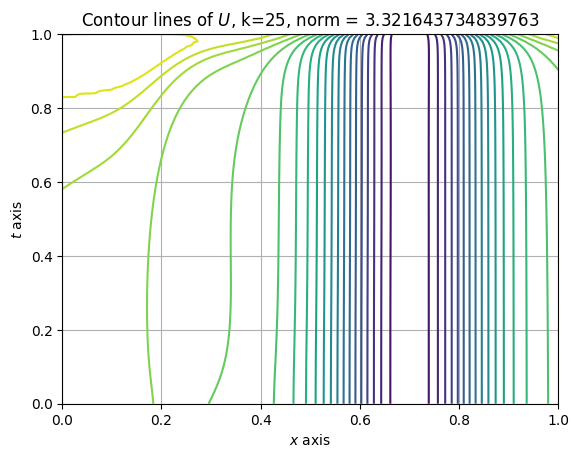

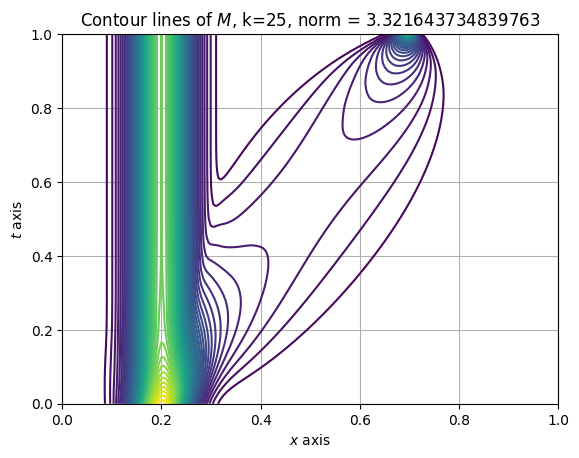

[Fixed Point] Iteration 25, previous norm: 3.321643734839763, theta: 0.01, elapsed time: 13.219933032989502
[Fixed Point] Iteration 26, previous norm: 3.2796931031212204, theta: 0.01, elapsed time: 13.661522388458252
[Fixed Point] Iteration 27, previous norm: 3.238426168156051, theta: 0.01, elapsed time: 15.057018041610718
[Fixed Point] Iteration 28, previous norm: 3.1978071491175237, theta: 0.01, elapsed time: 16.064032554626465
[Fixed Point] Iteration 29, previous norm: 3.1578296261110577, theta: 0.01, elapsed time: 16.987953662872314
[Fixed Point] Iteration 30, previous norm: 3.118471528073175, theta: 0.01, elapsed time: 17.42249083518982
[Fixed Point] Iteration 31, previous norm: 3.0797059086784198, theta: 0.01, elapsed time: 17.85270857810974
[Fixed Point] Iteration 32, previous norm: 3.0415219271589655, theta: 0.01, elapsed time: 18.31165099143982
[Fixed Point] Iteration 33, previous norm: 3.0038937834848154, theta: 0.01, elapsed time: 18.728387117385864
[Fixed Point] Iteration 3

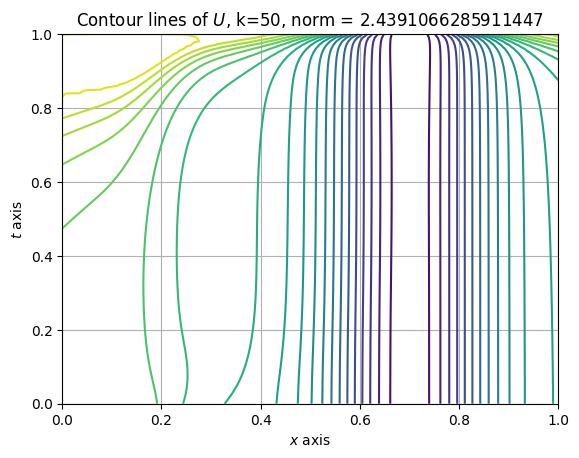

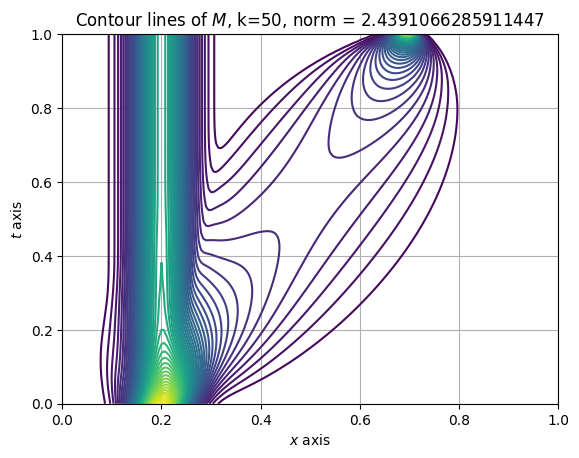

[Fixed Point] Iteration 50, previous norm: 2.4391066285911447, theta: 0.01, elapsed time: 26.72536563873291
[Fixed Point] Iteration 51, previous norm: 2.4097701229529433, theta: 0.01, elapsed time: 28.290282249450684
[Fixed Point] Iteration 52, previous norm: 2.3808164612804164, theta: 0.01, elapsed time: 29.634695291519165
[Fixed Point] Iteration 53, previous norm: 2.352238508979567, theta: 0.01, elapsed time: 30.415534257888794
[Fixed Point] Iteration 54, previous norm: 2.3240266242946874, theta: 0.01, elapsed time: 30.876847505569458
[Fixed Point] Iteration 55, previous norm: 2.296185077245984, theta: 0.01, elapsed time: 31.307759284973145
[Fixed Point] Iteration 56, previous norm: 2.268707988919245, theta: 0.01, elapsed time: 31.77717924118042
[Fixed Point] Iteration 57, previous norm: 2.241587332463245, theta: 0.01, elapsed time: 32.27523922920227
[Fixed Point] Iteration 58, previous norm: 2.214816242611364, theta: 0.01, elapsed time: 32.740973472595215
[Fixed Point] Iteration 59,

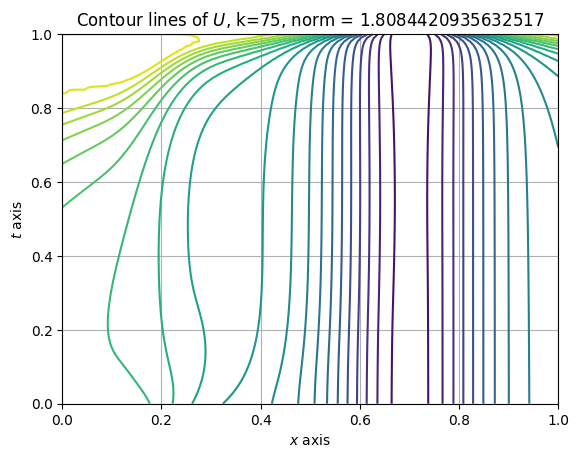

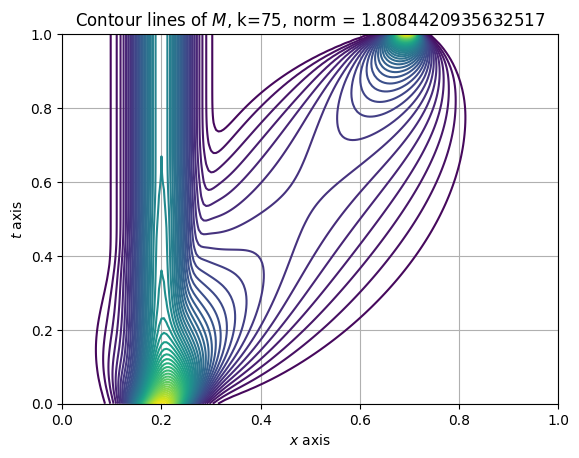

[Fixed Point] Iteration 75, previous norm: 1.8084420935632517, theta: 0.01, elapsed time: 40.93781590461731
[Fixed Point] Iteration 76, previous norm: 1.7871518206320918, theta: 0.01, elapsed time: 42.38028836250305
[Fixed Point] Iteration 77, previous norm: 1.7661259852584545, theta: 0.01, elapsed time: 43.425331354141235
[Fixed Point] Iteration 78, previous norm: 1.7453612020121805, theta: 0.01, elapsed time: 43.86875510215759
[Fixed Point] Iteration 79, previous norm: 1.7248535550072288, theta: 0.01, elapsed time: 44.27998733520508
[Fixed Point] Iteration 80, previous norm: 1.7045990580778623, theta: 0.01, elapsed time: 44.739837884902954
[Fixed Point] Iteration 81, previous norm: 1.6845950072039613, theta: 0.01, elapsed time: 45.1484956741333
[Fixed Point] Iteration 82, previous norm: 1.6648389357811038, theta: 0.01, elapsed time: 45.61129808425903
[Fixed Point] Iteration 83, previous norm: 1.6453277706235887, theta: 0.01, elapsed time: 46.026098012924194
[Fixed Point] Iteration 84

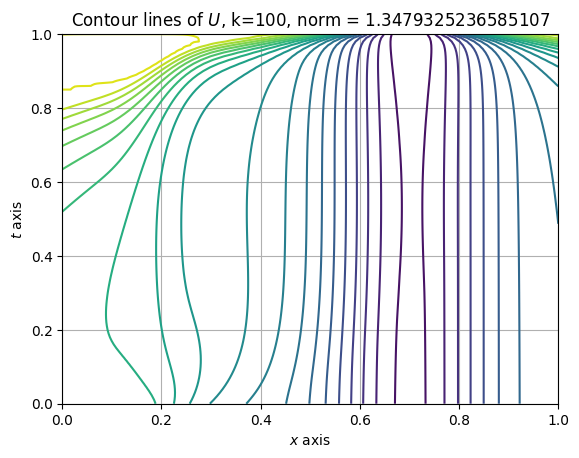

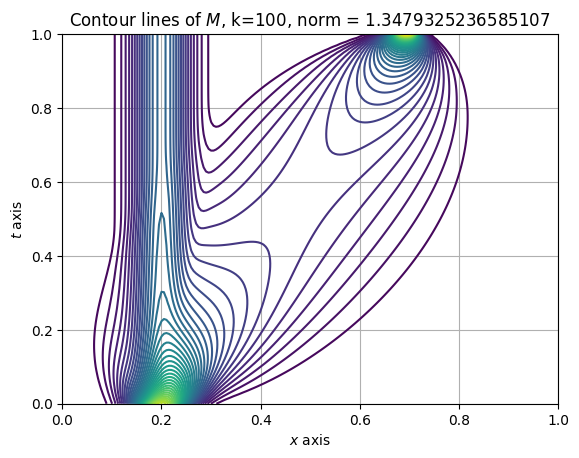

[Fixed Point] Iteration 100, previous norm: 1.3479325236585107, theta: 0.01, elapsed time: 55.343913555145264
[Fixed Point] Iteration 101, previous norm: 1.3322919550689396, theta: 0.01, elapsed time: 56.62125372886658
[Fixed Point] Iteration 102, previous norm: 1.316840816661489, theta: 0.01, elapsed time: 57.076276779174805
[Fixed Point] Iteration 103, previous norm: 1.3015765038814642, theta: 0.01, elapsed time: 57.511765241622925
[Fixed Point] Iteration 104, previous norm: 1.286496675615972, theta: 0.01, elapsed time: 57.983091831207275
[Fixed Point] Iteration 105, previous norm: 1.2715989606432736, theta: 0.01, elapsed time: 58.3939049243927
[Fixed Point] Iteration 106, previous norm: 1.2568809859328054, theta: 0.01, elapsed time: 58.84199595451355
[Fixed Point] Iteration 107, previous norm: 1.2423404561425904, theta: 0.01, elapsed time: 59.29301142692566
[Fixed Point] Iteration 108, previous norm: 1.2279750566118535, theta: 0.01, elapsed time: 59.72470808029175
[Fixed Point] Iter

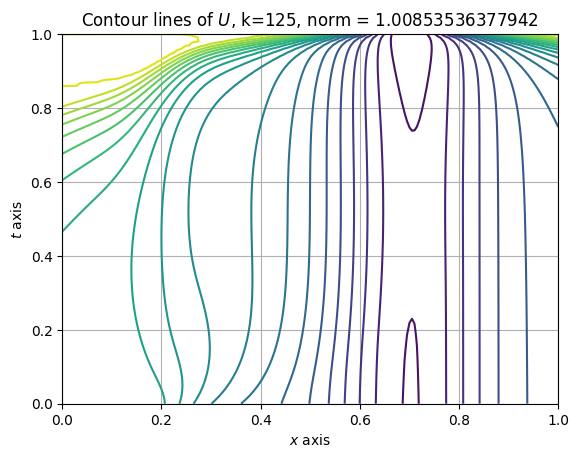

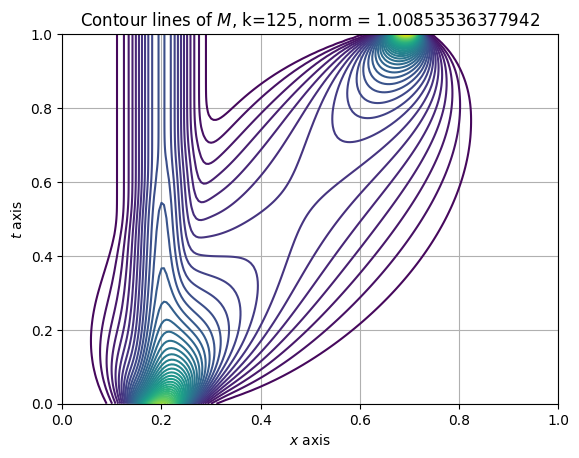

[Fixed Point] Iteration 125, previous norm: 1.00853536377942, theta: 0.01, elapsed time: 69.07838940620422
[Fixed Point] Iteration 126, previous norm: 0.9969724073982305, theta: 0.01, elapsed time: 70.11586880683899
[Fixed Point] Iteration 127, previous norm: 0.9855472697917633, theta: 0.01, elapsed time: 70.56284523010254
[Fixed Point] Iteration 128, previous norm: 0.9742583529181416, theta: 0.01, elapsed time: 70.9892258644104
[Fixed Point] Iteration 129, previous norm: 0.9631038926308857, theta: 0.01, elapsed time: 71.40022540092468
[Fixed Point] Iteration 130, previous norm: 0.95208228283253, theta: 0.01, elapsed time: 71.86032629013062
[Fixed Point] Iteration 131, previous norm: 0.9411919059075045, theta: 0.01, elapsed time: 72.27311134338379
[Fixed Point] Iteration 132, previous norm: 0.9304311166050762, theta: 0.01, elapsed time: 72.75300908088684
[Fixed Point] Iteration 133, previous norm: 0.9197983642228112, theta: 0.01, elapsed time: 73.18186926841736
[Fixed Point] Iteration 

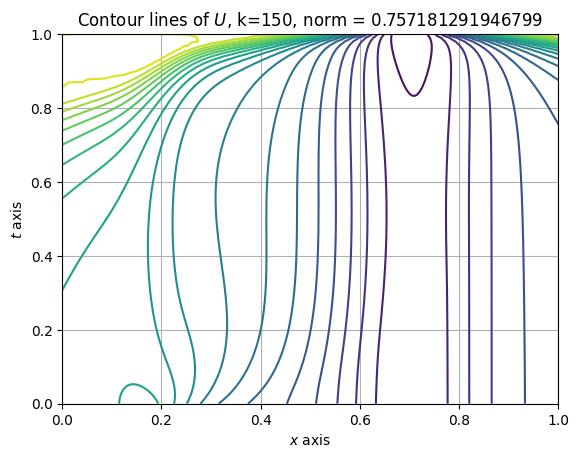

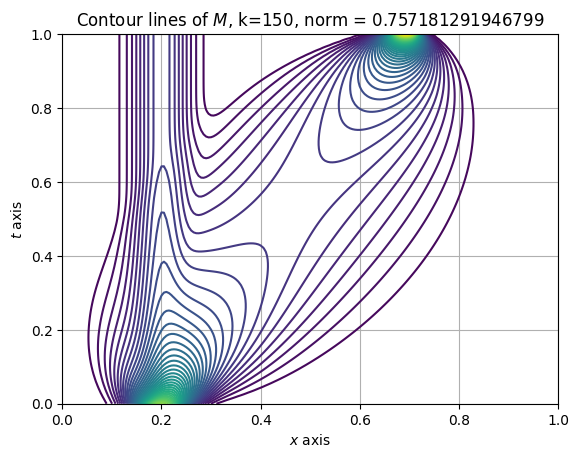

[Fixed Point] Iteration 150, previous norm: 0.757181291946799, theta: 0.01, elapsed time: 82.95375967025757
[Fixed Point] Iteration 151, previous norm: 0.7486025156759929, theta: 0.01, elapsed time: 83.64279580116272
[Fixed Point] Iteration 152, previous norm: 0.7401250795353108, theta: 0.01, elapsed time: 84.11246752738953
[Fixed Point] Iteration 153, previous norm: 0.7317477651671631, theta: 0.01, elapsed time: 84.53935408592224
[Fixed Point] Iteration 154, previous norm: 0.7234693386865512, theta: 0.01, elapsed time: 84.98573565483093
[Fixed Point] Iteration 155, previous norm: 0.7152885643346288, theta: 0.01, elapsed time: 85.43999409675598
[Fixed Point] Iteration 156, previous norm: 0.7072043093569678, theta: 0.01, elapsed time: 85.88459825515747
[Fixed Point] Iteration 157, previous norm: 0.6992153968961888, theta: 0.01, elapsed time: 86.33048129081726
[Fixed Point] Iteration 158, previous norm: 0.6913206536362317, theta: 0.01, elapsed time: 86.81722235679626
[Fixed Point] Iterat

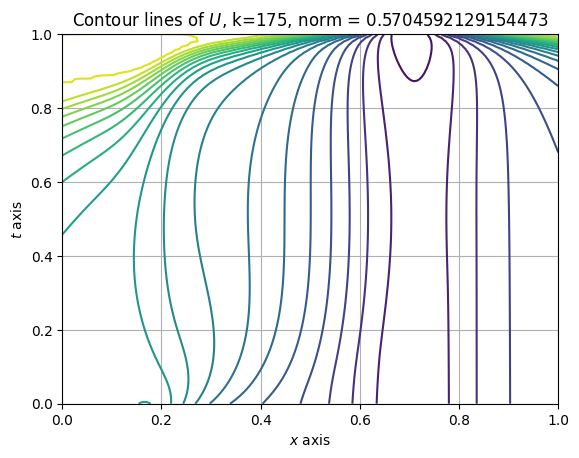

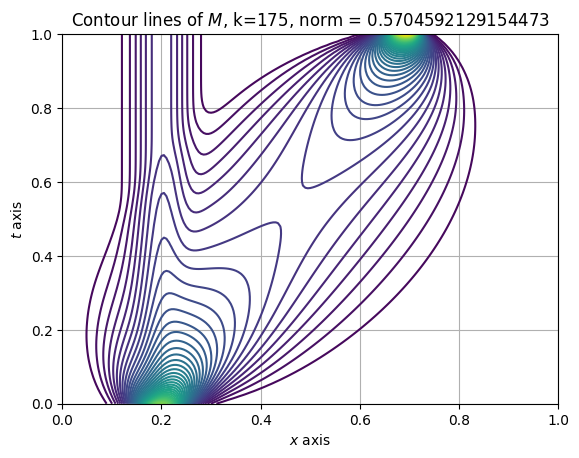

[Fixed Point] Iteration 175, previous norm: 0.5704592129154473, theta: 0.01, elapsed time: 97.1096556186676
[Fixed Point] Iteration 176, previous norm: 0.564076483338376, theta: 0.01, elapsed time: 97.7002363204956
[Fixed Point] Iteration 177, previous norm: 0.5577684130984695, theta: 0.01, elapsed time: 99.48220610618591
[Fixed Point] Iteration 178, previous norm: 0.551534060040815, theta: 0.01, elapsed time: 100.57792496681213
[Fixed Point] Iteration 179, previous norm: 0.545372571908639, theta: 0.01, elapsed time: 101.19282364845276
[Fixed Point] Iteration 180, previous norm: 0.539283068436792, theta: 0.01, elapsed time: 101.62614393234253
[Fixed Point] Iteration 181, previous norm: 0.5332646716486384, theta: 0.01, elapsed time: 102.08550977706909
[Fixed Point] Iteration 182, previous norm: 0.5273165226904432, theta: 0.01, elapsed time: 102.49956321716309
[Fixed Point] Iteration 183, previous norm: 0.521437742531386, theta: 0.01, elapsed time: 102.94928002357483
[Fixed Point] Iterat

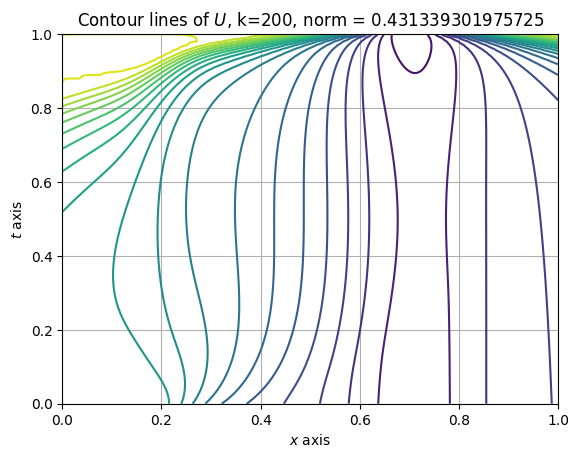

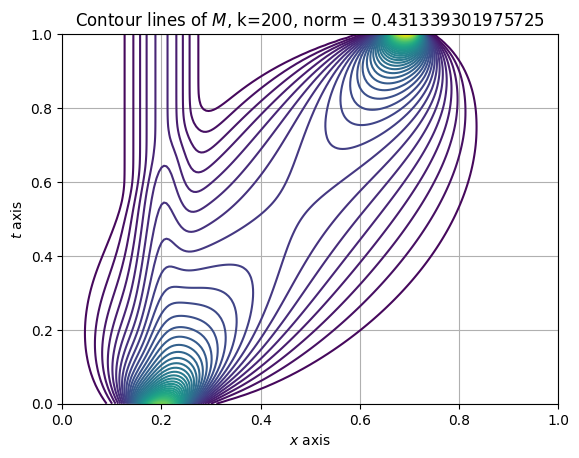

[Fixed Point] Iteration 200, previous norm: 0.431339301975725, theta: 0.01, elapsed time: 114.95292043685913
[Fixed Point] Iteration 201, previous norm: 0.426575315970191, theta: 0.01, elapsed time: 115.45784139633179
[Fixed Point] Iteration 202, previous norm: 0.4218663787447489, theta: 0.01, elapsed time: 115.94344735145569
[Fixed Point] Iteration 203, previous norm: 0.41721185188923415, theta: 0.01, elapsed time: 116.37920022010803
[Fixed Point] Iteration 204, previous norm: 0.41261108256743523, theta: 0.01, elapsed time: 116.89954853057861
[Fixed Point] Iteration 205, previous norm: 0.40806342277993124, theta: 0.01, elapsed time: 117.33439135551453
[Fixed Point] Iteration 206, previous norm: 0.4035682207084318, theta: 0.01, elapsed time: 117.81807780265808
[Fixed Point] Iteration 207, previous norm: 0.3991248414647465, theta: 0.01, elapsed time: 118.26986885070801
[Fixed Point] Iteration 208, previous norm: 0.3947326789397468, theta: 0.01, elapsed time: 118.72403359413147
[Fixed Po

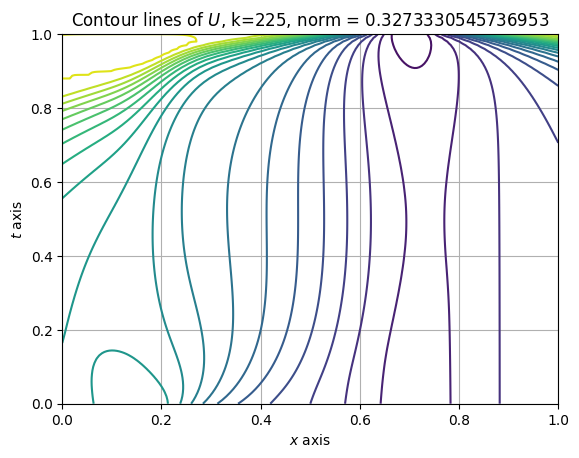

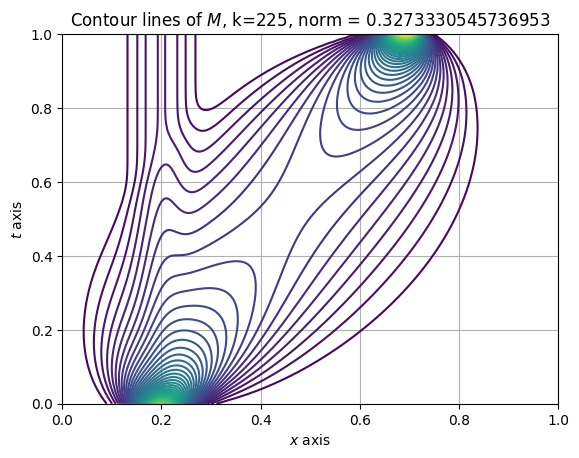

[Fixed Point] Iteration 225, previous norm: 0.3273330545736953, theta: 0.01, elapsed time: 128.85966062545776
[Fixed Point] Iteration 226, previous norm: 0.3237644148587402, theta: 0.01, elapsed time: 129.37842464447021
[Fixed Point] Iteration 227, previous norm: 0.32023649314244934, theta: 0.01, elapsed time: 129.81973028182983
[Fixed Point] Iteration 228, previous norm: 0.31674880773775765, theta: 0.01, elapsed time: 130.2983500957489
[Fixed Point] Iteration 229, previous norm: 0.31330086926526046, theta: 0.01, elapsed time: 130.72313976287842
[Fixed Point] Iteration 230, previous norm: 0.30989220873146334, theta: 0.01, elapsed time: 131.16472101211548
[Fixed Point] Iteration 231, previous norm: 0.30652236587017634, theta: 0.01, elapsed time: 131.63471460342407
[Fixed Point] Iteration 232, previous norm: 0.3031908766622231, theta: 0.01, elapsed time: 132.085515499115
[Fixed Point] Iteration 233, previous norm: 0.2998972686272354, theta: 0.01, elapsed time: 132.55067825317383
[Fixed P

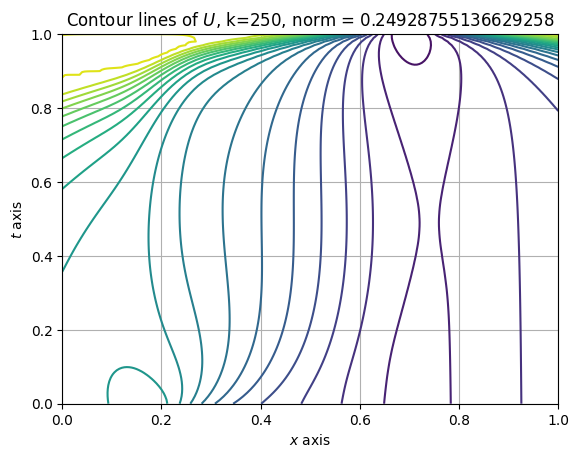

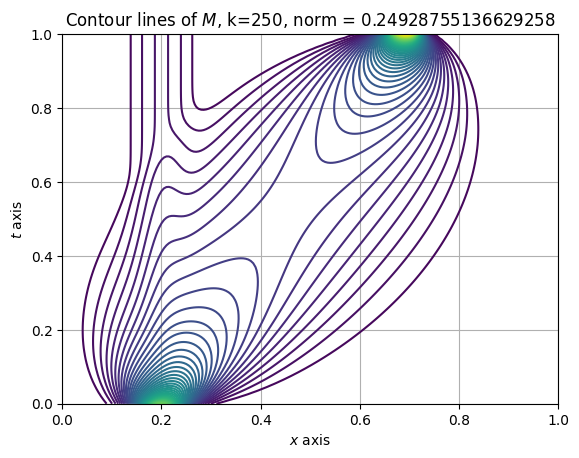

[Fixed Point] Iteration 250, previous norm: 0.24928755136629258, theta: 0.01, elapsed time: 142.68679189682007
[Fixed Point] Iteration 251, previous norm: 0.24660407403560425, theta: 0.01, elapsed time: 143.25981521606445
[Fixed Point] Iteration 252, previous norm: 0.2439508181425118, theta: 0.01, elapsed time: 143.76533389091492
[Fixed Point] Iteration 253, previous norm: 0.24132742746337935, theta: 0.01, elapsed time: 144.22878193855286
[Fixed Point] Iteration 254, previous norm: 0.23873354875085676, theta: 0.01, elapsed time: 144.689688205719
[Fixed Point] Iteration 255, previous norm: 0.23616883587922785, theta: 0.01, elapsed time: 145.18285655975342
[Fixed Point] Iteration 256, previous norm: 0.2336329452308862, theta: 0.01, elapsed time: 145.64197444915771
[Fixed Point] Iteration 257, previous norm: 0.23112553689607512, theta: 0.01, elapsed time: 146.14452362060547
[Fixed Point] Iteration 258, previous norm: 0.2286462676164889, theta: 0.01, elapsed time: 146.60604166984558
[Fixed

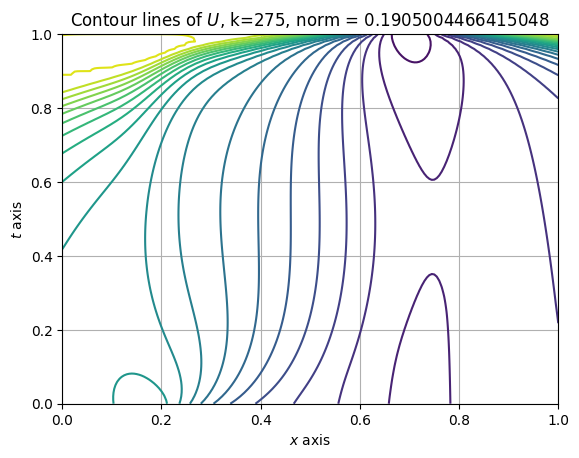

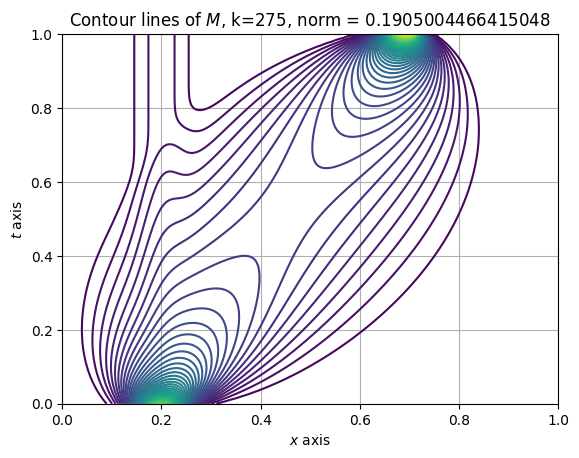

[Fixed Point] Iteration 275, previous norm: 0.1905004466415048, theta: 0.01, elapsed time: 157.39332389831543
[Fixed Point] Iteration 276, previous norm: 0.18847509374496577, theta: 0.01, elapsed time: 157.9749150276184
[Fixed Point] Iteration 277, previous norm: 0.18647226022862265, theta: 0.01, elapsed time: 158.51688885688782
[Fixed Point] Iteration 278, previous norm: 0.18449168400124727, theta: 0.01, elapsed time: 159.0288164615631
[Fixed Point] Iteration 279, previous norm: 0.18253309833723153, theta: 0.01, elapsed time: 159.557776927948
[Fixed Point] Iteration 280, previous norm: 0.18059625740295696, theta: 0.01, elapsed time: 160.054527759552
[Fixed Point] Iteration 281, previous norm: 0.17868090916211316, theta: 0.01, elapsed time: 160.58694410324097
[Fixed Point] Iteration 282, previous norm: 0.17678680482136203, theta: 0.01, elapsed time: 161.07809972763062
[Fixed Point] Iteration 283, previous norm: 0.17491369839377888, theta: 0.01, elapsed time: 161.7247498035431
[Fixed Po

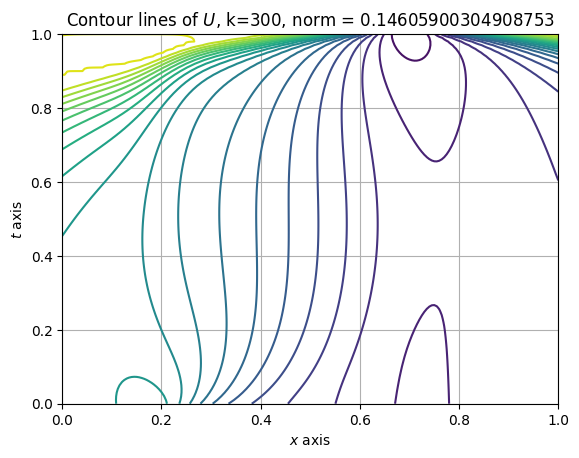

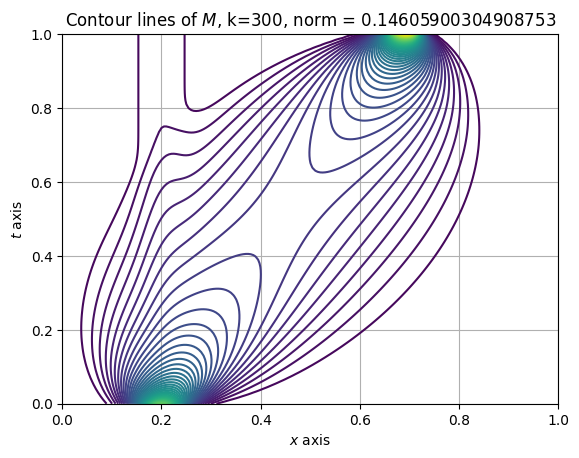

[Fixed Point] Iteration 300, previous norm: 0.14605900304908753, theta: 0.01, elapsed time: 172.61941123008728
[Fixed Point] Iteration 301, previous norm: 0.14452502906587764, theta: 0.01, elapsed time: 173.24096417427063
[Fixed Point] Iteration 302, previous norm: 0.14300790845662403, theta: 0.01, elapsed time: 173.73646068572998
[Fixed Point] Iteration 303, previous norm: 0.14150744750149516, theta: 0.01, elapsed time: 174.22272610664368
[Fixed Point] Iteration 304, previous norm: 0.14002345676150318, theta: 0.01, elapsed time: 174.73875045776367
[Fixed Point] Iteration 305, previous norm: 0.13855574389971595, theta: 0.01, elapsed time: 176.30650544166565
[Fixed Point] Iteration 306, previous norm: 0.13710412391515037, theta: 0.01, elapsed time: 177.39773392677307
[Fixed Point] Iteration 307, previous norm: 0.13566841680006808, theta: 0.01, elapsed time: 178.29618740081787
[Fixed Point] Iteration 308, previous norm: 0.13424844092188007, theta: 0.01, elapsed time: 178.7844042778015
[F

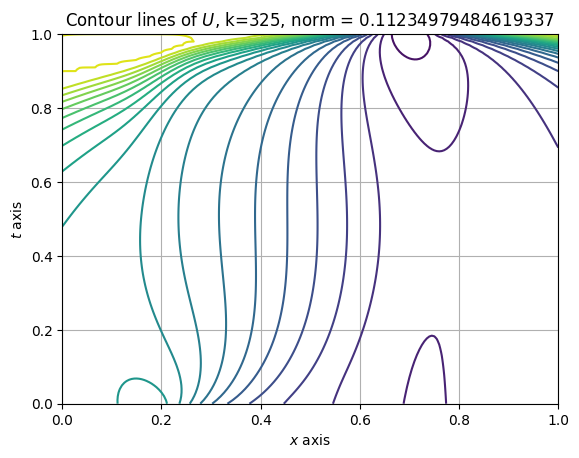

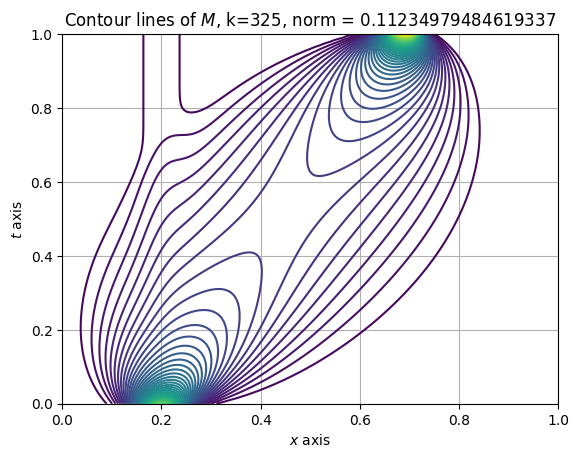

[Fixed Point] Iteration 325, previous norm: 0.11234979484619337, theta: 0.01, elapsed time: 187.54301166534424
[Fixed Point] Iteration 326, previous norm: 0.11118426747418052, theta: 0.01, elapsed time: 188.25948190689087
[Fixed Point] Iteration 327, previous norm: 0.11003140418670151, theta: 0.01, elapsed time: 189.95284605026245
[Fixed Point] Iteration 328, previous norm: 0.10889106220523133, theta: 0.01, elapsed time: 191.31772708892822
[Fixed Point] Iteration 329, previous norm: 0.1077631001987831, theta: 0.01, elapsed time: 191.79997444152832
[Fixed Point] Iteration 330, previous norm: 0.10664737850085296, theta: 0.01, elapsed time: 192.31856155395508
[Fixed Point] Iteration 331, previous norm: 0.10554375888209168, theta: 0.01, elapsed time: 192.82468461990356
[Fixed Point] Iteration 332, previous norm: 0.10445210509938019, theta: 0.01, elapsed time: 193.35418272018433
[Fixed Point] Iteration 333, previous norm: 0.10337228240208232, theta: 0.01, elapsed time: 193.85456347465515
[F

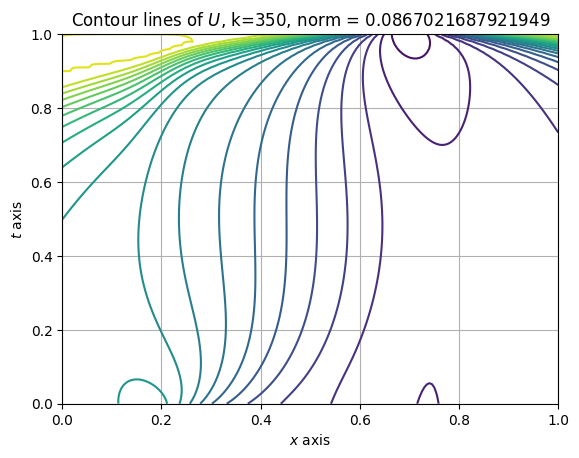

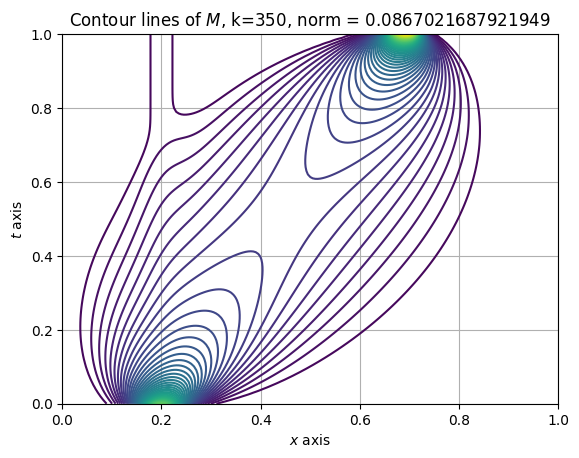

[Fixed Point] Iteration 350, previous norm: 0.0867021687921949, theta: 0.01, elapsed time: 204.6041133403778
[Fixed Point] Iteration 351, previous norm: 0.08581396658900636, theta: 0.01, elapsed time: 205.1486976146698
[Fixed Point] Iteration 352, previous norm: 0.08493531371122642, theta: 0.01, elapsed time: 205.67614603042603
[Fixed Point] Iteration 353, previous norm: 0.08406610214182884, theta: 0.01, elapsed time: 206.15961694717407
[Fixed Point] Iteration 354, previous norm: 0.08320622814209351, theta: 0.01, elapsed time: 206.66832423210144
[Fixed Point] Iteration 355, previous norm: 0.08235558785329605, theta: 0.01, elapsed time: 207.18413472175598
[Fixed Point] Iteration 356, previous norm: 0.08151407833110509, theta: 0.01, elapsed time: 207.69244813919067
[Fixed Point] Iteration 357, previous norm: 0.08068159781494462, theta: 0.01, elapsed time: 208.17761635780334
[Fixed Point] Iteration 358, previous norm: 0.07985804572049039, theta: 0.01, elapsed time: 208.68602967262268
[Fix

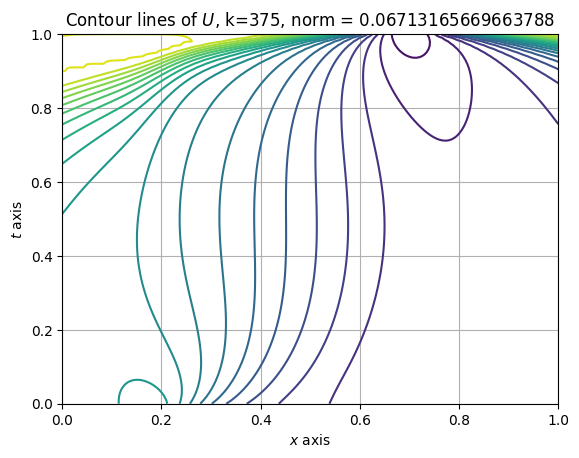

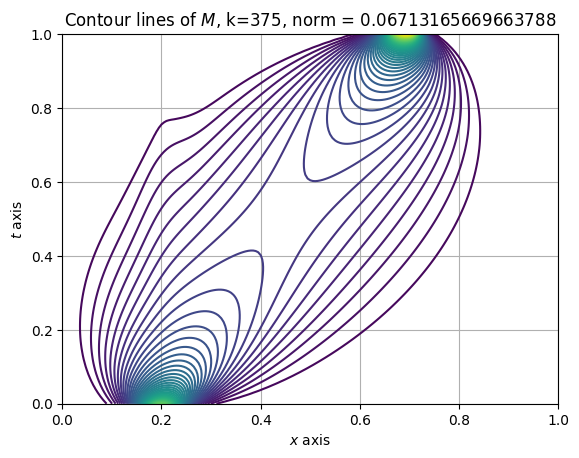

[Fixed Point] Iteration 375, previous norm: 0.06713165669663788, theta: 0.01, elapsed time: 219.89127445220947
[Fixed Point] Iteration 376, previous norm: 0.06645287365477143, theta: 0.01, elapsed time: 220.49910807609558
[Fixed Point] Iteration 377, previous norm: 0.06578131351207454, theta: 0.01, elapsed time: 221.01197981834412
[Fixed Point] Iteration 378, previous norm: 0.06511689642639107, theta: 0.01, elapsed time: 221.5064034461975
[Fixed Point] Iteration 379, previous norm: 0.0644595434671775, theta: 0.01, elapsed time: 221.9969127178192
[Fixed Point] Iteration 380, previous norm: 0.06380917660455734, theta: 0.01, elapsed time: 222.50746297836304
[Fixed Point] Iteration 381, previous norm: 0.06316571869854326, theta: 0.01, elapsed time: 222.99744820594788
[Fixed Point] Iteration 382, previous norm: 0.06252909324962268, theta: 0.01, elapsed time: 223.50875282287598
[Fixed Point] Iteration 383, previous norm: 0.06189922500880574, theta: 0.01, elapsed time: 223.9651539325714
[Fixe

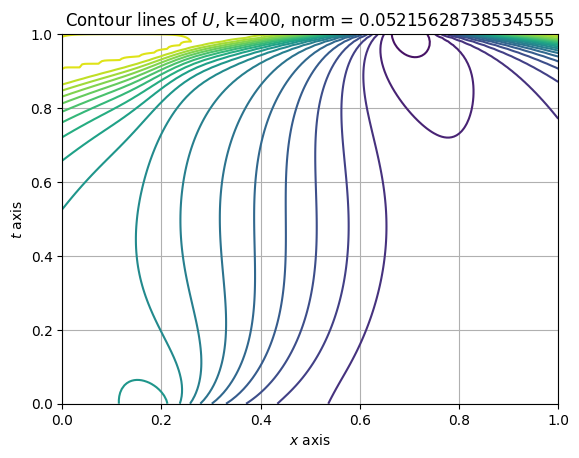

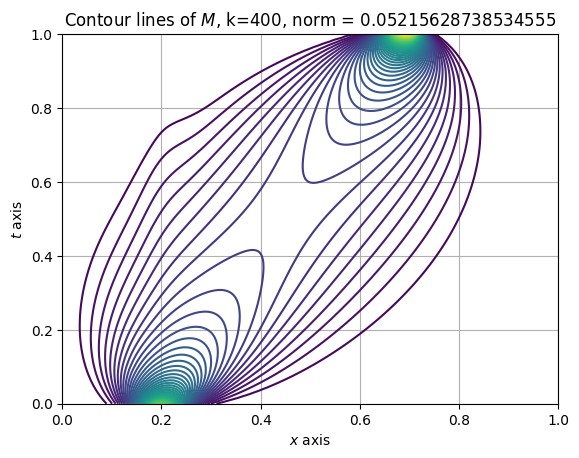

[Fixed Point] Iteration 400, previous norm: 0.05215628738534555, theta: 0.01, elapsed time: 234.776508808136
[Fixed Point] Iteration 401, previous norm: 0.05163608995160117, theta: 0.01, elapsed time: 235.37697911262512
[Fixed Point] Iteration 402, previous norm: 0.051121369418693864, theta: 0.01, elapsed time: 235.88826179504395
[Fixed Point] Iteration 403, previous norm: 0.05061206575878693, theta: 0.01, elapsed time: 236.36432099342346
[Fixed Point] Iteration 404, previous norm: 0.05010811962088653, theta: 0.01, elapsed time: 236.90797233581543
[Fixed Point] Iteration 405, previous norm: 0.049609472322903254, theta: 0.01, elapsed time: 237.4236741065979
[Fixed Point] Iteration 406, previous norm: 0.04911606584383138, theta: 0.01, elapsed time: 237.9309298992157
[Fixed Point] Iteration 407, previous norm: 0.04862784275693194, theta: 0.01, elapsed time: 238.42287039756775
[Fixed Point] Iteration 408, previous norm: 0.04814474626588986, theta: 0.01, elapsed time: 238.94542789459229
[Fi

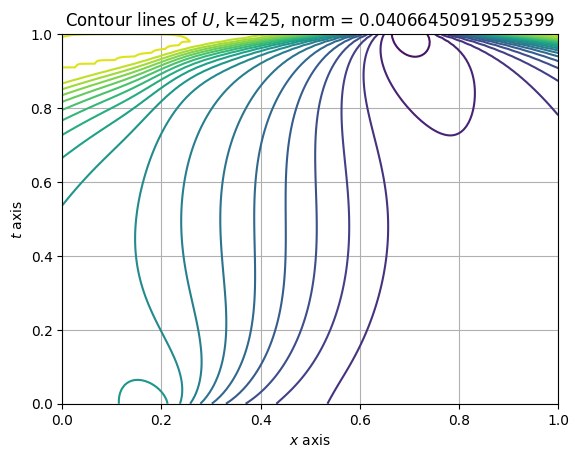

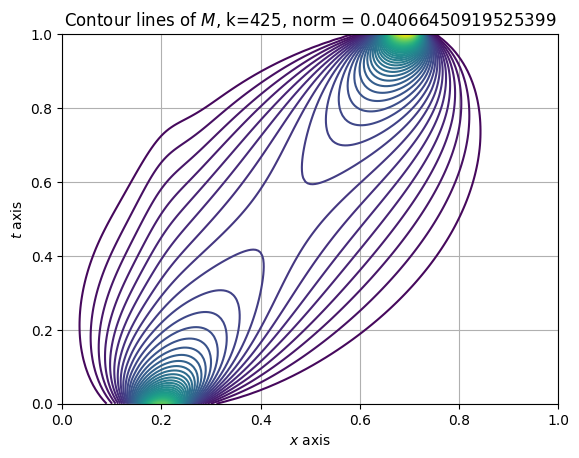

[Fixed Point] Iteration 425, previous norm: 0.04066450919525399, theta: 0.01, elapsed time: 249.94947123527527
[Fixed Point] Iteration 426, previous norm: 0.0402646872358009, theta: 0.01, elapsed time: 250.57743167877197
[Fixed Point] Iteration 427, previous norm: 0.03986902755217685, theta: 0.01, elapsed time: 251.0377595424652
[Fixed Point] Iteration 428, previous norm: 0.03947748481551683, theta: 0.01, elapsed time: 251.51856994628906
[Fixed Point] Iteration 429, previous norm: 0.03909001425099896, theta: 0.01, elapsed time: 251.9952518939972
[Fixed Point] Iteration 430, previous norm: 0.03870657159243653, theta: 0.01, elapsed time: 252.51222801208496
[Fixed Point] Iteration 431, previous norm: 0.038327113067159684, theta: 0.01, elapsed time: 252.96478152275085
[Fixed Point] Iteration 432, previous norm: 0.03795159539045508, theta: 0.01, elapsed time: 253.43917965888977
[Fixed Point] Iteration 433, previous norm: 0.037579975760053015, theta: 0.01, elapsed time: 253.928936958313
[Fix

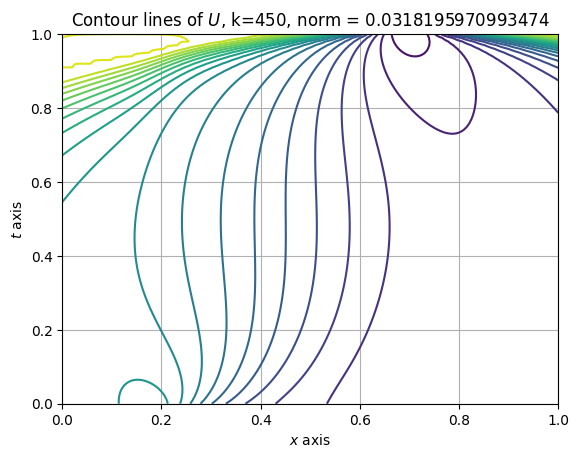

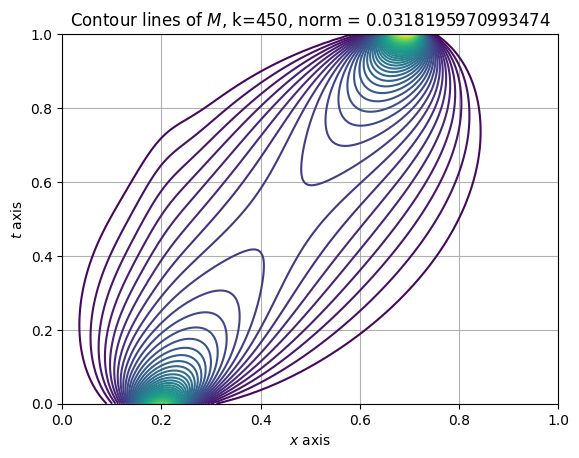

[Fixed Point] Iteration 450, previous norm: 0.0318195970993474, theta: 0.01, elapsed time: 264.8384573459625
[Fixed Point] Iteration 451, previous norm: 0.03151134156193832, theta: 0.01, elapsed time: 265.4897027015686
[Fixed Point] Iteration 452, previous norm: 0.03120625556638102, theta: 0.01, elapsed time: 265.978946685791
[Fixed Point] Iteration 453, previous norm: 0.03090430488761717, theta: 0.01, elapsed time: 266.4997808933258
[Fixed Point] Iteration 454, previous norm: 0.03060545568020706, theta: 0.01, elapsed time: 266.9991912841797
[Fixed Point] Iteration 455, previous norm: 0.030309674474049454, theta: 0.01, elapsed time: 267.54199266433716
[Fixed Point] Iteration 456, previous norm: 0.03001692817013229, theta: 0.01, elapsed time: 268.16452741622925
[Fixed Point] Iteration 457, previous norm: 0.029727184036350156, theta: 0.01, elapsed time: 269.82528734207153
[Fixed Point] Iteration 458, previous norm: 0.02944040970335495, theta: 0.01, elapsed time: 271.16301250457764
[Fixed

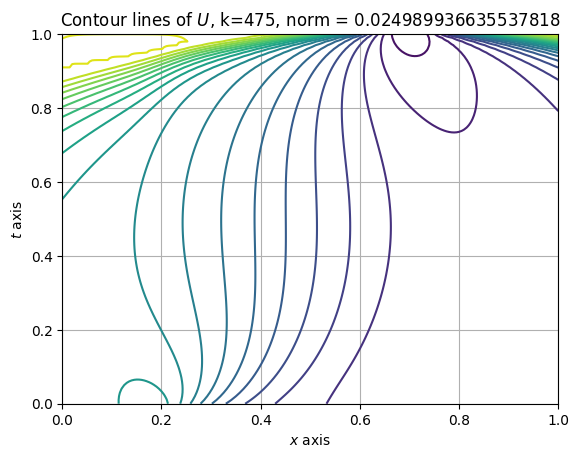

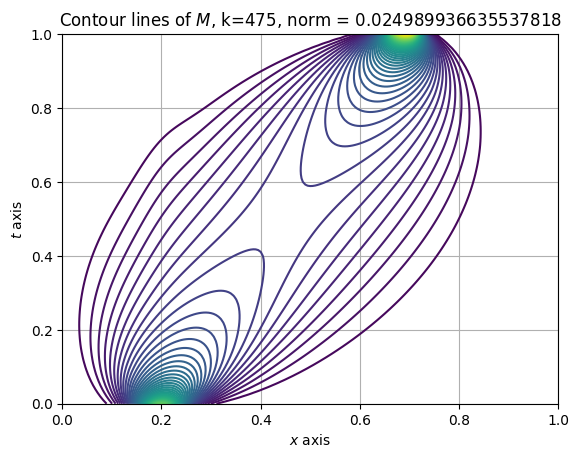

[Fixed Point] Iteration 475, previous norm: 0.024989936635537818, theta: 0.01, elapsed time: 280.19769310951233
[Fixed Point] Iteration 476, previous norm: 0.024751473578705323, theta: 0.01, elapsed time: 280.8602225780487
[Fixed Point] Iteration 477, previous norm: 0.024515429065032016, theta: 0.01, elapsed time: 281.7228407859802
[Fixed Point] Iteration 478, previous norm: 0.024281777182156853, theta: 0.01, elapsed time: 283.14873147010803
[Fixed Point] Iteration 479, previous norm: 0.024050492303877607, theta: 0.01, elapsed time: 284.44038581848145
[Fixed Point] Iteration 480, previous norm: 0.02382154908696786, theta: 0.01, elapsed time: 285.0455446243286
[Fixed Point] Iteration 481, previous norm: 0.02359492246803278, theta: 0.01, elapsed time: 285.5349614620209
[Fixed Point] Iteration 482, previous norm: 0.02337058766038137, theta: 0.01, elapsed time: 286.07073163986206
[Fixed Point] Iteration 483, previous norm: 0.023148520150960635, theta: 0.01, elapsed time: 286.5745277404785


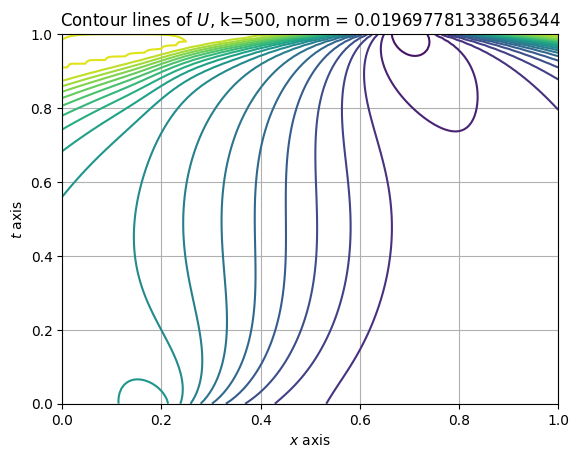

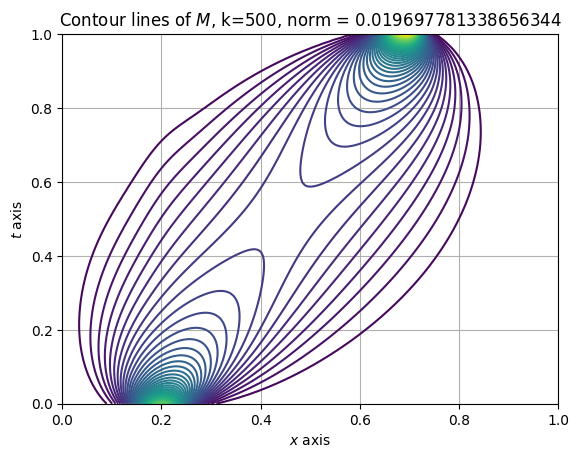

[Fixed Point] Iteration 500, previous norm: 0.019697781338656344, theta: 0.01, elapsed time: 296.95149064064026
[Fixed Point] Iteration 501, previous norm: 0.01951262779399781, theta: 0.01, elapsed time: 298.13896584510803
[Fixed Point] Iteration 502, previous norm: 0.019329323933534336, theta: 0.01, elapsed time: 298.693576335907
[Fixed Point] Iteration 503, previous norm: 0.019147850120307276, theta: 0.01, elapsed time: 299.19623708724976
[Fixed Point] Iteration 504, previous norm: 0.018968186933709212, theta: 0.01, elapsed time: 299.74340867996216
[Fixed Point] Iteration 505, previous norm: 0.018790315167087873, theta: 0.01, elapsed time: 300.2543909549713
[Fixed Point] Iteration 506, previous norm: 0.01861421582536841, theta: 0.01, elapsed time: 300.7936315536499
[Fixed Point] Iteration 507, previous norm: 0.01843987012269761, theta: 0.01, elapsed time: 301.3047697544098
[Fixed Point] Iteration 508, previous norm: 0.01826725948014315, theta: 0.01, elapsed time: 301.84272027015686
[

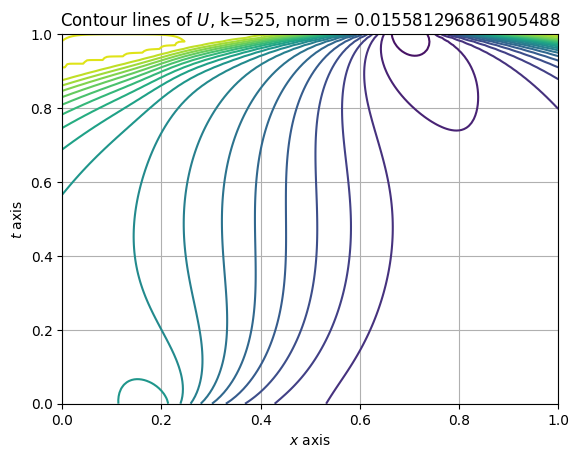

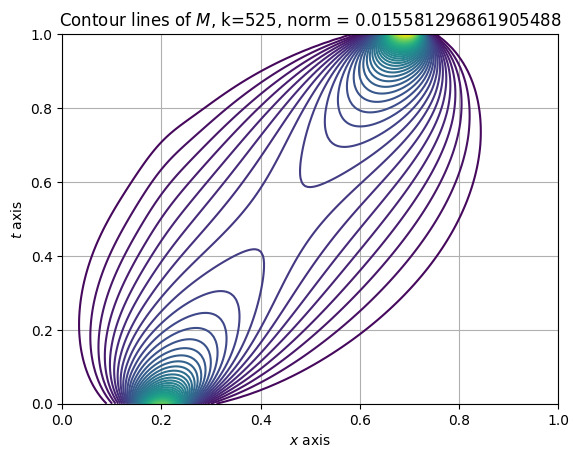

[Fixed Point] Iteration 525, previous norm: 0.015581296861905488, theta: 0.01, elapsed time: 312.7958996295929
[Fixed Point] Iteration 526, previous norm: 0.015436962941196496, theta: 0.01, elapsed time: 313.4997572898865
[Fixed Point] Iteration 527, previous norm: 0.015294047486997383, theta: 0.01, elapsed time: 314.01395535469055
[Fixed Point] Iteration 528, previous norm: 0.01515253560873295, theta: 0.01, elapsed time: 314.55095505714417
[Fixed Point] Iteration 529, previous norm: 0.01501241257952277, theta: 0.01, elapsed time: 315.0744755268097
[Fixed Point] Iteration 530, previous norm: 0.014873663834366892, theta: 0.01, elapsed time: 315.58508014678955
[Fixed Point] Iteration 531, previous norm: 0.014736274968344617, theta: 0.01, elapsed time: 316.1125855445862
[Fixed Point] Iteration 532, previous norm: 0.01460023173484348, theta: 0.01, elapsed time: 316.65280508995056
[Fixed Point] Iteration 533, previous norm: 0.014465520043798592, theta: 0.01, elapsed time: 317.14676427841187

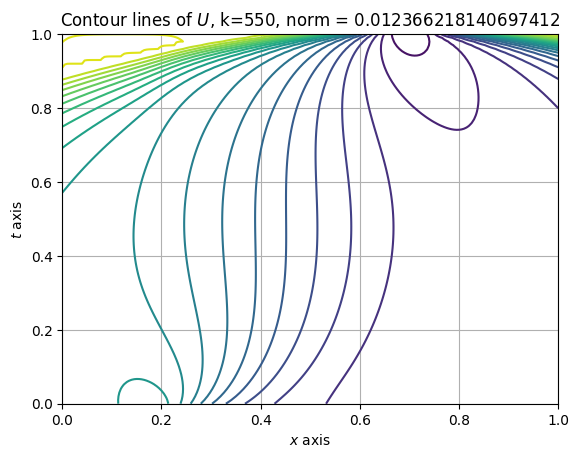

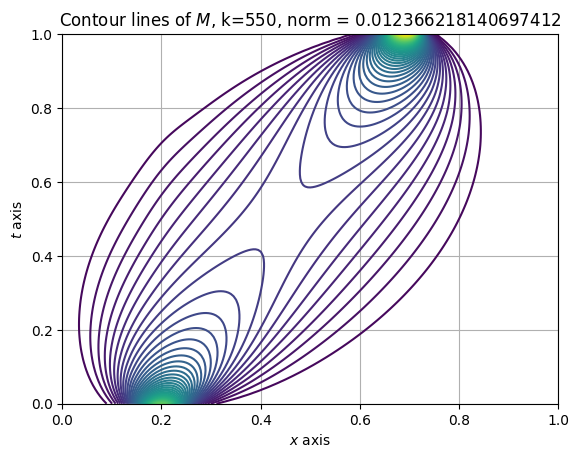

[Fixed Point] Iteration 550, previous norm: 0.012366218140697412, theta: 0.01, elapsed time: 328.2409288883209
[Fixed Point] Iteration 551, previous norm: 0.012253233252896628, theta: 0.01, elapsed time: 328.89054107666016
[Fixed Point] Iteration 552, previous norm: 0.01214133973889788, theta: 0.01, elapsed time: 329.4074559211731
[Fixed Point] Iteration 553, previous norm: 0.012030526298754264, theta: 0.01, elapsed time: 330.0098350048065
[Fixed Point] Iteration 554, previous norm: 0.011920781756300888, theta: 0.01, elapsed time: 330.5173907279968
[Fixed Point] Iteration 555, previous norm: 0.011812095057776743, theta: 0.01, elapsed time: 331.0909676551819
[Fixed Point] Iteration 556, previous norm: 0.011704455270462544, theta: 0.01, elapsed time: 332.46867203712463
[Fixed Point] Iteration 557, previous norm: 0.011597851581327985, theta: 0.01, elapsed time: 333.7269585132599
[Fixed Point] Iteration 558, previous norm: 0.01149227329569763, theta: 0.01, elapsed time: 334.60245275497437


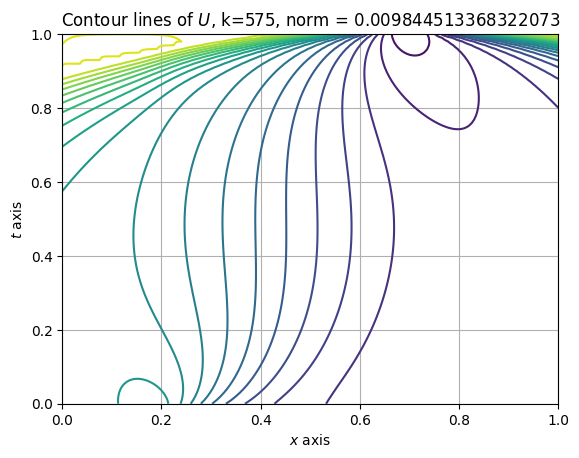

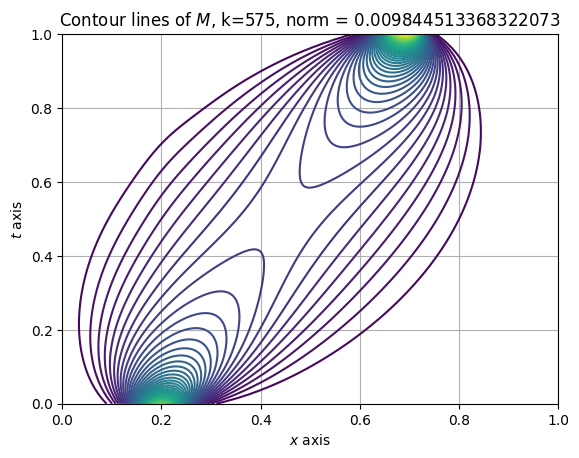

[Fixed Point] Iteration 575, previous norm: 0.009844513368322073, theta: 0.01, elapsed time: 347.98579001426697
[Fixed Point] Iteration 576, previous norm: 0.009755690865265827, theta: 0.01, elapsed time: 348.78657817840576
[Fixed Point] Iteration 577, previous norm: 0.009667711381747277, theta: 0.01, elapsed time: 350.4996898174286
[Fixed Point] Iteration 578, previous norm: 0.009580566331228706, theta: 0.01, elapsed time: 351.622670173645
[Fixed Point] Iteration 579, previous norm: 0.00949424722063378, theta: 0.01, elapsed time: 352.4049813747406
[Fixed Point] Iteration 580, previous norm: 0.009408745649300668, theta: 0.01, elapsed time: 352.9649701118469
[Fixed Point] Iteration 581, previous norm: 0.009324053307943682, theta: 0.01, elapsed time: 353.50492238998413
[Fixed Point] Iteration 582, previous norm: 0.00924016197762568, theta: 0.01, elapsed time: 354.03081035614014
[Fixed Point] Iteration 583, previous norm: 0.009157063528750457, theta: 0.01, elapsed time: 354.57809495925903

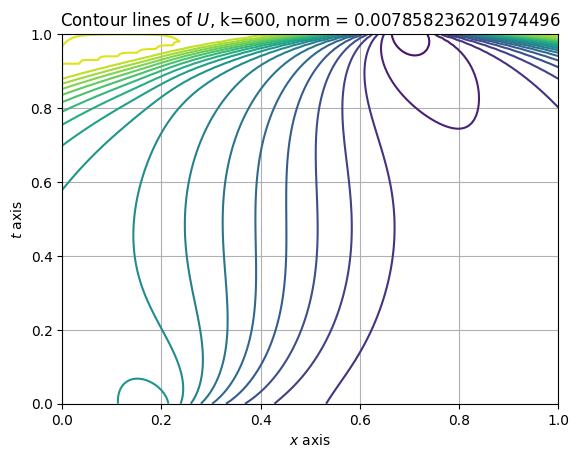

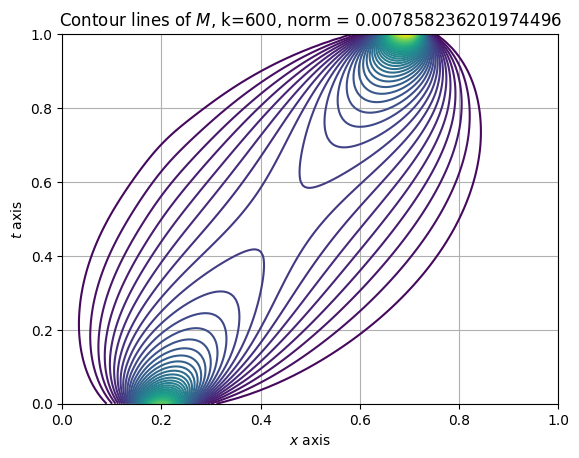

[Fixed Point] Iteration 600, previous norm: 0.007858236201974496, theta: 0.01, elapsed time: 365.4459068775177
[Fixed Point] Iteration 601, previous norm: 0.007788115520157823, theta: 0.01, elapsed time: 366.1145842075348
[Fixed Point] Iteration 602, previous norm: 0.007718648961737579, theta: 0.01, elapsed time: 366.6348533630371
[Fixed Point] Iteration 603, previous norm: 0.007649829987301426, theta: 0.01, elapsed time: 367.13840103149414
[Fixed Point] Iteration 604, previous norm: 0.0075816521278908545, theta: 0.01, elapsed time: 367.6350874900818
[Fixed Point] Iteration 605, previous norm: 0.007514108984196585, theta: 0.01, elapsed time: 368.1856472492218
[Fixed Point] Iteration 606, previous norm: 0.007447194225788016, theta: 0.01, elapsed time: 368.6615197658539
[Fixed Point] Iteration 607, previous norm: 0.007380901590323943, theta: 0.01, elapsed time: 369.2198143005371
[Fixed Point] Iteration 608, previous norm: 0.007315224882791034, theta: 0.01, elapsed time: 369.7122385501861

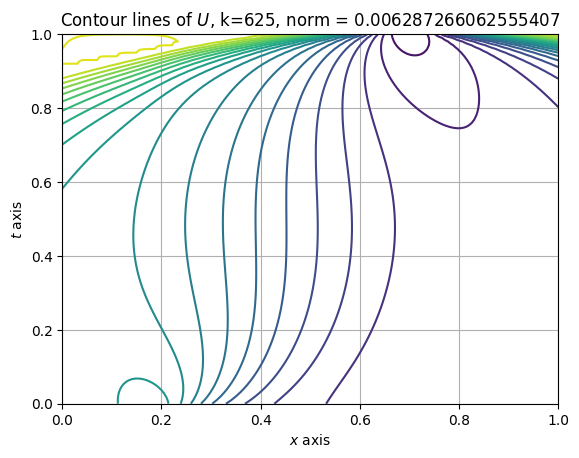

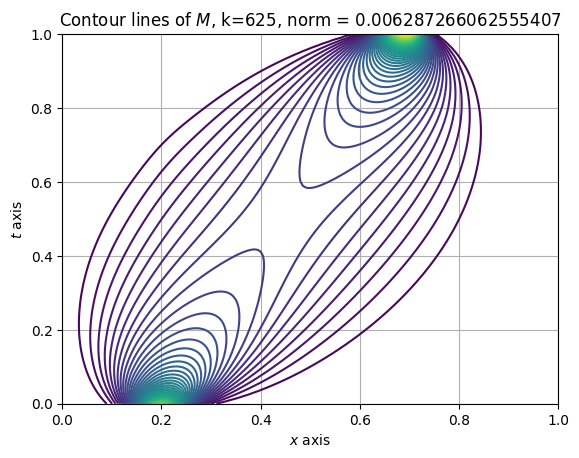

[Fixed Point] Iteration 625, previous norm: 0.006287266062555407, theta: 0.01, elapsed time: 380.99540066719055
[Fixed Point] Iteration 626, previous norm: 0.006231689087837655, theta: 0.01, elapsed time: 381.64444041252136
[Fixed Point] Iteration 627, previous norm: 0.006176622167295142, theta: 0.01, elapsed time: 382.1290774345398
[Fixed Point] Iteration 628, previous norm: 0.006122060303801407, theta: 0.01, elapsed time: 382.64757442474365
[Fixed Point] Iteration 629, previous norm: 0.0060679985532877696, theta: 0.01, elapsed time: 383.146701335907
[Fixed Point] Iteration 630, previous norm: 0.0060144320241353215, theta: 0.01, elapsed time: 383.6534869670868
[Fixed Point] Iteration 631, previous norm: 0.00596135587659057, theta: 0.01, elapsed time: 384.1752052307129
[Fixed Point] Iteration 632, previous norm: 0.005908765322176736, theta: 0.01, elapsed time: 384.7059397697449
[Fixed Point] Iteration 633, previous norm: 0.005856655623116407, theta: 0.01, elapsed time: 385.236722469329

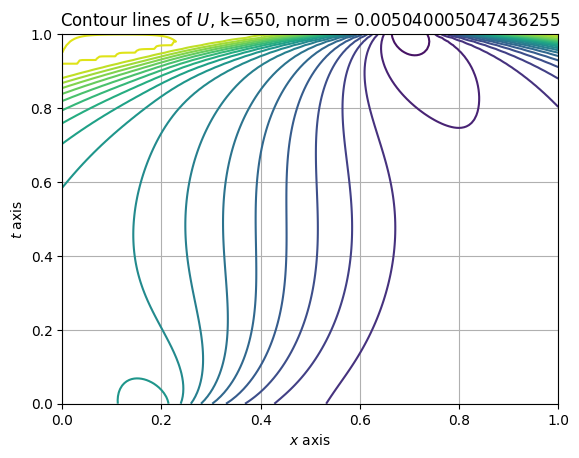

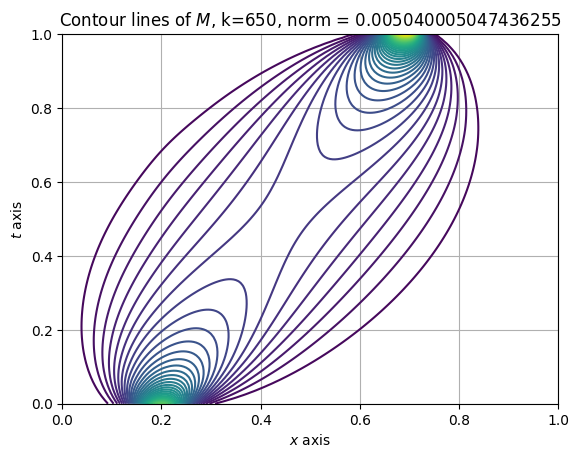

[Fixed Point] Iteration 650, previous norm: 0.005040005047436255, theta: 0.01, elapsed time: 396.5034580230713
[Fixed Point] Iteration 651, previous norm: 0.0049957950878912185, theta: 0.01, elapsed time: 397.2224326133728
[Fixed Point] Iteration 652, previous norm: 0.004951984875736306, theta: 0.01, elapsed time: 397.75528049468994
[Fixed Point] Iteration 653, previous norm: 0.004908570575336098, theta: 0.01, elapsed time: 398.27656960487366
[Fixed Point] Iteration 654, previous norm: 0.004865548391018437, theta: 0.01, elapsed time: 398.8674919605255
[Fixed Point] Iteration 655, previous norm: 0.004822914566630596, theta: 0.01, elapsed time: 399.39608430862427
[Fixed Point] Iteration 656, previous norm: 0.004780665385097494, theta: 0.01, elapsed time: 399.8925721645355
[Fixed Point] Iteration 657, previous norm: 0.004738797167975274, theta: 0.01, elapsed time: 400.4207355976105
[Fixed Point] Iteration 658, previous norm: 0.0046973062750242985, theta: 0.01, elapsed time: 400.9296560287

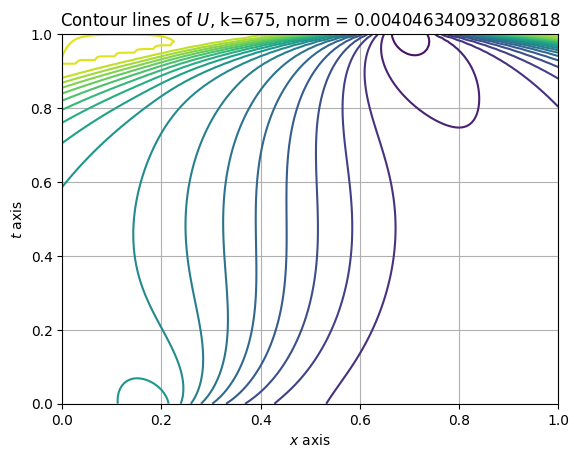

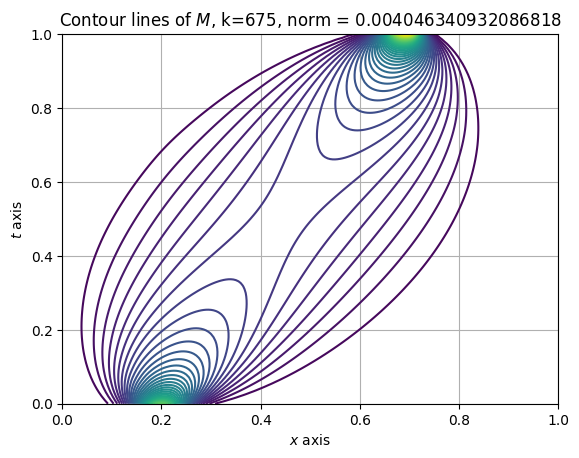

[Fixed Point] Iteration 675, previous norm: 0.004046340932086818, theta: 0.01, elapsed time: 412.06965684890747
[Fixed Point] Iteration 676, previous norm: 0.0040110604765582385, theta: 0.01, elapsed time: 412.7781414985657
[Fixed Point] Iteration 677, previous norm: 0.003976094897596821, theta: 0.01, elapsed time: 413.341912984848
[Fixed Point] Iteration 678, previous norm: 0.003941441235274774, theta: 0.01, elapsed time: 413.8450825214386
[Fixed Point] Iteration 679, previous norm: 0.003907096559832833, theta: 0.01, elapsed time: 414.38842129707336
[Fixed Point] Iteration 680, previous norm: 0.0038730579713519863, theta: 0.01, elapsed time: 414.92162013053894
[Fixed Point] Iteration 681, previous norm: 0.0038393225994163335, theta: 0.01, elapsed time: 415.47874116897583
[Fixed Point] Iteration 682, previous norm: 0.003805887602790788, theta: 0.01, elapsed time: 416.254766702652
[Fixed Point] Iteration 683, previous norm: 0.0037727501690922424, theta: 0.01, elapsed time: 417.819683074

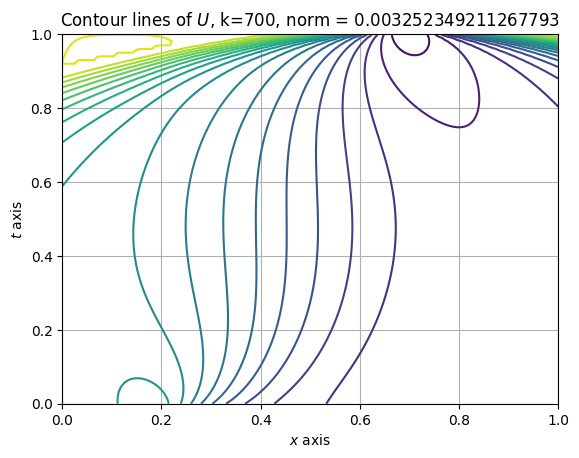

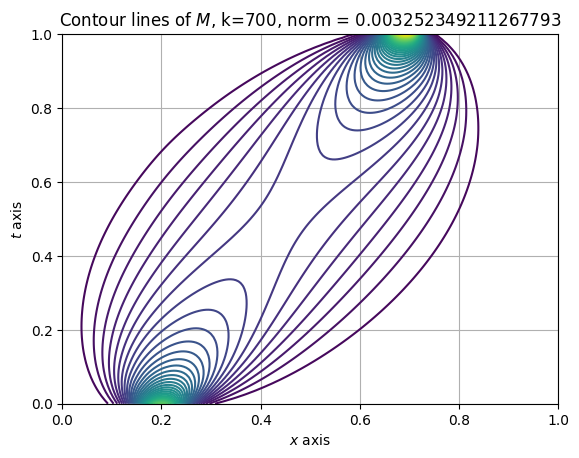

[Fixed Point] Iteration 700, previous norm: 0.003252349211267793, theta: 0.01, elapsed time: 428.4101767539978
[Fixed Point] Iteration 701, previous norm: 0.0032241180455313658, theta: 0.01, elapsed time: 429.1465232372284
[Fixed Point] Iteration 702, previous norm: 0.003196136085745775, theta: 0.01, elapsed time: 429.78311467170715
[Fixed Point] Iteration 703, previous norm: 0.003168401034146295, theta: 0.01, elapsed time: 431.10150480270386
[Fixed Point] Iteration 704, previous norm: 0.0031409106158350945, theta: 0.01, elapsed time: 432.32986426353455
[Fixed Point] Iteration 705, previous norm: 0.0031136625785318523, theta: 0.01, elapsed time: 433.28839445114136
[Fixed Point] Iteration 706, previous norm: 0.003086654692321776, theta: 0.01, elapsed time: 433.76786756515503
[Fixed Point] Iteration 707, previous norm: 0.003059884749419874, theta: 0.01, elapsed time: 434.2819893360138
[Fixed Point] Iteration 708, previous norm: 0.0030333505639216006, theta: 0.01, elapsed time: 434.847862

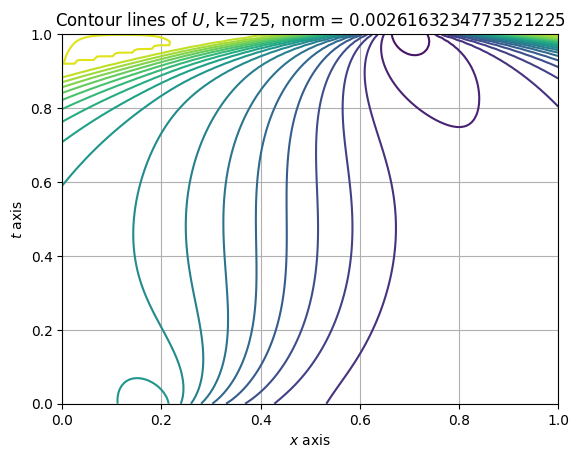

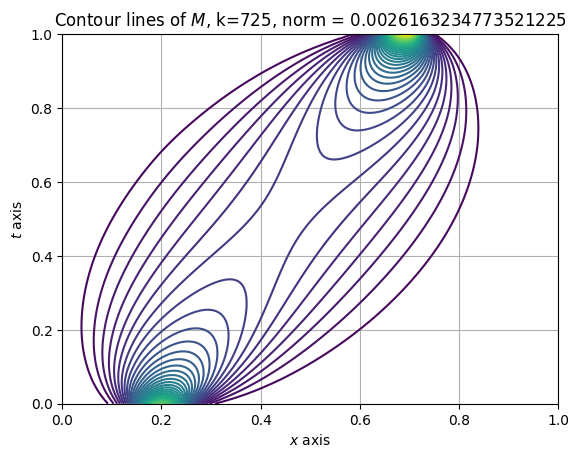

[Fixed Point] Iteration 725, previous norm: 0.0026163234773521225, theta: 0.01, elapsed time: 445.8368651866913
[Fixed Point] Iteration 726, previous norm: 0.002593682711710547, theta: 0.01, elapsed time: 446.7315514087677
[Fixed Point] Iteration 727, previous norm: 0.0025712400282817956, theta: 0.01, elapsed time: 447.27836656570435
[Fixed Point] Iteration 728, previous norm: 0.0025489936323082898, theta: 0.01, elapsed time: 447.8256788253784
[Fixed Point] Iteration 729, previous norm: 0.002526941746456619, theta: 0.01, elapsed time: 448.38107919692993
[Fixed Point] Iteration 730, previous norm: 0.002505082610627178, theta: 0.01, elapsed time: 448.9160647392273
[Fixed Point] Iteration 731, previous norm: 0.0024834144817738983, theta: 0.01, elapsed time: 449.4708731174469
[Fixed Point] Iteration 732, previous norm: 0.002461935633723868, theta: 0.01, elapsed time: 450.01193737983704
[Fixed Point] Iteration 733, previous norm: 0.002440644356992284, theta: 0.01, elapsed time: 450.51883006

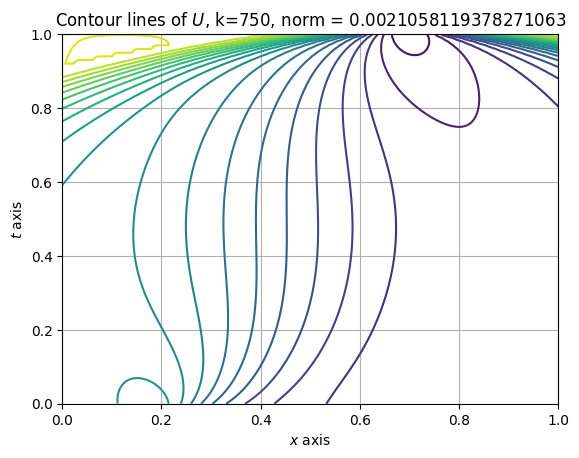

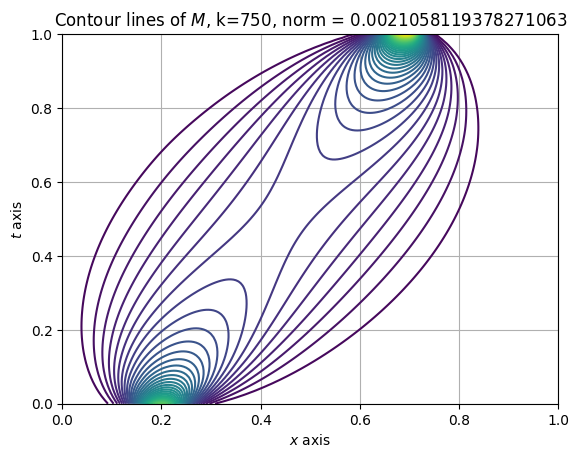

[Fixed Point] Iteration 750, previous norm: 0.0021058119378271063, theta: 0.01, elapsed time: 462.24011754989624
[Fixed Point] Iteration 751, previous norm: 0.00208762262858624, theta: 0.01, elapsed time: 462.96044754981995
[Fixed Point] Iteration 752, previous norm: 0.0020695913574054086, theta: 0.01, elapsed time: 463.57086062431335
[Fixed Point] Iteration 753, previous norm: 0.0020517167139228144, theta: 0.01, elapsed time: 464.104127407074
[Fixed Point] Iteration 754, previous norm: 0.0020339973011408202, theta: 0.01, elapsed time: 464.7078504562378
[Fixed Point] Iteration 755, previous norm: 0.0020164317352874698, theta: 0.01, elapsed time: 465.2492654323578
[Fixed Point] Iteration 756, previous norm: 0.001999018645674719, theta: 0.01, elapsed time: 465.7857382297516
[Fixed Point] Iteration 757, previous norm: 0.001981756674568682, theta: 0.01, elapsed time: 466.378781080246
[Fixed Point] Iteration 758, previous norm: 0.0019646444770483637, theta: 0.01, elapsed time: 466.935758590

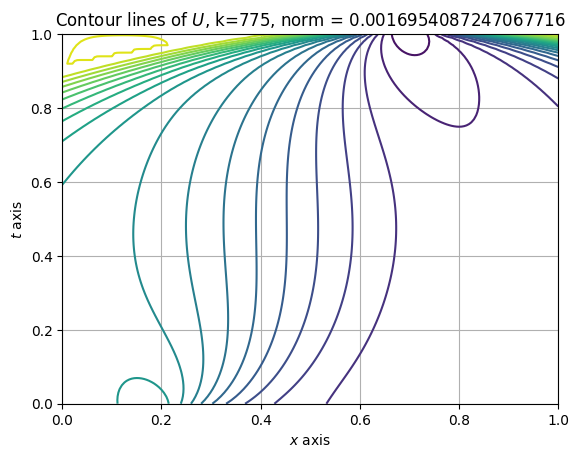

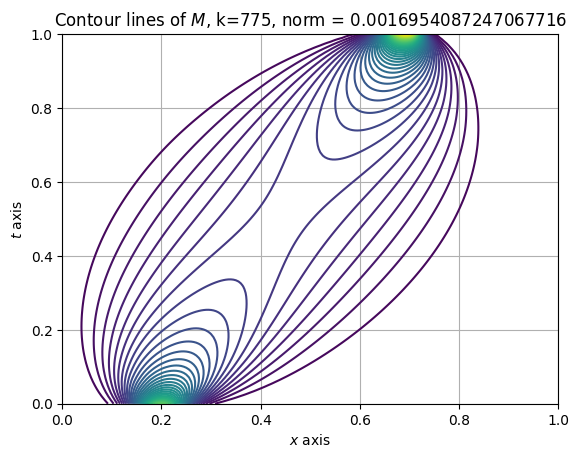

[Fixed Point] Iteration 775, previous norm: 0.0016954087247067716, theta: 0.01, elapsed time: 478.47455525398254
[Fixed Point] Iteration 776, previous norm: 0.0016807763164170657, theta: 0.01, elapsed time: 479.19312477111816
[Fixed Point] Iteration 777, previous norm: 0.001666270395485045, theta: 0.01, elapsed time: 479.6969895362854
[Fixed Point] Iteration 778, previous norm: 0.0016518898473462814, theta: 0.01, elapsed time: 480.2671711444855
[Fixed Point] Iteration 779, previous norm: 0.0016376335677668462, theta: 0.01, elapsed time: 480.83284854888916
[Fixed Point] Iteration 780, previous norm: 0.001623500462728481, theta: 0.01, elapsed time: 481.4034628868103
[Fixed Point] Iteration 781, previous norm: 0.0016094894483298788, theta: 0.01, elapsed time: 481.9183976650238
[Fixed Point] Iteration 782, previous norm: 0.0015955994506854066, theta: 0.01, elapsed time: 482.469033241272
[Fixed Point] Iteration 783, previous norm: 0.001581829405820578, theta: 0.01, elapsed time: 483.0588510

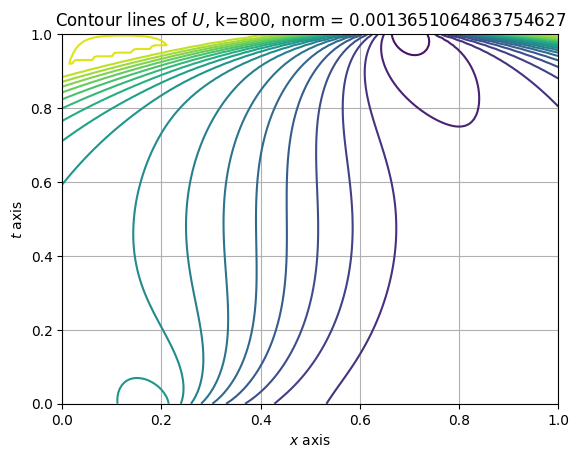

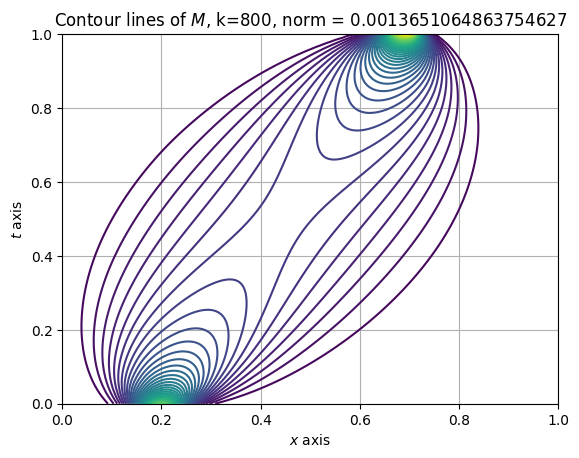

[Fixed Point] Iteration 800, previous norm: 0.0013651064863754627, theta: 0.01, elapsed time: 494.88752841949463
[Fixed Point] Iteration 801, previous norm: 0.0013533243779817333, theta: 0.01, elapsed time: 495.5238151550293
[Fixed Point] Iteration 802, previous norm: 0.0013416437640936228, theta: 0.01, elapsed time: 496.10998821258545
[Fixed Point] Iteration 803, previous norm: 0.0013300637594543076, theta: 0.01, elapsed time: 496.6292197704315
[Fixed Point] Iteration 804, previous norm: 0.00131858348684444, theta: 0.01, elapsed time: 497.5101902484894
[Fixed Point] Iteration 805, previous norm: 0.001307202077000082, theta: 0.01, elapsed time: 499.2141077518463
[Fixed Point] Iteration 806, previous norm: 0.0012959186685360896, theta: 0.01, elapsed time: 500.4577486515045
[Fixed Point] Iteration 807, previous norm: 0.0012847324078682073, theta: 0.01, elapsed time: 501.03208327293396
[Fixed Point] Iteration 808, previous norm: 0.0012736424491382333, theta: 0.01, elapsed time: 501.581917

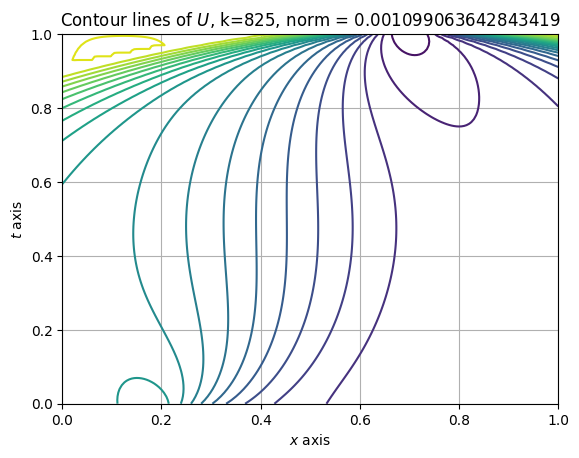

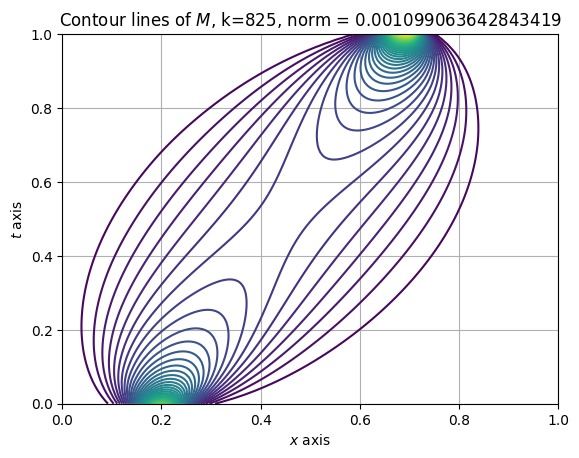

[Fixed Point] Iteration 825, previous norm: 0.001099063642843419, theta: 0.01, elapsed time: 512.6099057197571
[Fixed Point] Iteration 826, previous norm: 0.0010895708475114497, theta: 0.01, elapsed time: 513.710394859314
[Fixed Point] Iteration 827, previous norm: 0.0010801596547801273, theta: 0.01, elapsed time: 514.4266250133514
[Fixed Point] Iteration 828, previous norm: 0.0010708293584626794, theta: 0.01, elapsed time: 514.9582352638245
[Fixed Point] Iteration 829, previous norm: 0.0010615792586705537, theta: 0.01, elapsed time: 515.4471552371979
[Fixed Point] Iteration 830, previous norm: 0.001052408661756656, theta: 0.01, elapsed time: 515.9907019138336
[Fixed Point] Iteration 831, previous norm: 0.001043316880251309, theta: 0.01, elapsed time: 516.4993808269501
[Fixed Point] Iteration 832, previous norm: 0.0010343032328069563, theta: 0.01, elapsed time: 517.1289985179901
[Fixed Point] Iteration 833, previous norm: 0.0010253670441362874, theta: 0.01, elapsed time: 517.6415209770

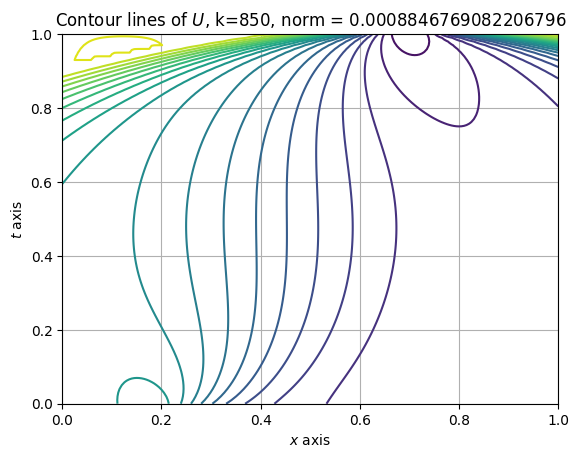

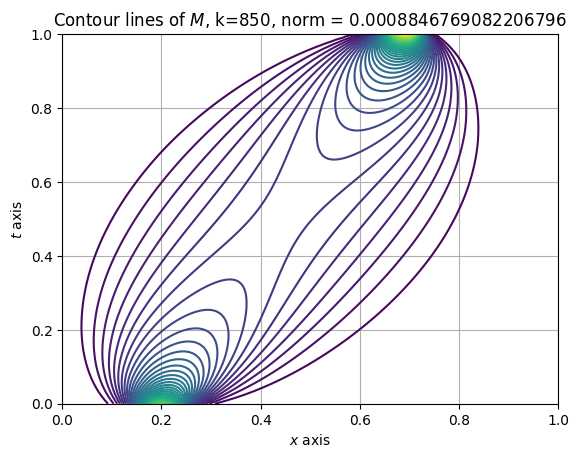

[Fixed Point] Iteration 850, previous norm: 0.0008846769082206796, theta: 0.01, elapsed time: 529.5927364826202
[Fixed Point] Iteration 851, previous norm: 0.0008770260816423062, theta: 0.01, elapsed time: 530.2601974010468
[Fixed Point] Iteration 852, previous norm: 0.0008694409620830935, theta: 0.01, elapsed time: 530.8779187202454
[Fixed Point] Iteration 853, previous norm: 0.0008619209841694937, theta: 0.01, elapsed time: 531.4740672111511
[Fixed Point] Iteration 854, previous norm: 0.0008544655874951385, theta: 0.01, elapsed time: 532.0093398094177
[Fixed Point] Iteration 855, previous norm: 0.0008470742165811938, theta: 0.01, elapsed time: 532.5413415431976
[Fixed Point] Iteration 856, previous norm: 0.000839746320824996, theta: 0.01, elapsed time: 533.0619115829468
[Fixed Point] Iteration 857, previous norm: 0.0008324813544597221, theta: 0.01, elapsed time: 533.6371247768402
[Fixed Point] Iteration 858, previous norm: 0.0008252787765051523, theta: 0.01, elapsed time: 534.1492044

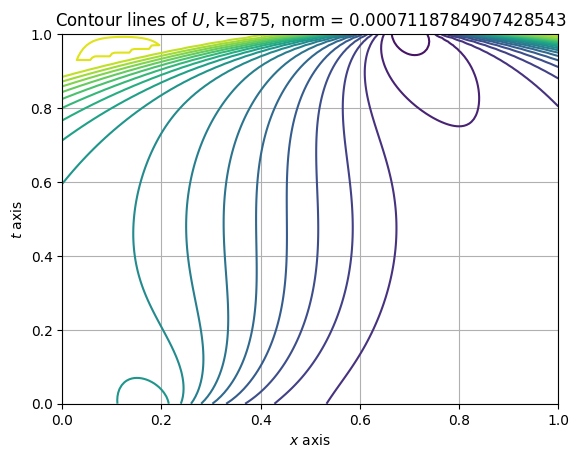

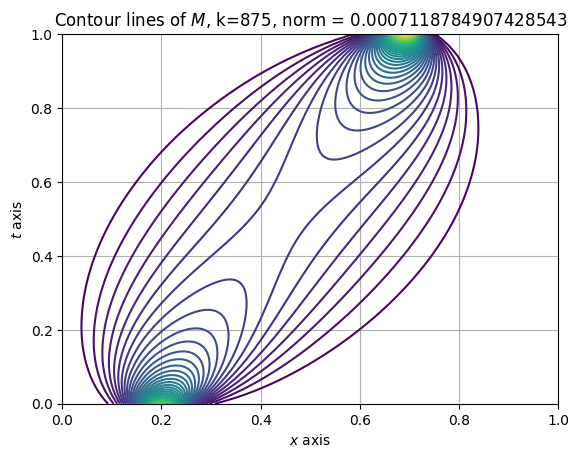

[Fixed Point] Iteration 875, previous norm: 0.0007118784907428543, theta: 0.01, elapsed time: 545.843013048172
[Fixed Point] Iteration 876, previous norm: 0.0007057115990529629, theta: 0.01, elapsed time: 546.5682961940765
[Fixed Point] Iteration 877, previous norm: 0.0006995976705897847, theta: 0.01, elapsed time: 547.1165919303894
[Fixed Point] Iteration 878, previous norm: 0.0006935362513991224, theta: 0.01, elapsed time: 547.6541240215302
[Fixed Point] Iteration 879, previous norm: 0.0006875268914744993, theta: 0.01, elapsed time: 548.2313199043274
[Fixed Point] Iteration 880, previous norm: 0.0006815691447182072, theta: 0.01, elapsed time: 548.7321443557739
[Fixed Point] Iteration 881, previous norm: 0.0006756625689051663, theta: 0.01, elapsed time: 549.2630040645599
[Fixed Point] Iteration 882, previous norm: 0.0006698067256506717, theta: 0.01, elapsed time: 549.8360221385956
[Fixed Point] Iteration 883, previous norm: 0.0006640011803739264, theta: 0.01, elapsed time: 550.4338531

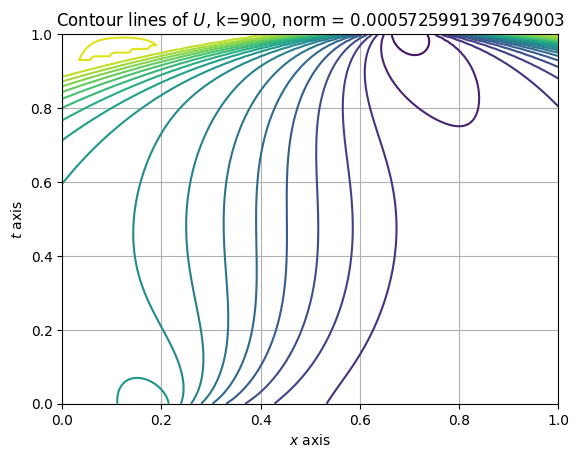

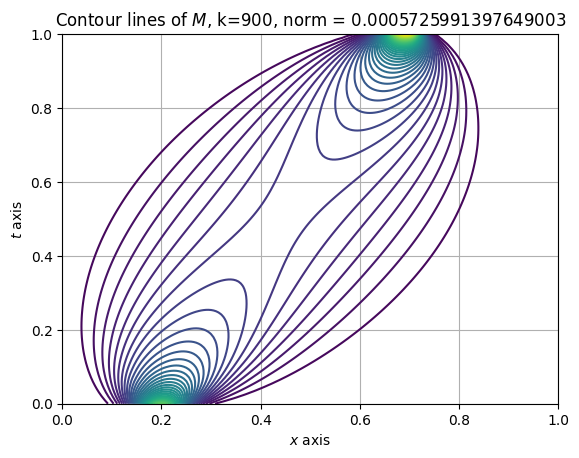

[Fixed Point] Iteration 900, previous norm: 0.0005725991397649003, theta: 0.01, elapsed time: 562.1193177700043
[Fixed Point] Iteration 901, previous norm: 0.0005676287818572424, theta: 0.01, elapsed time: 562.9857521057129
[Fixed Point] Iteration 902, previous norm: 0.0005627011437931337, theta: 0.01, elapsed time: 563.5671725273132
[Fixed Point] Iteration 903, previous norm: 0.0005578158602680867, theta: 0.01, elapsed time: 564.172788143158
[Fixed Point] Iteration 904, previous norm: 0.000552972569123271, theta: 0.01, elapsed time: 564.793035030365
[Fixed Point] Iteration 905, previous norm: 0.0005481709113209741, theta: 0.01, elapsed time: 566.1096756458282
[Fixed Point] Iteration 906, previous norm: 0.000543410530912851, theta: 0.01, elapsed time: 567.6924517154694
[Fixed Point] Iteration 907, previous norm: 0.0005386910750159222, theta: 0.01, elapsed time: 569.2496938705444
[Fixed Point] Iteration 908, previous norm: 0.000534012193782587, theta: 0.01, elapsed time: 570.70725512504

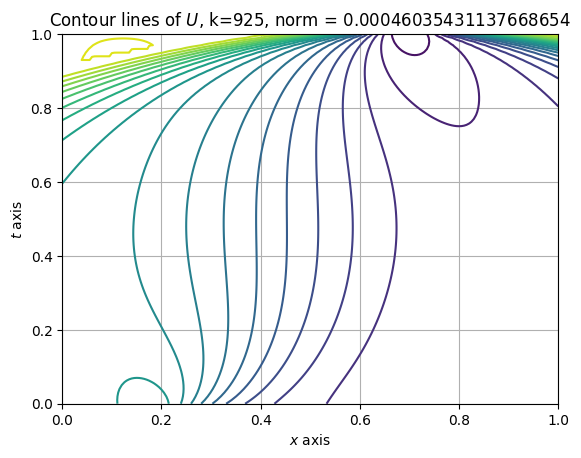

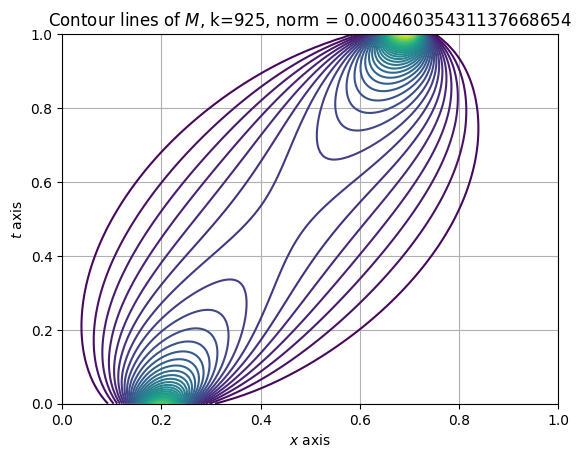

[Fixed Point] Iteration 925, previous norm: 0.00046035431137668654, theta: 0.01, elapsed time: 584.8598382472992
[Fixed Point] Iteration 926, previous norm: 0.0004563492555465958, theta: 0.01, elapsed time: 585.5233788490295
[Fixed Point] Iteration 927, previous norm: 0.00045237866983734203, theta: 0.01, elapsed time: 586.0976717472076
[Fixed Point] Iteration 928, previous norm: 0.0004484422597942499, theta: 0.01, elapsed time: 586.6958799362183
[Fixed Point] Iteration 929, previous norm: 0.00044453973348328077, theta: 0.01, elapsed time: 587.2906725406647
[Fixed Point] Iteration 930, previous norm: 0.0004406708014682526, theta: 0.01, elapsed time: 587.9076204299927
[Fixed Point] Iteration 931, previous norm: 0.0004368351767898549, theta: 0.01, elapsed time: 588.4715397357941
[Fixed Point] Iteration 932, previous norm: 0.00043303257494683317, theta: 0.01, elapsed time: 589.0610682964325
[Fixed Point] Iteration 933, previous norm: 0.00042926271386622766, theta: 0.01, elapsed time: 589.6

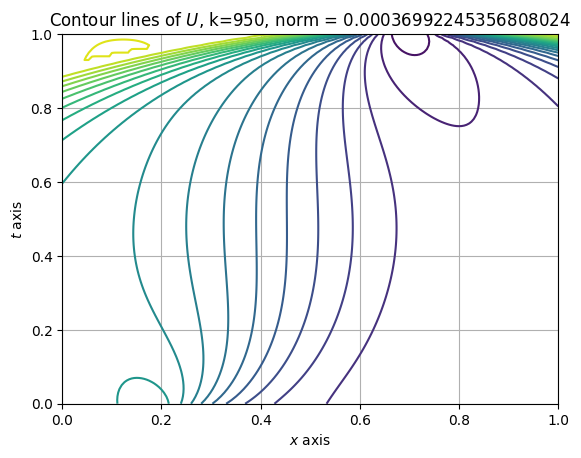

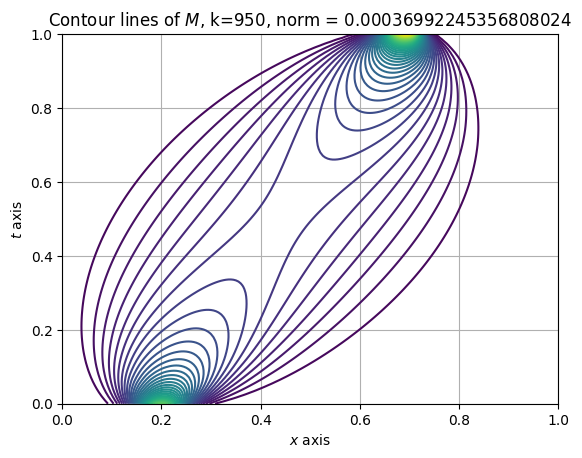

[Fixed Point] Iteration 950, previous norm: 0.00036992245356808024, theta: 0.01, elapsed time: 601.8881261348724
[Fixed Point] Iteration 951, previous norm: 0.0003666963428624396, theta: 0.01, elapsed time: 602.5658686161041
[Fixed Point] Iteration 952, previous norm: 0.00036349804877369984, theta: 0.01, elapsed time: 603.2282154560089
[Fixed Point] Iteration 953, previous norm: 0.00036032733368349573, theta: 0.01, elapsed time: 603.8105244636536
[Fixed Point] Iteration 954, previous norm: 0.00035718396199545905, theta: 0.01, elapsed time: 604.4137015342712
[Fixed Point] Iteration 955, previous norm: 0.0003540677001243096, theta: 0.01, elapsed time: 604.9728293418884
[Fixed Point] Iteration 956, previous norm: 0.0003509783164741193, theta: 0.01, elapsed time: 605.568520784378
[Fixed Point] Iteration 957, previous norm: 0.00034791558142199775, theta: 0.01, elapsed time: 606.14848279953
[Fixed Point] Iteration 958, previous norm: 0.00034487926730074813, theta: 0.01, elapsed time: 606.703

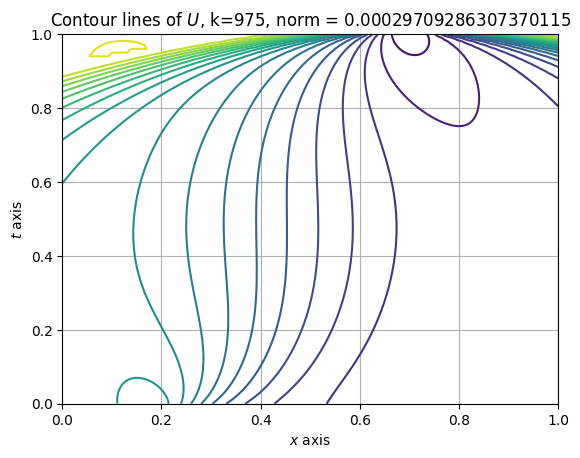

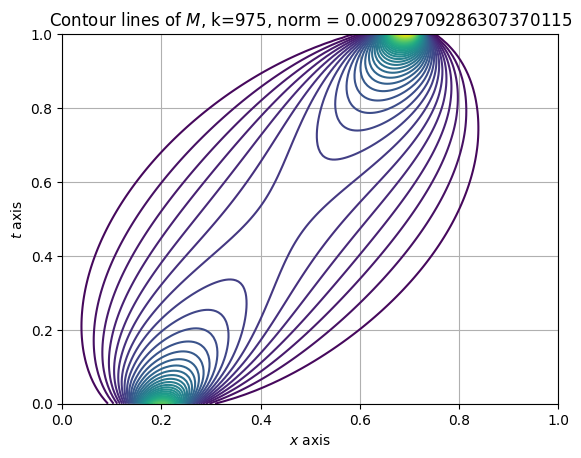

[Fixed Point] Iteration 975, previous norm: 0.00029709286307370115, theta: 0.01, elapsed time: 619.4213619232178
[Fixed Point] Iteration 976, previous norm: 0.00029449532673127044, theta: 0.01, elapsed time: 620.1161215305328
[Fixed Point] Iteration 977, previous norm: 0.0002919202357473387, theta: 0.01, elapsed time: 620.714893579483
[Fixed Point] Iteration 978, previous norm: 0.000289367398226691, theta: 0.01, elapsed time: 621.6335637569427
[Fixed Point] Iteration 979, previous norm: 0.00028683662390365346, theta: 0.01, elapsed time: 623.0787010192871
[Fixed Point] Iteration 980, previous norm: 0.0002843277241307561, theta: 0.01, elapsed time: 624.0871779918671
[Fixed Point] Iteration 981, previous norm: 0.0002818405118642528, theta: 0.01, elapsed time: 625.0878908634186
[Fixed Point] Iteration 982, previous norm: 0.0002793748016515681, theta: 0.01, elapsed time: 625.6912515163422
[Fixed Point] Iteration 983, previous norm: 0.0002769304096142486, theta: 0.01, elapsed time: 626.24031

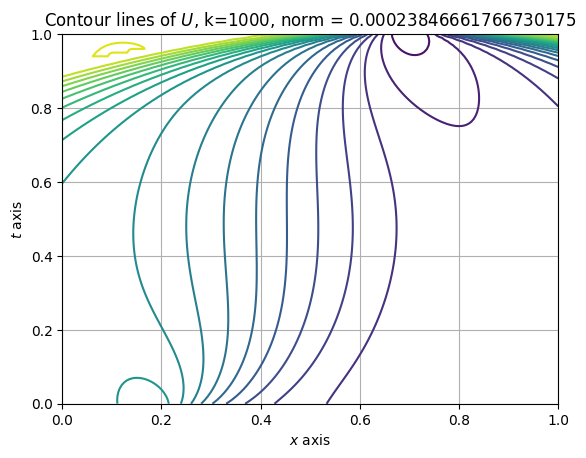

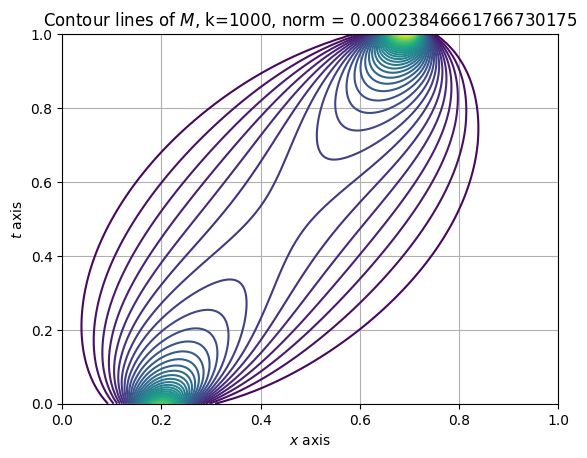

[Fixed Point] Iteration 1000, previous norm: 0.00023846661766730175, theta: 0.01, elapsed time: 637.5027649402618
[Fixed Point] Iteration 1001, previous norm: 0.0002363762283689618, theta: 0.01, elapsed time: 638.7973256111145
[Fixed Point] Iteration 1002, previous norm: 0.00023430394582264947, theta: 0.01, elapsed time: 639.3651993274689
[Fixed Point] Iteration 1003, previous norm: 0.00023224961499536292, theta: 0.01, elapsed time: 639.9610676765442
[Fixed Point] Iteration 1004, previous norm: 0.00023021308217293087, theta: 0.01, elapsed time: 640.5287356376648
[Fixed Point] Iteration 1005, previous norm: 0.0002281941949438314, theta: 0.01, elapsed time: 641.1468720436096
[Fixed Point] Iteration 1006, previous norm: 0.00022619280219274586, theta: 0.01, elapsed time: 641.7374172210693
[Fixed Point] Iteration 1007, previous norm: 0.00022420875408706936, theta: 0.01, elapsed time: 642.3120000362396
[Fixed Point] Iteration 1008, previous norm: 0.0002222419020656239, theta: 0.01, elapsed t

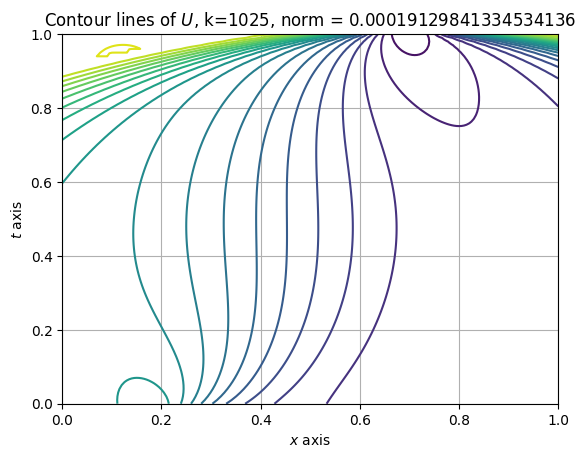

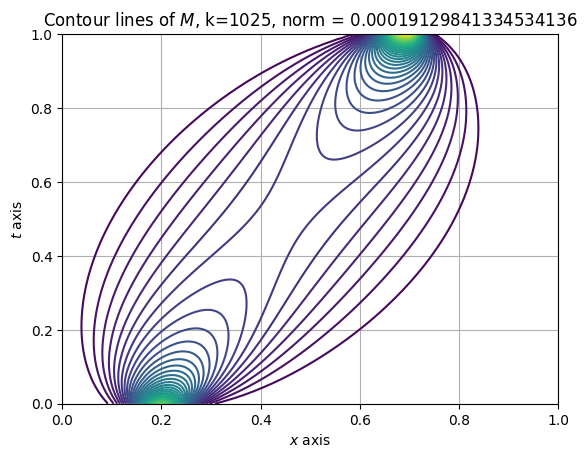

[Fixed Point] Iteration 1025, previous norm: 0.00019129841334534136, theta: 0.01, elapsed time: 655.1810715198517
[Fixed Point] Iteration 1026, previous norm: 0.0001896170746753974, theta: 0.01, elapsed time: 655.8752961158752
[Fixed Point] Iteration 1027, previous norm: 0.0001879503373538029, theta: 0.01, elapsed time: 656.4068298339844
[Fixed Point] Iteration 1028, previous norm: 0.00018629807611620852, theta: 0.01, elapsed time: 657.0188934803009
[Fixed Point] Iteration 1029, previous norm: 0.00018466016676036898, theta: 0.01, elapsed time: 657.6047813892365
[Fixed Point] Iteration 1030, previous norm: 0.00018303648614167902, theta: 0.01, elapsed time: 658.2146360874176
[Fixed Point] Iteration 1031, previous norm: 0.00018142691215927085, theta: 0.01, elapsed time: 658.8168601989746
[Fixed Point] Iteration 1032, previous norm: 0.00017983132375092584, theta: 0.01, elapsed time: 659.4115295410156
[Fixed Point] Iteration 1033, previous norm: 0.00017824960088042154, theta: 0.01, elapsed 

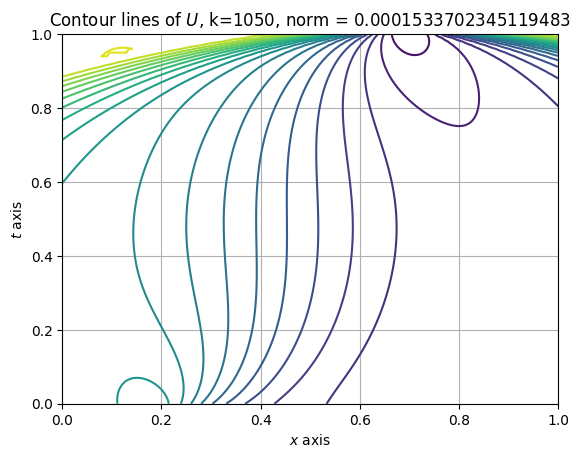

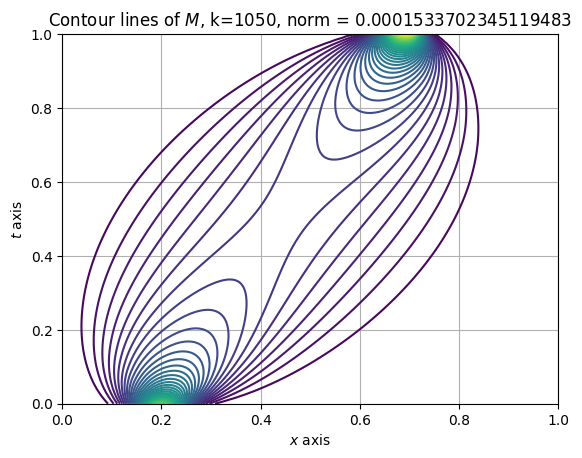

[Fixed Point] Iteration 1050, previous norm: 0.0001533702345119483, theta: 0.01, elapsed time: 672.1280887126923
[Fixed Point] Iteration 1051, previous norm: 0.0001520186869781302, theta: 0.01, elapsed time: 672.7816450595856
[Fixed Point] Iteration 1052, previous norm: 0.00015067890854527835, theta: 0.01, elapsed time: 673.383898973465
[Fixed Point] Iteration 1053, previous norm: 0.00014935079801052338, theta: 0.01, elapsed time: 673.9426937103271
[Fixed Point] Iteration 1054, previous norm: 0.00014803425503175555, theta: 0.01, elapsed time: 674.5625021457672
[Fixed Point] Iteration 1055, previous norm: 0.00014672918012044862, theta: 0.01, elapsed time: 675.180210351944
[Fixed Point] Iteration 1056, previous norm: 0.00014543547463282414, theta: 0.01, elapsed time: 676.0141046047211
[Fixed Point] Iteration 1057, previous norm: 0.00014415304076392625, theta: 0.01, elapsed time: 677.7747497558594
[Fixed Point] Iteration 1058, previous norm: 0.0001428817815411724, theta: 0.01, elapsed tim

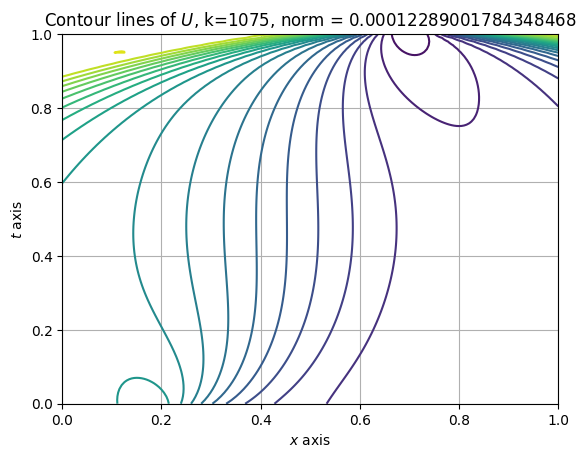

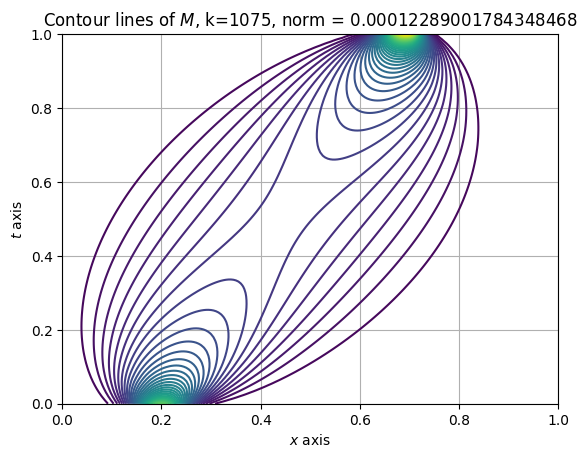

[Fixed Point] Iteration 1075, previous norm: 0.00012289001784348468, theta: 0.01, elapsed time: 689.3863370418549
[Fixed Point] Iteration 1076, previous norm: 0.00012180422698731237, theta: 0.01, elapsed time: 690.9185853004456
[Fixed Point] Iteration 1077, previous norm: 0.00012072791729297057, theta: 0.01, elapsed time: 692.2847375869751
[Fixed Point] Iteration 1078, previous norm: 0.00011966100701994542, theta: 0.01, elapsed time: 693.1899297237396
[Fixed Point] Iteration 1079, previous norm: 0.00011860341512281509, theta: 0.01, elapsed time: 693.761800289154
[Fixed Point] Iteration 1080, previous norm: 0.00011755506124912469, theta: 0.01, elapsed time: 694.3856816291809
[Fixed Point] Iteration 1081, previous norm: 0.00011651586572841766, theta: 0.01, elapsed time: 694.9527060985565
[Fixed Point] Iteration 1082, previous norm: 0.00011548574956943373, theta: 0.01, elapsed time: 695.5181057453156
[Fixed Point] Iteration 1083, previous norm: 0.00011446463445332082, theta: 0.01, elapsed

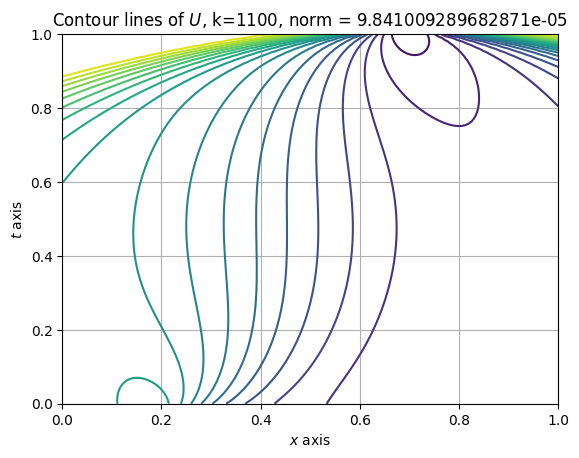

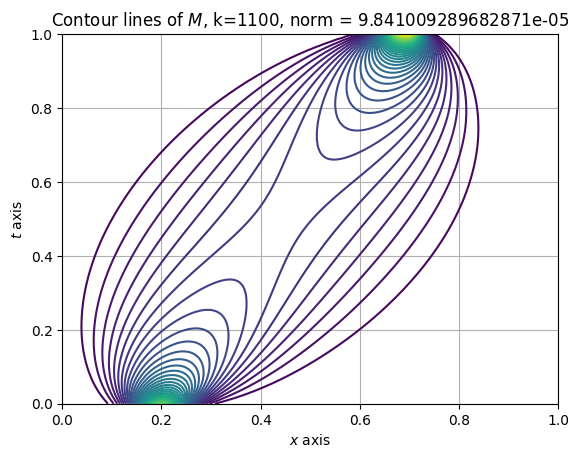

[Fixed Point] Iteration 1100, previous norm: 9.841009289682871e-05, theta: 0.01, elapsed time: 708.2869532108307
[Fixed Point] Iteration 1101, previous norm: 9.753833800038248e-05, theta: 0.01, elapsed time: 708.9723618030548
[Fixed Point] Iteration 1102, previous norm: 9.667421664611727e-05, theta: 0.01, elapsed time: 709.5928294658661
[Fixed Point] Iteration 1103, previous norm: 9.581766284093751e-05, theta: 0.01, elapsed time: 710.1598961353302
[Fixed Point] Iteration 1104, previous norm: 9.496861115414836e-05, theta: 0.01, elapsed time: 710.7858021259308
[Fixed Point] Iteration 1105, previous norm: 9.412699671200708e-05, theta: 0.01, elapsed time: 711.3406229019165
[Fixed Point] Iteration 1106, previous norm: 9.32927551960973e-05, theta: 0.01, elapsed time: 711.876841545105
[Fixed Point] Iteration 1107, previous norm: 9.24658228366074e-05, theta: 0.01, elapsed time: 712.4311165809631
[Fixed Point] Iteration 1108, previous norm: 9.16461364077016e-05, theta: 0.01, elapsed time: 712.9

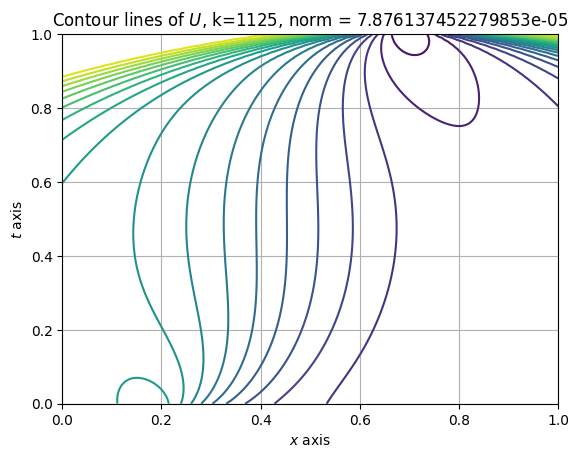

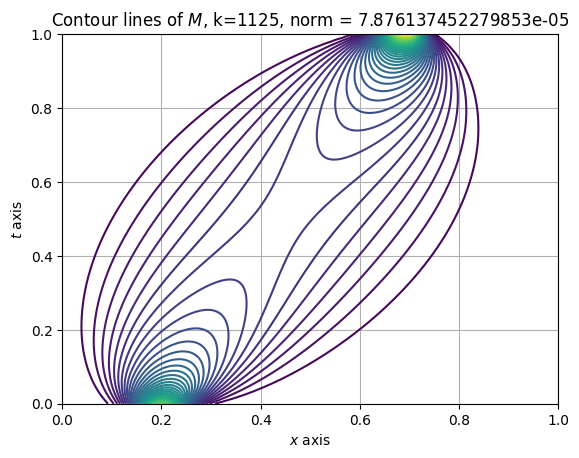

[Fixed Point] Iteration 1125, previous norm: 7.876137452279853e-05, theta: 0.01, elapsed time: 725.5918893814087
[Fixed Point] Iteration 1126, previous norm: 7.806189703878583e-05, theta: 0.01, elapsed time: 726.3968074321747
[Fixed Point] Iteration 1127, previous norm: 7.736856173119209e-05, theta: 0.01, elapsed time: 726.9930760860443
[Fixed Point] Iteration 1128, previous norm: 7.668131534604148e-05, theta: 0.01, elapsed time: 727.5516376495361
[Fixed Point] Iteration 1129, previous norm: 7.600010508488475e-05, theta: 0.01, elapsed time: 728.1455888748169
[Fixed Point] Iteration 1130, previous norm: 7.532487859965855e-05, theta: 0.01, elapsed time: 728.6994340419769
[Fixed Point] Iteration 1131, previous norm: 7.465558399131189e-05, theta: 0.01, elapsed time: 729.3186757564545
[Fixed Point] Iteration 1132, previous norm: 7.399216980439924e-05, theta: 0.01, elapsed time: 729.8691351413727
[Fixed Point] Iteration 1133, previous norm: 7.333458502314963e-05, theta: 0.01, elapsed time: 7

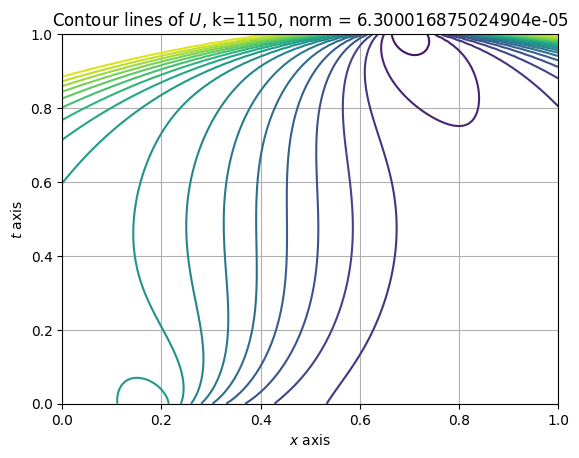

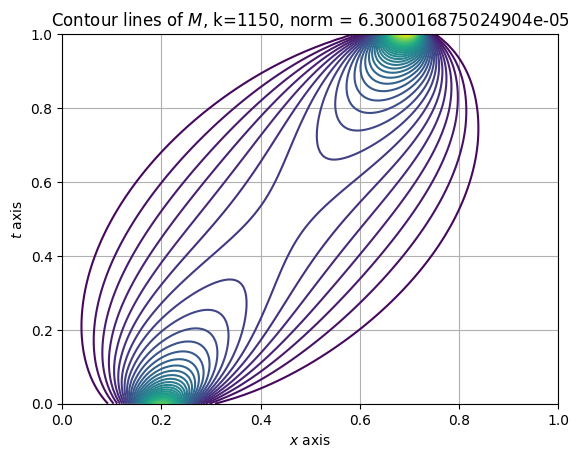

[Fixed Point] Iteration 1150, previous norm: 6.300016875024904e-05, theta: 0.01, elapsed time: 742.7096977233887
[Fixed Point] Iteration 1151, previous norm: 6.243927005308343e-05, theta: 0.01, elapsed time: 743.6558318138123
[Fixed Point] Iteration 1152, previous norm: 6.18833103739509e-05, theta: 0.01, elapsed time: 745.1102952957153
[Fixed Point] Iteration 1153, previous norm: 6.133224676349252e-05, theta: 0.01, elapsed time: 746.4886763095856
[Fixed Point] Iteration 1154, previous norm: 6.078603664039087e-05, theta: 0.01, elapsed time: 747.3520889282227
[Fixed Point] Iteration 1155, previous norm: 6.0244637789046715e-05, theta: 0.01, elapsed time: 747.8856272697449
[Fixed Point] Iteration 1156, previous norm: 5.970800835533836e-05, theta: 0.01, elapsed time: 748.4342460632324
[Fixed Point] Iteration 1157, previous norm: 5.917610684493356e-05, theta: 0.01, elapsed time: 748.9874210357666
[Fixed Point] Iteration 1158, previous norm: 5.864889211936863e-05, theta: 0.01, elapsed time: 7

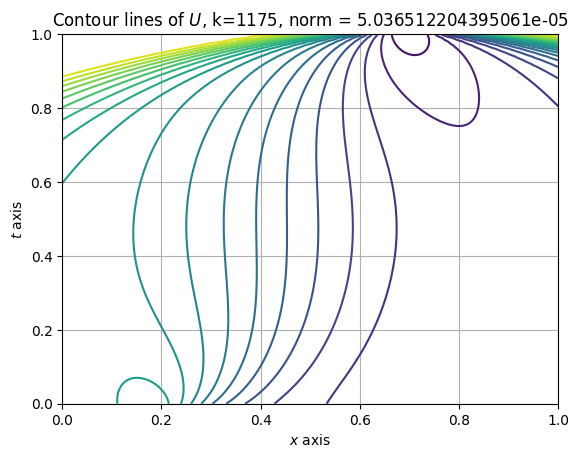

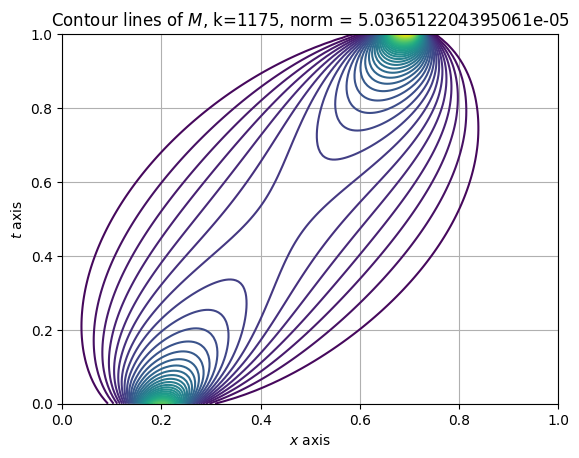

[Fixed Point] Iteration 1175, previous norm: 5.036512204395061e-05, theta: 0.01, elapsed time: 762.2357096672058
[Fixed Point] Iteration 1176, previous norm: 4.9915623191147055e-05, theta: 0.01, elapsed time: 762.9578850269318
[Fixed Point] Iteration 1177, previous norm: 4.947009329053607e-05, theta: 0.01, elapsed time: 763.5337371826172
[Fixed Point] Iteration 1178, previous norm: 4.90284977245834e-05, theta: 0.01, elapsed time: 764.1865611076355
[Fixed Point] Iteration 1179, previous norm: 4.8590802174249905e-05, theta: 0.01, elapsed time: 764.7288579940796
[Fixed Point] Iteration 1180, previous norm: 4.815697261502091e-05, theta: 0.01, elapsed time: 765.371196269989
[Fixed Point] Iteration 1181, previous norm: 4.772697531645175e-05, theta: 0.01, elapsed time: 765.9892656803131
[Fixed Point] Iteration 1182, previous norm: 4.7300776837462736e-05, theta: 0.01, elapsed time: 766.6019396781921
[Fixed Point] Iteration 1183, previous norm: 4.6878344025603565e-05, theta: 0.01, elapsed time:

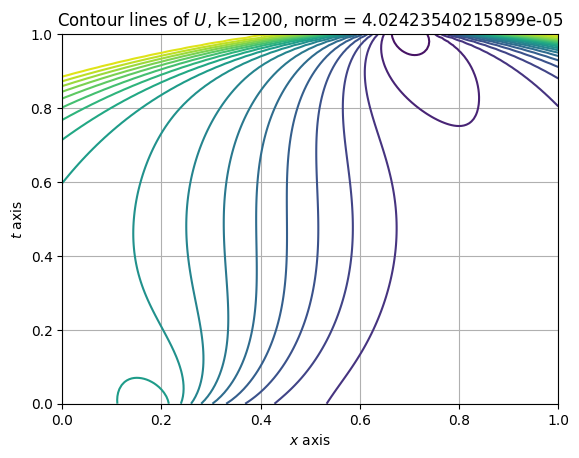

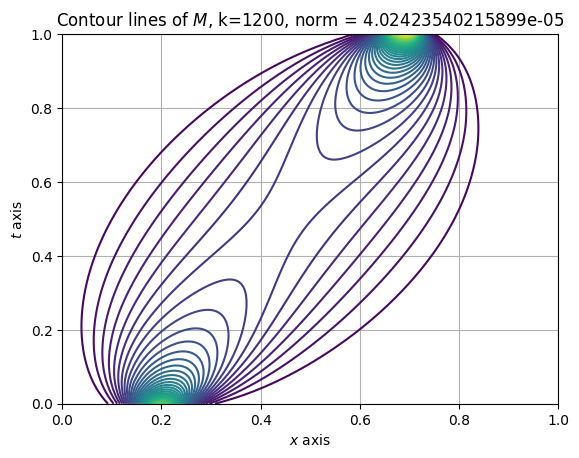

[Fixed Point] Iteration 1200, previous norm: 4.02423540215899e-05, theta: 0.01, elapsed time: 779.9252164363861
[Fixed Point] Iteration 1201, previous norm: 3.9882347991118786e-05, theta: 0.01, elapsed time: 780.7284235954285
[Fixed Point] Iteration 1202, previous norm: 3.952552928395226e-05, theta: 0.01, elapsed time: 781.3741376399994
[Fixed Point] Iteration 1203, previous norm: 3.917187001525768e-05, theta: 0.01, elapsed time: 782.008327960968
[Fixed Point] Iteration 1204, previous norm: 3.882134254525932e-05, theta: 0.01, elapsed time: 782.6697599887848
[Fixed Point] Iteration 1205, previous norm: 3.8473919469455424e-05, theta: 0.01, elapsed time: 783.2666854858398
[Fixed Point] Iteration 1206, previous norm: 3.8129573621114794e-05, theta: 0.01, elapsed time: 783.9022126197815
[Fixed Point] Iteration 1207, previous norm: 3.77882780676993e-05, theta: 0.01, elapsed time: 784.7726843357086
[Fixed Point] Iteration 1208, previous norm: 3.745000610965517e-05, theta: 0.01, elapsed time: 7

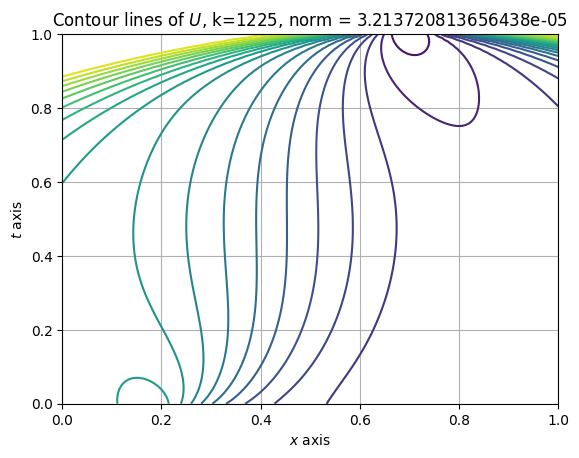

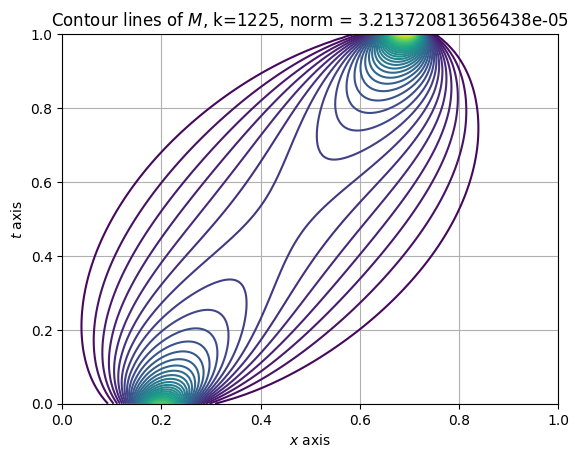

[Fixed Point] Iteration 1225, previous norm: 3.213720813656438e-05, theta: 0.01, elapsed time: 797.5946502685547
[Fixed Point] Iteration 1226, previous norm: 3.1849048824851246e-05, theta: 0.01, elapsed time: 798.772670507431
[Fixed Point] Iteration 1227, previous norm: 3.156344746185583e-05, theta: 0.01, elapsed time: 800.296392917633
[Fixed Point] Iteration 1228, previous norm: 3.1280381604431504e-05, theta: 0.01, elapsed time: 801.9197089672089
[Fixed Point] Iteration 1229, previous norm: 3.0999829004106755e-05, theta: 0.01, elapsed time: 803.2406868934631
[Fixed Point] Iteration 1230, previous norm: 3.072176760436147e-05, theta: 0.01, elapsed time: 804.5667948722839
[Fixed Point] Iteration 1231, previous norm: 3.044617553980595e-05, theta: 0.01, elapsed time: 805.1672706604004
[Fixed Point] Iteration 1232, previous norm: 3.017303113541396e-05, theta: 0.01, elapsed time: 805.7853145599365
[Fixed Point] Iteration 1233, previous norm: 2.9902312902390758e-05, theta: 0.01, elapsed time:

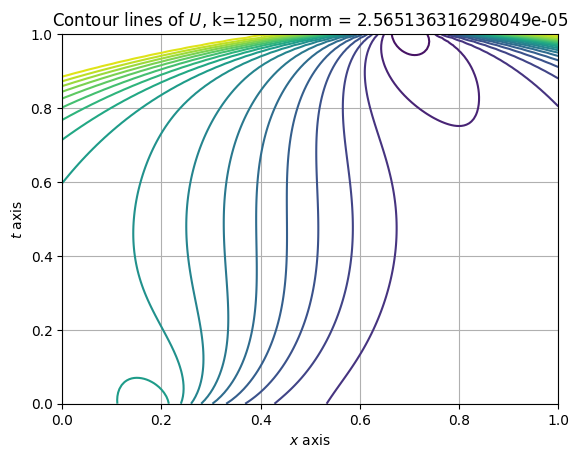

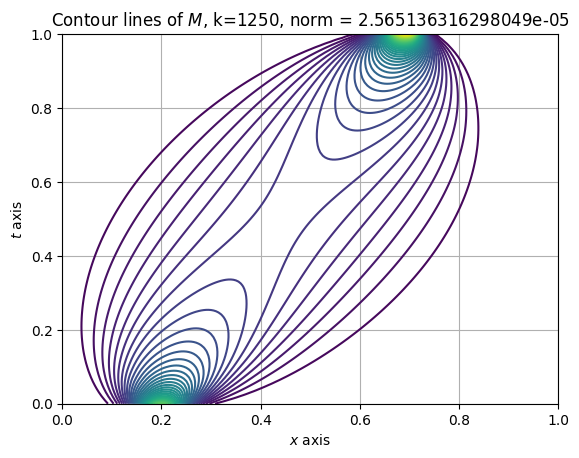

[Fixed Point] Iteration 1250, previous norm: 2.565136316298049e-05, theta: 0.01, elapsed time: 821.1192498207092
[Fixed Point] Iteration 1251, previous norm: 2.542084629610484e-05, theta: 0.01, elapsed time: 821.8441662788391
[Fixed Point] Iteration 1252, previous norm: 2.519238094960194e-05, theta: 0.01, elapsed time: 822.4281058311462
[Fixed Point] Iteration 1253, previous norm: 2.496594907121394e-05, theta: 0.01, elapsed time: 823.0353286266327
[Fixed Point] Iteration 1254, previous norm: 2.4741532766412176e-05, theta: 0.01, elapsed time: 823.5851752758026
[Fixed Point] Iteration 1255, previous norm: 2.4519114294838415e-05, theta: 0.01, elapsed time: 824.2202939987183
[Fixed Point] Iteration 1256, previous norm: 2.4298676070163276e-05, theta: 0.01, elapsed time: 824.8134896755219
[Fixed Point] Iteration 1257, previous norm: 2.4080200660304084e-05, theta: 0.01, elapsed time: 825.4255795478821
[Fixed Point] Iteration 1258, previous norm: 2.3863670783177147e-05, theta: 0.01, elapsed ti

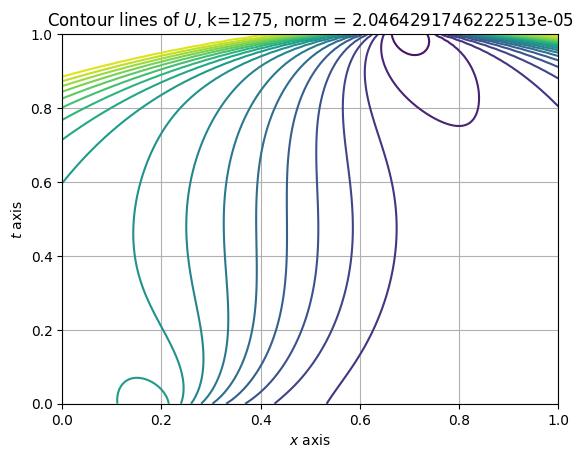

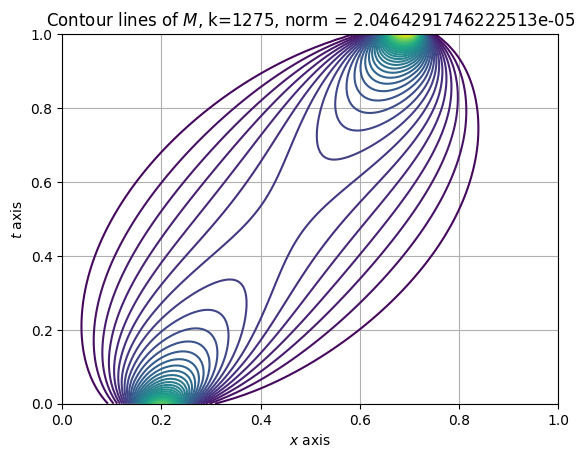

[Fixed Point] Iteration 1275, previous norm: 2.0464291746222513e-05, theta: 0.01, elapsed time: 838.7220754623413
[Fixed Point] Iteration 1276, previous norm: 2.0279991469140668e-05, theta: 0.01, elapsed time: 839.5552351474762
[Fixed Point] Iteration 1277, previous norm: 2.0097335497115353e-05, theta: 0.01, elapsed time: 840.2421526908875


In [ ]:
M = np.zeros((N_T+1, N_h))
M[:] = m0_hat(space_grid)

U = np.zeros((N_T+1, N_h))
U[:] = phi(space_grid)

U_fixed, M_fixed = FixedPoint(U, M)

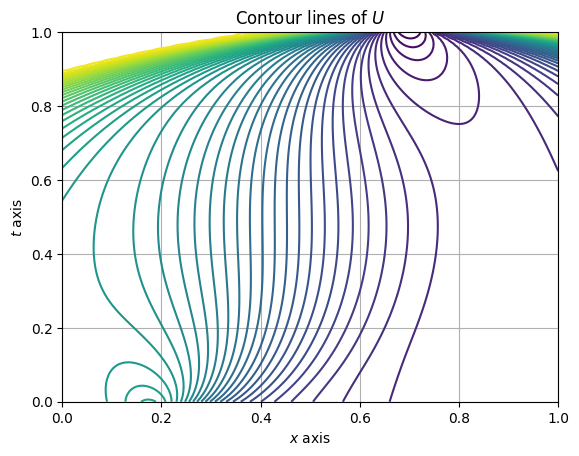

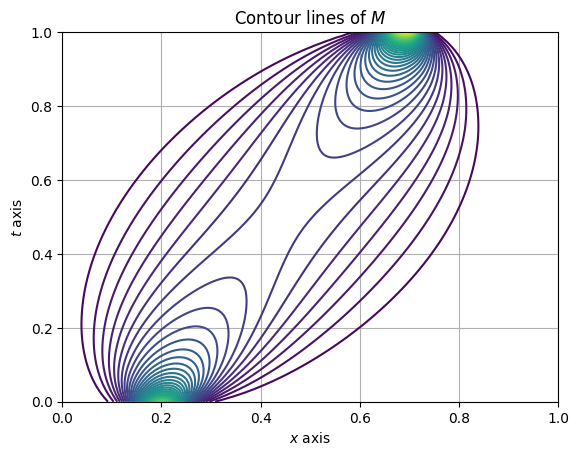

In [ ]:
plt.contour(space_grid, time_grid, U_fixed, levels=50)
plt.title("Contour lines of $U$")
plt.xlabel("$x$ axis")
plt.ylabel("$t$ axis")
plt.grid()
plt.show()

plt.contour(space_grid, time_grid, M_fixed, levels=50)
plt.grid()
plt.title("Contour lines of $M$")
plt.xlabel("$x$ axis")
plt.ylabel("$t$ axis")
plt.show()

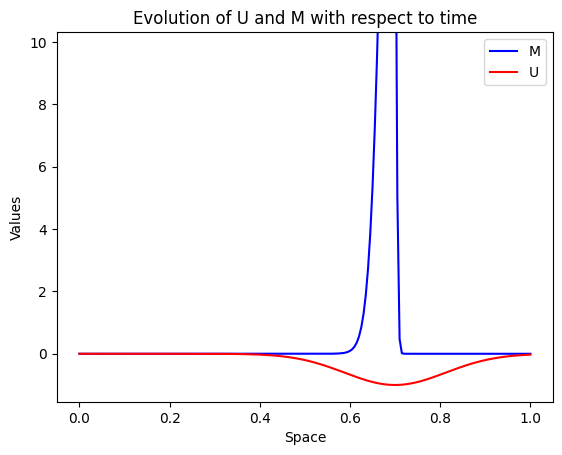

In [ ]:
fig, ax = plt.subplots()

line1, = ax.plot(space_grid, M_fixed[0, :], color='blue', label='M')
line2, = ax.plot(space_grid, U_fixed[0, :], color='red', label='U')

ax.legend(loc='best')
ax.set_title('Evolution of U and M with respect to time')
ax.set_xlabel('Space')
ax.set_ylabel('Values')

def init():
    line1.set_ydata([np.nan] * len(space_grid))
    line2.set_ydata([np.nan] * len(space_grid))
    return line1, line2

def animate(i):
    line1.set_ydata(M_fixed[i, :])
    line2.set_ydata(U_fixed[i, :])
    return line1, line2


ani = animation.FuncAnimation(
    fig, animate, init_func=init, interval=100, blit=True, frames=len(time_grid)
)
ani.save('video_mfg.mp4', writer='ffmpeg')


HTML(ani.to_jshtml())

**Remark:** We can notice from the different graphs obtained that we have two main focus points :

*   One at $x = 0.2$
*   The other one at $x = 0.7$

We can guess that this comes from the functions $\phi (x, m) = - \ exp(-40(x - 0.7)^2)$ and $m_0(x) = \sqrt{\frac{300}{\pi}} exp(-300(x - 0.2)^2)$


## **Theoretical Questions**

1. **Understand why the mass of $M^n$, i.e. $\sum_{i = 0}^{Nh - 1} M_i^n$, does not depend on n**

We consider that $M^n$ is a vector column. We recall that:

$$
M^n = (I_{Nh} - \nu \Delta t D_x^2 + \Delta t (J_H)^T) M^{n+1} := B \ M^{n+1}
$$

Let $v = (1 \ 1 \ ... \ 1) \in \mathbb{R}^{Nh}$. If we can prove that $B^T \ v = v$, then we are done as this would imply that $v^T \ B = v^T$ and then $v^T \ B \ M^{n+1} = v^T \ M^n \ \implies v^T \ M^{n+1} = v^T \ M^n$, which is basically what we are trying to show.

We have

$$
B^T \ v = (I_{Nh} - \nu \Delta t D_x^2 + \Delta t (J_H)^T) \ v
$$

The definition of the Jacobian matrix $J_H$ implies that the sum of the coefficients of $J_H$ over each row is zero and the same goes for matrix $D_x^2$ so that $(B^T \ v)_i = v_i$

Hence $B^T \ v = v $ and we can conclude.

2. **Try to prove uniqueness in the discrete HJB equation, i.e. that given $(M^n)_n$, $(U^n)_n$ is unique. Hint: take two solutions $(U^n)_n$ and $(V^n)_n$ and consider $n_0, i_0$ such that $max_{(n,i)} \ (U^n_i - V^n_i )$ is achieved at ($n_0,i_0$), and use the monotonicity of the discrete Hamiltonian**

Let $(U^n)_n$ and $(V^n)_n$ be two solutions of the HJB equation (given $(M^n)_n$). We consider $(n_0, i_0)$ such that $U_{i_0}^{n_0} - V_{i_0}^{n_0} = \max_{(n,i)}(U_i^n - V_i^n)$. Thus:


$$
\begin{equation*}
-(D_t U_{i_0})^{n_0} - \nu (\Delta_h U^{n_0})_{i_0} + \tilde{H}([\nabla_h U^{n_0}]_{i_0}, M_{i_0}^{n_0+1}) = -(D_t V_{i_0})^{n_0} - \nu (\Delta_h V^{n_0})_{i_0} + \tilde{H}([\nabla_h V^{n_0}]_{i_0}, M_{i_0}^{n_0+1})
\end{equation*}
$$

We can rearrange the terms:

$$
\begin{equation*}
\tilde{H}([\nabla_h U^{n_0}]_{i_0}, M_{i_0}^{n_0+1}) - \tilde{H}([\nabla_h V^{n_0}]_{i_0}, M_{i_0}^{n_0+1}) = (D_t U_{i_0})^{n_0} - (D_t V_{i_0})^{n_0} + \nu (\Delta_h U^{n_0})_{i_0} - \nu (\Delta_h V^{n_0})_{i_0}
\end{equation*}
$$

Knowing that $U_{i_0}^{n_0} - V_{i_0}^{n_0}$ is the largest difference possible, we have:

$$
\left\{
\begin{aligned}
& (D_t U_{i_0})^{n_0} - (D_t V_{i_0})^{n_0} = \frac{1}{\Delta t} \left( - (U_{i_0}^{n_0} - V_{i_0}^{n_0}) + (U_{i_0}^{n_0+1} - V_{i_0}^{n_0+1}) \right) \leq 0 \\
& \nu (\Delta_h U^{n_0})_{i_0} - \nu (\Delta_h V^{n_0})_{i_0} = \frac{\nu}{h^2} \left( (U_{i_0+1}^{n_0} - V_{i_0+1}^{n_0}) - 2(U_{i_0}^{n_0} - V_{i_0}^{n_0}) + (U_{i_0-1}^{n_0} - V_{i_0-1}^{n_0}) \right) \leq 0
\end{aligned}
\right.
$$

Hence,

$$
\tilde{H}((D U^{n_0})_{i_0}, (D U^{n_0})_{i_0-1}, M_{i_0}^{n_0+1}) \leq \tilde{H}((D V^{n_0})_{i_0}, (D V^{n_0})_{i_0-1}, M_{i_0}^{n_0+1}).
$$

However:

$$
\left\{
\begin{aligned}
& (D U^{n_0})_{i_0} - (D V^{n_0})_{i_0} = \frac{1}{h} \left( (U_{i_0+1}^{n_0} - V_{i_0+1}^{n_0}) - (U_{i_0}^{n_0} - V_{i_0}^{n_0}) \right) \leq 0 \\[6pt]
& (D U^{n_0})_{i_0-1} - (D V^{n_0})_{i_0-1} = \frac{1}{h} \left( (U_{i_0}^{n_0} - V_{i_0}^{n_0}) - (U_{i_0-1}^{n_0} - V_{i_0-1}^{n_0}) \right) \geq 0
\end{aligned}
\right.
$$

As $\tilde{H}$ is non-increasing in its first argument $p_1$ and non-decreasing in its second argument $p_2$ (Monotonicity), it follows that:

$$
\begin{aligned}
\tilde{H}((D U^{n_0})_{i_0}, (D U^{n_0})_{i_0-1}, M_{i_0}^{n_0+1}) &\leq \tilde{H}((D V^{n_0})_{i_0}, (D V^{n_0})_{i_0-1}, M_{i_0}^{n_0+1}) \\\\
&\leq \tilde{H}((D U^{n_0})_{i_0}, (D V^{n_0})_{i_0-1}, M_{i_0}^{n_0+1}) \quad \text{by non-increasing property} \\\\
&\leq \tilde{H}((D U^{n_0})_{i_0}, (D U^{n_0})_{i_0-1}, M_{i_0}^{n_0+1}) \quad \text{by non-decreasing property}
\end{aligned}
$$

We conclude that
$$
\tilde{H}((DU^{n_0})_{i_0}, (DU^{n_0})_{i_0-1}, M_{i_0}^{n_0+1}) = \tilde{H}((DV^{n_0})_{i_0}, (DV^{n_0})_{i_0-1}, M_{i_0}^{n_0+1}).
$$

A sum of negative numbers is equal to 0 whenever all of the terms are identically null. It then translates to

$$
\begin{cases}
(D_t U_{i_0})^{n_0} - (D_t V_{i_0})^{n_0} = 0 \\[6pt]
\nu (\Delta_h U^{n_0})_{i_0} - \nu (\Delta_h V^{n_0})_{i_0} = 0
\end{cases}
$$

From what we said above, we conclude that the maximum of $( U_i^n - V_i^n)$ is also reached on the adjacent points of $((i_0, n_0))$. The arguments we developed then propagate until we reach the boundary condition

$$
U_i^{N_T} = V_i^{N_T} = \phi(M_i^{N_T}) \quad \text{for all } 0 \leq i < N_h,
$$

which implies that
$$
max_{(i,n)} (U_i^n - V_i^n) = 0.
$$

Hence $ ( U = V )$ and the solution to the HJB equation is unique.


3. **Try to prove uniqueness in the discrete KFP equation, i.e. that given $(U^n)_n$ and $(M^{̃n})_n$, $(M^n)_n$ is unique. Hint: prove that the matrices of the linear systems arising in the discrete KFP are the conjugate of M-matrices.**

We know that finding $( M^{n+1})$ given $( M^n)$ and $((U^n)_n)$ amounts to solving equation 29. We recall it:

$$
\left( I_{N_h} - \nu \Delta t D_x^2 + \Delta t (J_H)^T \right)M^{n+1} := B \ M^n \tag{35}
$$

We will show that $( B^T)$ has the $(M)$-property.

- **First**, $( B^T_{i,i} = B_{i,i} > 0 )$ for all $( 0 \leq i < N_h)$. Indeed:

$$
B_{i,i} = 1 - \nu \Delta t \cdot \frac{-1 \text{ or } -2}{h^2} + \Delta t \cdot (J_H)^T_{i,i} \geq 1 + \nu \Delta t \cdot \frac{1}{h^2} + \Delta t \cdot (J_H)^T_{i,i}
$$

which is strictly greater than 0, recalling the form of $( J_H )$ in equations 19 - 21.

- **Second**, for $( j \neq i )$, we have on the other hand $( B^T_{i,j} \leq 0)$. Indeed:

$$
B^T_{i,j} = -\nu \Delta t \cdot \frac{1}{h^2} + \Delta t \cdot (J_H)_{i,j} \leq 0
$$

for the same reason.

- **Finally**, $( \sum_{j=0}^{N_h - 1} B^T_{i,j} > 0)$ comes from the fact that the sum of coefficients over any row of $( J_H )$ is null (this also holds for $( D_x^2 $)), which leads to

$$
\sum_{j=0}^{N_h - 1} B^T_{i,j} = 1 - \nu \Delta t \cdot 0 + \Delta t \cdot 0 > 0
$$

As a result, $( B^T)$ has the $( M)$-property, so $( B^T)$ is invertible and $( B )$ is also invertible. Hence, the system $( BM^{n+1} = M^n)$ has a unique solution $( M^{n+1} \in \mathbb{R}^{N_h})$. The KFP equation therefore has a unique solution.


4. **Try to prove that if $M_0$ is positive, then $M_n$ is positive for all $n$.**

From the previous question, we know that $(M^n)_n$ satisfies

$$
B M^{n+1} = M^n,
$$

with $B^T $ an $M$-matrix. It follows that the entries of $(B^T)^{-1}$ are all nonnegative, so do the entries of $B^{-1}$. As a result,

$$
M^{n+1} = B^{-1} M^n
$$

implies that whenever $ M^n \geq 0 $, we also have $M^{n+1} \geq 0$.

Finally, from $M^0 \geq 0 $, we get $M^1 \geq 0$, and then $M^2 \geq 0$, and so on. Hence,

$$
M^0 \geq 0
$$

does imply that $M^n$ is positive for all $n$.


# **5. Mean Field Control**

$$
- \frac{\partial u}{\partial t}(t, x) - \nu \frac{\partial^2 u}{\partial x^2}(t, x)
+ \frac{1}{\beta} \frac{|\frac{\partial u}{\partial x}(t, x)|^\beta}{(c_0 + c_1 m(t, x))^\alpha}
- \frac{c_1 \alpha}{\beta} \frac{m(t, x) |\frac{\partial u}{\partial x}(t, x)|^\beta}{(c_0 + c_1 m(t, x))^{\alpha + 1}}
= g(x) + \tilde{f}_0(m(t, x)) + m(t, x) \tilde{f}_0'(m(t, x))
\quad \text{in } [0, T] \times \Omega, \tag{21}
$$

$$
\frac{\partial m}{\partial t}(t, x) - \nu \frac{\partial^2 m}{\partial x^2}(t, x)
- \frac{\partial}{\partial x} \left(
\frac{m(t, \cdot)}{(c_0 + c_1 m(t, \cdot))^\alpha}
\left| \frac{\partial u}{\partial x}(t, \cdot) \right|^{\beta - 2}
\frac{\partial}{\partial x} u(t, \cdot)
\right)(x) = 0,
\quad \text{in } (0, T] \times \Omega, \tag{22}
$$

$$
\frac{\partial u}{\partial x}(t, 0) = \frac{\partial u}{\partial x}(t, 1) = 0,
\quad \text{on } (0, T), \tag{23}
$$

$$
\frac{\partial m}{\partial x}(t, 0) = \frac{\partial m}{\partial x}(t, 1) = 0,
\quad \text{on } (0, T), \tag{24}
$$

$$
u(T, x) = \phi(x),
\quad m(0, x) = m_0(x),
\quad \text{in } \Omega. \tag{25}
$$


The only difference between thus problem and the previous one relies on the first equation $(21)$. We just have to define a new Hamiltonian given by :

$$
H(t, x) = \frac{1}{\beta}\frac{|\frac{\partial u}{\partial x}(t, x)|^\beta}{(c_0 + c_1m(t, x))^\alpha} \left(1- \frac{c_1 \alpha m(t, x)}{c_0 + c_1m(t, x)}\right)
$$

The discrete Hamiltonian is thus given by:

$$
\tilde{H}(p_1, p_2, \mu) = \frac{1}{\beta} \frac{\left( (p_1)_-^2 + (p_2)_+^2 \right)^{\frac{\beta}{2}}}{(c_0 + c_1 \mu)^\alpha} \left( 1 - \frac{c_1 \alpha \mu}{c_0 + c_1 \mu}\right)
$$


In [ ]:
beta = 2
c0 = 0.1
c1 = 1
alpha = 0.5
sigma = 0.02
nu = sigma**2 / 2
theta = 2e-3
newton_stopping_criteria = 1e-8
fixed_point_stopping_criteria = 0.059


def f0_tilde(m):
    return 0

In [ ]:
def compute_F(U_next, U_now, M):
    F = - (U_next - U_now) / dt - nu * Dx2 @ U_now
    coef = (1 / (beta * (c0 + c1 * M) ** alpha)) * (1 - (c1 * alpha * M) / (c0 + c1 * M))
    hamiltonian_term = coef * (((np.minimum(0, Dx @ U_now))**2 + (np.maximum(0, Dx_shift @ U_now))**2)**(beta/2))
    F += hamiltonian_term
    return F


def compute_J_banded(U, M):
    backward_spatial_diff = np.maximum(Dx_shift @ U, 0)
    forward_spatial_diff = -np.minimum(Dx @ U, 0)
    coef = backward_spatial_diff**2 + forward_spatial_diff**2
    coef = (1 / (c0 + c1 * M) ** alpha) * (1 - (c1 * alpha * M) / (c0 + c1 * M)) * np.power(coef, beta/2-1, out=np.zeros_like(coef), where=(coef!=0))

    sub_diag = (-1/h) * backward_spatial_diff * coef
    main_diag = (1/h) * (forward_spatial_diff + backward_spatial_diff) * coef
    sup_diag = (-1/h) * forward_spatial_diff * coef

    banded_matrix = np.zeros((3, U.size))
    banded_matrix[0, 1:] = sup_diag[:-1] - nu/h**2
    banded_matrix[1] = main_diag + 1/dt + 2*nu/h**2
    banded_matrix[2, :-1] = sub_diag[1:] - nu/h**2
    return banded_matrix


[Fixed Point] Iteration 0, previous norm: inf, theta: 0.002, elapsed time: 1.239776611328125e-05
[Fixed Point] Iteration 1, previous norm: 1.077110495565778, theta: 0.002, elapsed time: 1.9204363822937012
[Fixed Point] Iteration 2, previous norm: 1.031660737988639, theta: 0.002, elapsed time: 3.1061956882476807
[Fixed Point] Iteration 3, previous norm: 1.0119426263251923, theta: 0.002, elapsed time: 3.5390803813934326
[Fixed Point] Iteration 4, previous norm: 0.9997003912499454, theta: 0.002, elapsed time: 3.9566667079925537
[Fixed Point] Iteration 5, previous norm: 0.9907192700459374, theta: 0.002, elapsed time: 4.362969398498535
[Fixed Point] Iteration 6, previous norm: 0.9835245369791596, theta: 0.002, elapsed time: 4.781865119934082
[Fixed Point] Iteration 7, previous norm: 0.9774423015215988, theta: 0.002, elapsed time: 5.179134845733643
[Fixed Point] Iteration 8, previous norm: 0.9721080885134712, theta: 0.002, elapsed time: 5.620421886444092
[Fixed Point] Iteration 9, previous n

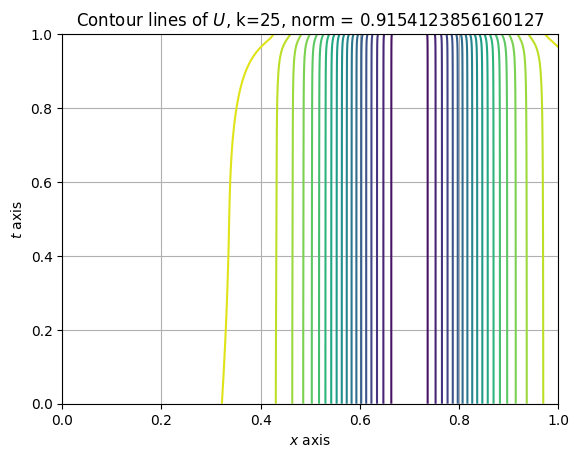

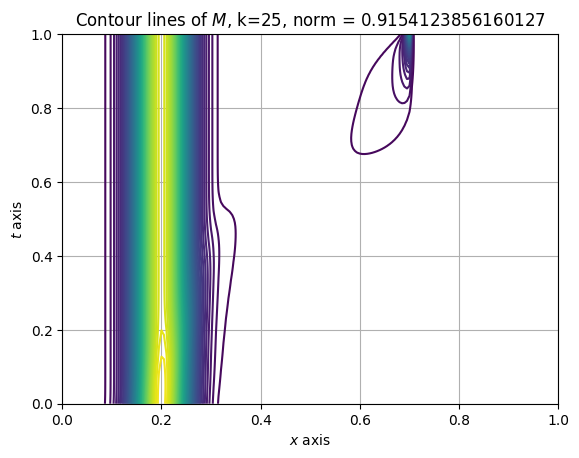

[Fixed Point] Iteration 25, previous norm: 0.9154123856160127, theta: 0.002, elapsed time: 13.554996490478516
[Fixed Point] Iteration 26, previous norm: 0.9127794368326461, theta: 0.002, elapsed time: 14.992818117141724
[Fixed Point] Iteration 27, previous norm: 0.9101773833382024, theta: 0.002, elapsed time: 16.100075006484985
[Fixed Point] Iteration 28, previous norm: 0.9076035583797656, theta: 0.002, elapsed time: 16.507952451705933
[Fixed Point] Iteration 29, previous norm: 0.9050556428296522, theta: 0.002, elapsed time: 16.902459621429443
[Fixed Point] Iteration 30, previous norm: 0.9025316146170244, theta: 0.002, elapsed time: 17.34689164161682
[Fixed Point] Iteration 31, previous norm: 0.9000297064660475, theta: 0.002, elapsed time: 17.75010657310486
[Fixed Point] Iteration 32, previous norm: 0.897548370372529, theta: 0.002, elapsed time: 18.174599409103394
[Fixed Point] Iteration 33, previous norm: 0.8950862475974154, theta: 0.002, elapsed time: 18.578491687774658
[Fixed Point]

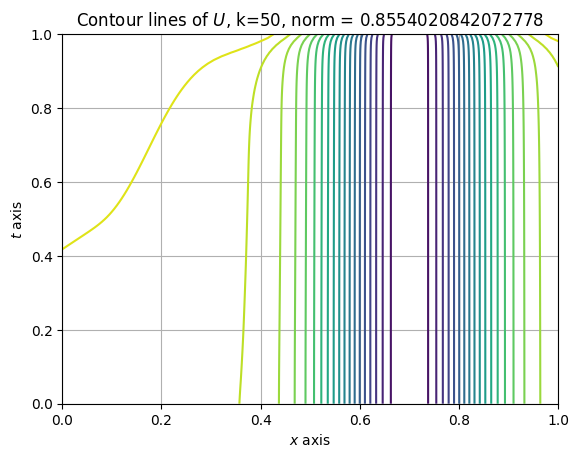

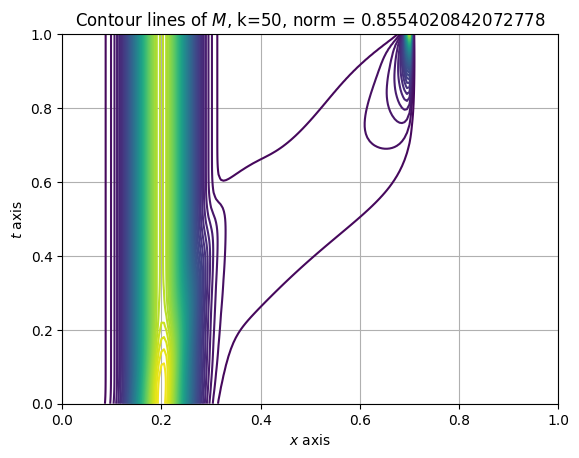

[Fixed Point] Iteration 50, previous norm: 0.8554020842072778, theta: 0.002, elapsed time: 26.0948703289032
[Fixed Point] Iteration 51, previous norm: 0.8531695128253044, theta: 0.002, elapsed time: 27.670772790908813
[Fixed Point] Iteration 52, previous norm: 0.850946621576962, theta: 0.002, elapsed time: 28.667755603790283
[Fixed Point] Iteration 53, previous norm: 0.848733266303925, theta: 0.002, elapsed time: 29.43862819671631
[Fixed Point] Iteration 54, previous norm: 0.8465293153906713, theta: 0.002, elapsed time: 29.870271921157837
[Fixed Point] Iteration 55, previous norm: 0.8443346483346693, theta: 0.002, elapsed time: 30.26215648651123
[Fixed Point] Iteration 56, previous norm: 0.8421491384318989, theta: 0.002, elapsed time: 30.711539030075073
[Fixed Point] Iteration 57, previous norm: 0.8399726977815173, theta: 0.002, elapsed time: 31.118168592453003
[Fixed Point] Iteration 58, previous norm: 0.8378052336994398, theta: 0.002, elapsed time: 31.52830672264099
[Fixed Point] Ite

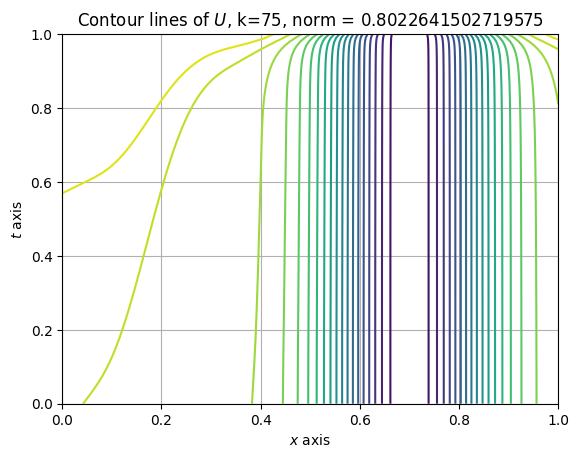

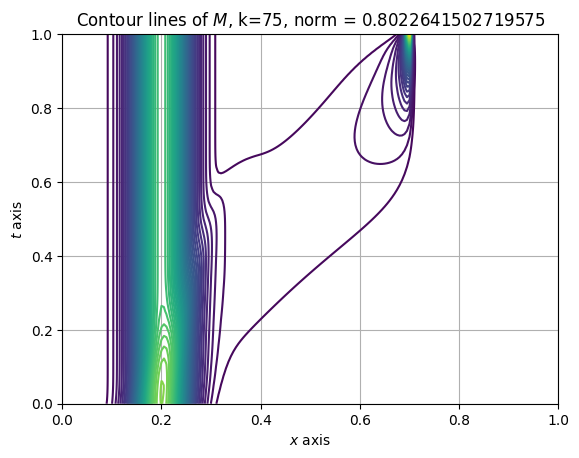

[Fixed Point] Iteration 75, previous norm: 0.8022641502719575, theta: 0.002, elapsed time: 39.09355187416077
[Fixed Point] Iteration 76, previous norm: 0.8002472052666134, theta: 0.002, elapsed time: 40.26875424385071
[Fixed Point] Iteration 77, previous norm: 0.7982381614701096, theta: 0.002, elapsed time: 41.49244475364685
[Fixed Point] Iteration 78, previous norm: 0.7962369780367097, theta: 0.002, elapsed time: 42.536165952682495
[Fixed Point] Iteration 79, previous norm: 0.794243614585612, theta: 0.002, elapsed time: 42.99202799797058
[Fixed Point] Iteration 80, previous norm: 0.7922580311299195, theta: 0.002, elapsed time: 43.44258975982666
[Fixed Point] Iteration 81, previous norm: 0.7902801880142615, theta: 0.002, elapsed time: 43.86953830718994
[Fixed Point] Iteration 82, previous norm: 0.7883100458602621, theta: 0.002, elapsed time: 44.305930852890015
[Fixed Point] Iteration 83, previous norm: 0.7863475655187914, theta: 0.002, elapsed time: 44.74573516845703
[Fixed Point] Iter

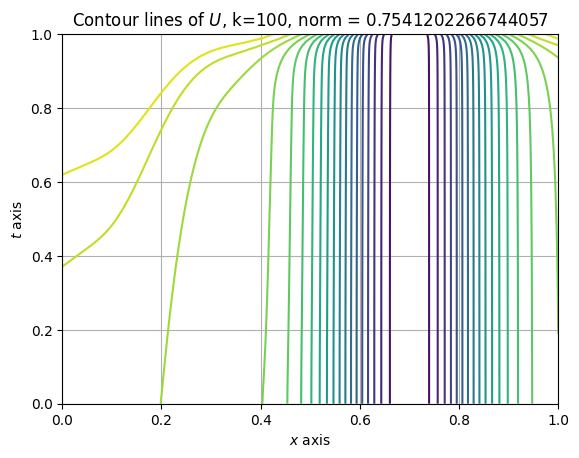

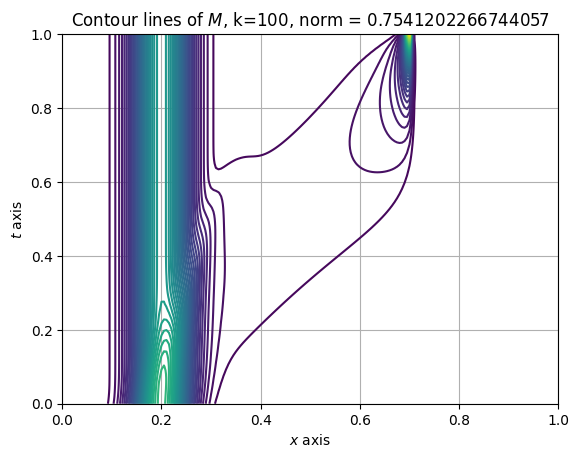

[Fixed Point] Iteration 100, previous norm: 0.7541202266744057, theta: 0.002, elapsed time: 52.65081572532654
[Fixed Point] Iteration 101, previous norm: 0.7522890597818003, theta: 0.002, elapsed time: 54.11275911331177
[Fixed Point] Iteration 102, previous norm: 0.7504648230992701, theta: 0.002, elapsed time: 55.24129056930542
[Fixed Point] Iteration 103, previous norm: 0.7486474780887302, theta: 0.002, elapsed time: 55.87177395820618
[Fixed Point] Iteration 104, previous norm: 0.7468369862053827, theta: 0.002, elapsed time: 56.278544425964355
[Fixed Point] Iteration 105, previous norm: 0.7450333089013587, theta: 0.002, elapsed time: 56.69612216949463
[Fixed Point] Iteration 106, previous norm: 0.7432364076297288, theta: 0.002, elapsed time: 57.1439995765686
[Fixed Point] Iteration 107, previous norm: 0.7414462438488456, theta: 0.002, elapsed time: 57.58494234085083
[Fixed Point] Iteration 108, previous norm: 0.7396627790269051, theta: 0.002, elapsed time: 58.04194951057434
[Fixed Poi

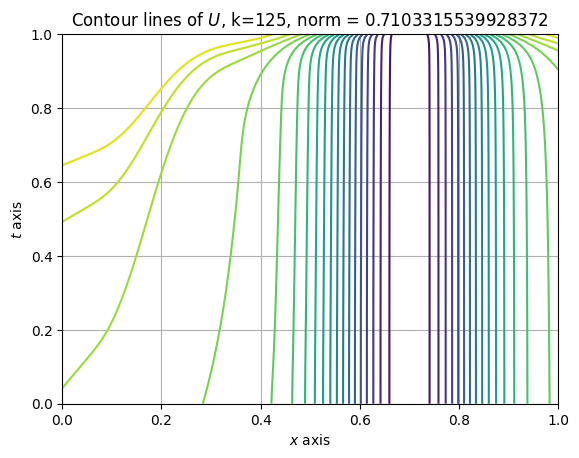

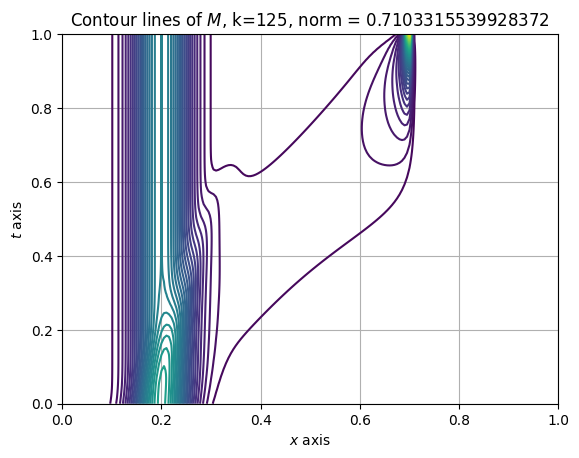

[Fixed Point] Iteration 125, previous norm: 0.7103315539928372, theta: 0.002, elapsed time: 66.17557430267334
[Fixed Point] Iteration 126, previous norm: 0.7086620772200255, theta: 0.002, elapsed time: 67.69028282165527
[Fixed Point] Iteration 127, previous norm: 0.7069985765009696, theta: 0.002, elapsed time: 68.81173133850098
[Fixed Point] Iteration 128, previous norm: 0.7053410145474409, theta: 0.002, elapsed time: 69.25876665115356
[Fixed Point] Iteration 129, previous norm: 0.7036893541840699, theta: 0.002, elapsed time: 69.69632840156555
[Fixed Point] Iteration 130, previous norm: 0.7020435583524332, theta: 0.002, elapsed time: 70.12870597839355
[Fixed Point] Iteration 131, previous norm: 0.700403590114986, theta: 0.002, elapsed time: 70.58359813690186
[Fixed Point] Iteration 132, previous norm: 0.6987694126589473, theta: 0.002, elapsed time: 71.08007097244263
[Fixed Point] Iteration 133, previous norm: 0.6971409892999914, theta: 0.002, elapsed time: 71.58640241622925
[Fixed Poin

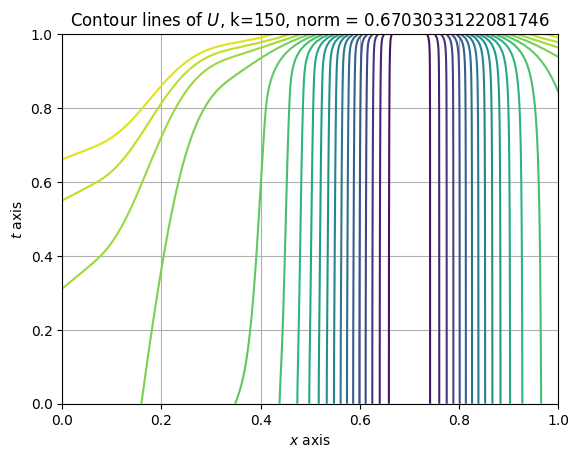

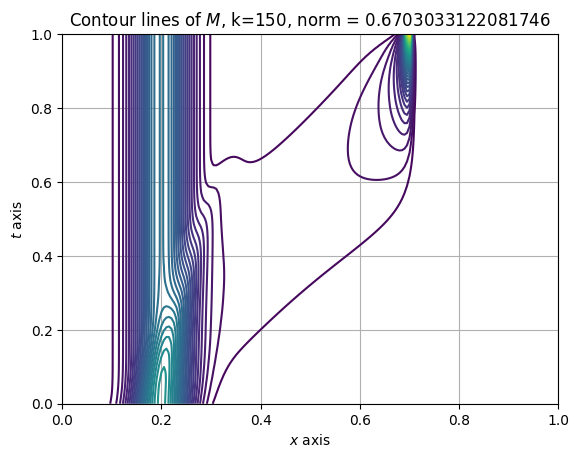

[Fixed Point] Iteration 150, previous norm: 0.6703033122081746, theta: 0.002, elapsed time: 80.42645454406738
[Fixed Point] Iteration 151, previous norm: 0.668772355517419, theta: 0.002, elapsed time: 81.56477355957031
[Fixed Point] Iteration 152, previous norm: 0.6672464845085955, theta: 0.002, elapsed time: 82.17495632171631
[Fixed Point] Iteration 153, previous norm: 0.665725665687469, theta: 0.002, elapsed time: 82.59111380577087
[Fixed Point] Iteration 154, previous norm: 0.6642098657429288, theta: 0.002, elapsed time: 83.05371236801147
[Fixed Point] Iteration 155, previous norm: 0.6626990515485507, theta: 0.002, elapsed time: 83.47493696212769
[Fixed Point] Iteration 156, previous norm: 0.6611931901641763, theta: 0.002, elapsed time: 83.92322874069214
[Fixed Point] Iteration 157, previous norm: 0.6596922485259367, theta: 0.002, elapsed time: 84.3481879234314
[Fixed Point] Iteration 158, previous norm: 0.6581961929322356, theta: 0.002, elapsed time: 84.76992273330688
[Fixed Point]

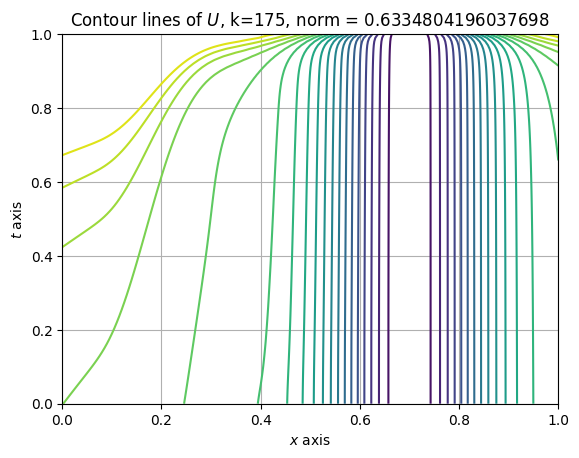

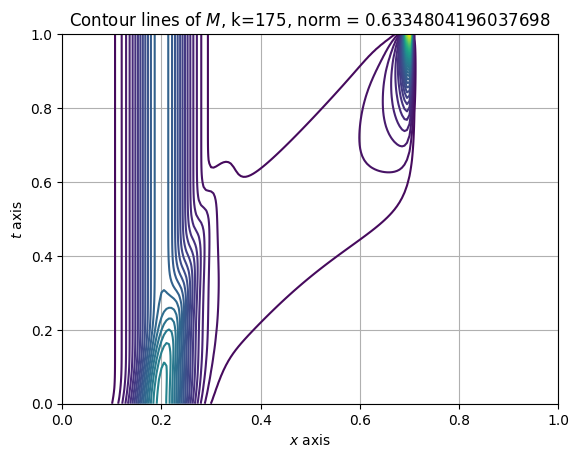

[Fixed Point] Iteration 175, previous norm: 0.6334804196037698, theta: 0.002, elapsed time: 94.38689517974854
[Fixed Point] Iteration 176, previous norm: 0.6320669928164798, theta: 0.002, elapsed time: 95.1586058139801
[Fixed Point] Iteration 177, previous norm: 0.6306578721619245, theta: 0.002, elapsed time: 95.61251616477966
[Fixed Point] Iteration 178, previous norm: 0.629253029060072, theta: 0.002, elapsed time: 96.10415697097778
[Fixed Point] Iteration 179, previous norm: 0.6278524351359533, theta: 0.002, elapsed time: 96.60035681724548
[Fixed Point] Iteration 180, previous norm: 0.6264560622198894, theta: 0.002, elapsed time: 97.03136873245239
[Fixed Point] Iteration 181, previous norm: 0.6250638823477203, theta: 0.002, elapsed time: 97.48935317993164
[Fixed Point] Iteration 182, previous norm: 0.623675867760918, theta: 0.002, elapsed time: 97.97021389007568
[Fixed Point] Iteration 183, previous norm: 0.622291990906732, theta: 0.002, elapsed time: 98.40861129760742
[Fixed Point] 

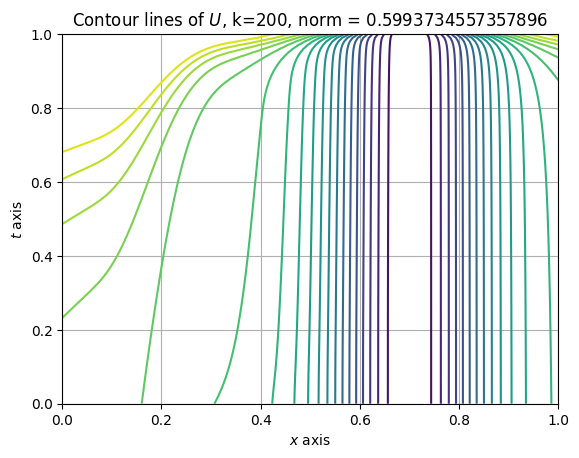

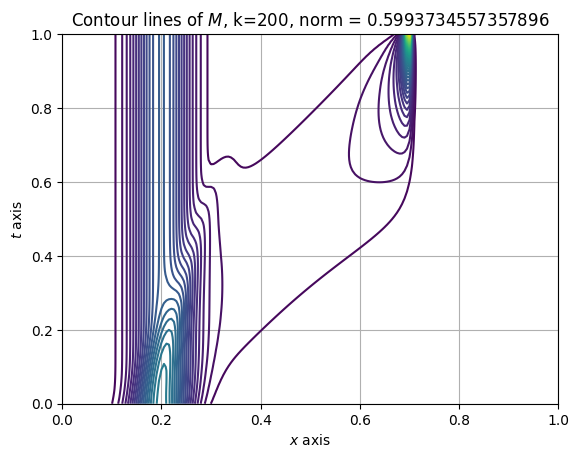

[Fixed Point] Iteration 200, previous norm: 0.5993734557357896, theta: 0.002, elapsed time: 108.73526954650879
[Fixed Point] Iteration 201, previous norm: 0.5980595809617819, theta: 0.002, elapsed time: 109.24879741668701
[Fixed Point] Iteration 202, previous norm: 0.5967493594323493, theta: 0.002, elapsed time: 109.71280860900879
[Fixed Point] Iteration 203, previous norm: 0.5954427676856462, theta: 0.002, elapsed time: 110.20249557495117
[Fixed Point] Iteration 204, previous norm: 0.59413978246096, theta: 0.002, elapsed time: 110.65564966201782
[Fixed Point] Iteration 205, previous norm: 0.5928403806982085, theta: 0.002, elapsed time: 111.21039891242981
[Fixed Point] Iteration 206, previous norm: 0.5915445395374146, theta: 0.002, elapsed time: 111.66287636756897
[Fixed Point] Iteration 207, previous norm: 0.5902522363181678, theta: 0.002, elapsed time: 112.13131260871887
[Fixed Point] Iteration 208, previous norm: 0.5889634485790262, theta: 0.002, elapsed time: 112.60000991821289
[Fi

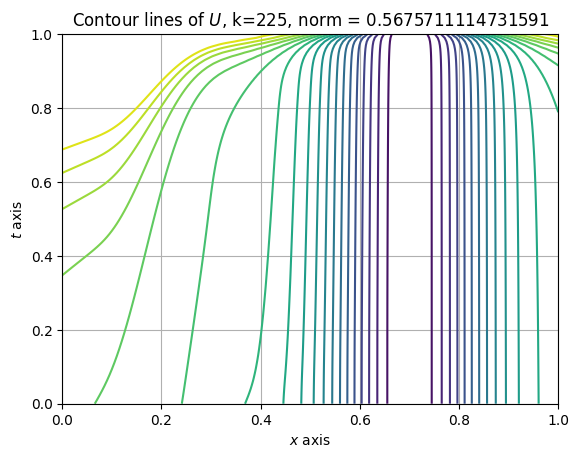

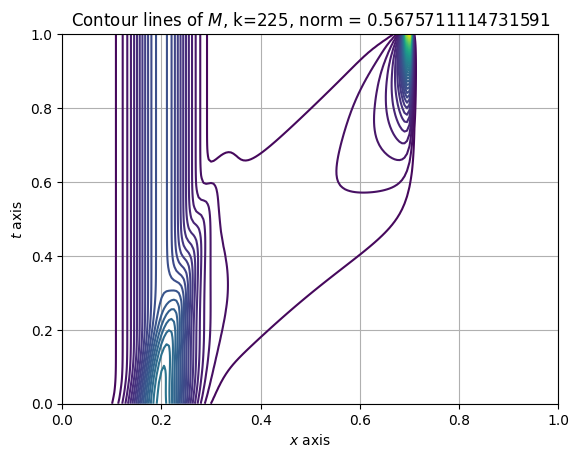

[Fixed Point] Iteration 225, previous norm: 0.5675711114731591, theta: 0.002, elapsed time: 123.0681676864624
[Fixed Point] Iteration 226, previous norm: 0.5663419844270957, theta: 0.002, elapsed time: 123.56303882598877
[Fixed Point] Iteration 227, previous norm: 0.5651159830123, theta: 0.002, elapsed time: 124.01948571205139
[Fixed Point] Iteration 228, previous norm: 0.5638930886003838, theta: 0.002, elapsed time: 124.4530336856842
[Fixed Point] Iteration 229, previous norm: 0.5626732827460978, theta: 0.002, elapsed time: 124.91728162765503
[Fixed Point] Iteration 230, previous norm: 0.5614565471864199, theta: 0.002, elapsed time: 125.36765503883362
[Fixed Point] Iteration 231, previous norm: 0.5602428638396274, theta: 0.002, elapsed time: 125.82888960838318
[Fixed Point] Iteration 232, previous norm: 0.5590322148043205, theta: 0.002, elapsed time: 126.34937238693237
[Fixed Point] Iteration 233, previous norm: 0.5578245823586401, theta: 0.002, elapsed time: 126.84342813491821
[Fixed

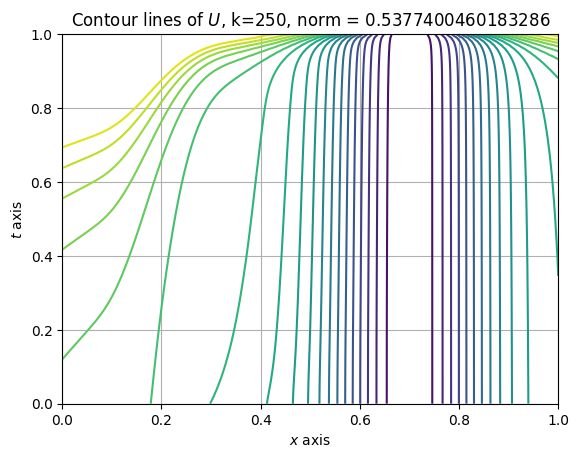

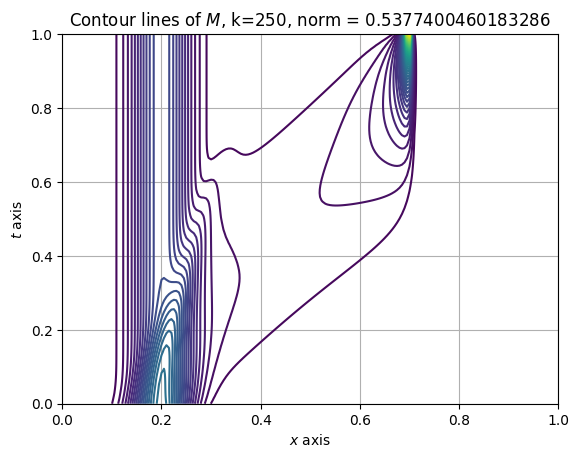

[Fixed Point] Iteration 250, previous norm: 0.5377400460183286, theta: 0.002, elapsed time: 137.09251499176025
[Fixed Point] Iteration 251, previous norm: 0.5365838804324389, theta: 0.002, elapsed time: 137.61300945281982
[Fixed Point] Iteration 252, previous norm: 0.5354304274980123, theta: 0.002, elapsed time: 138.08141207695007
[Fixed Point] Iteration 253, previous norm: 0.5342796728713975, theta: 0.002, elapsed time: 138.55213379859924
[Fixed Point] Iteration 254, previous norm: 0.5331316023668189, theta: 0.002, elapsed time: 139.00443696975708
[Fixed Point] Iteration 255, previous norm: 0.5319862019552584, theta: 0.002, elapsed time: 139.4716124534607
[Fixed Point] Iteration 256, previous norm: 0.5308434577630309, theta: 0.002, elapsed time: 139.92019248008728
[Fixed Point] Iteration 257, previous norm: 0.5297033560717224, theta: 0.002, elapsed time: 140.39555764198303
[Fixed Point] Iteration 258, previous norm: 0.5285658833161314, theta: 0.002, elapsed time: 140.84794974327087
[F

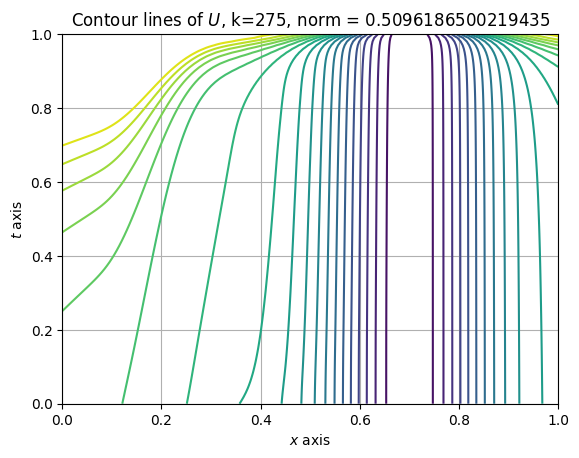

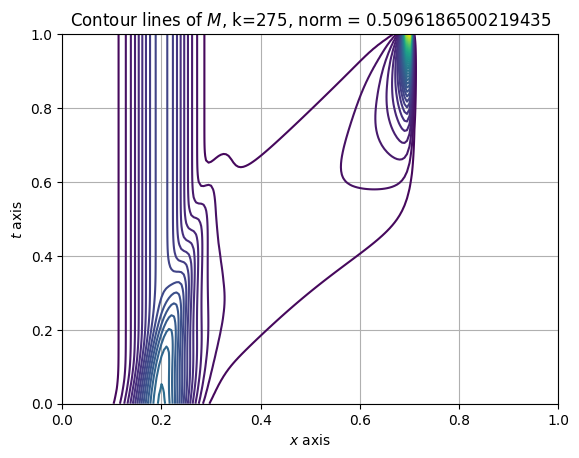

[Fixed Point] Iteration 275, previous norm: 0.5096186500219435, theta: 0.002, elapsed time: 151.3095998764038
[Fixed Point] Iteration 276, previous norm: 0.5085263467920323, theta: 0.002, elapsed time: 151.83638453483582
[Fixed Point] Iteration 277, previous norm: 0.5074364424443167, theta: 0.002, elapsed time: 152.27877926826477
[Fixed Point] Iteration 278, previous norm: 0.5063489262497987, theta: 0.002, elapsed time: 152.74993586540222
[Fixed Point] Iteration 279, previous norm: 0.5052637876095639, theta: 0.002, elapsed time: 153.3117127418518
[Fixed Point] Iteration 280, previous norm: 0.5041810160536945, theta: 0.002, elapsed time: 153.7723503112793
[Fixed Point] Iteration 281, previous norm: 0.503100601240147, theta: 0.002, elapsed time: 154.23587918281555
[Fixed Point] Iteration 282, previous norm: 0.5020225329536493, theta: 0.002, elapsed time: 154.6779637336731
[Fixed Point] Iteration 283, previous norm: 0.5009468011046099, theta: 0.002, elapsed time: 155.20245814323425
[Fixed

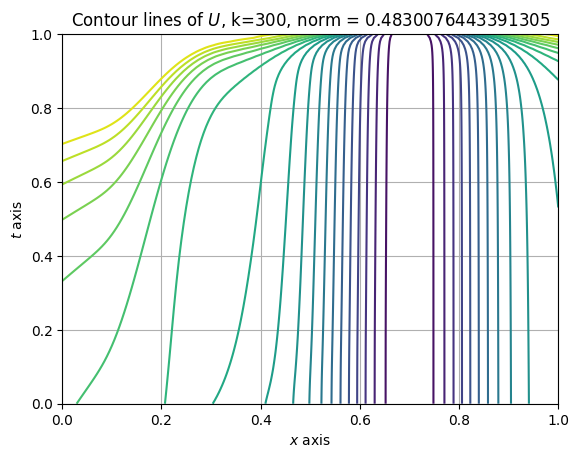

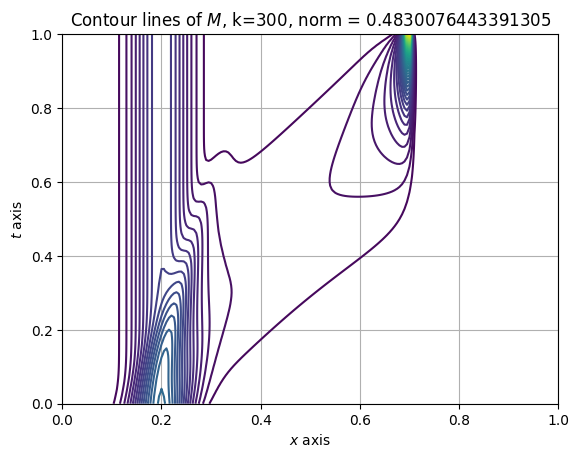

[Fixed Point] Iteration 300, previous norm: 0.4830076443391305, theta: 0.002, elapsed time: 165.91292190551758
[Fixed Point] Iteration 301, previous norm: 0.48197237976246776, theta: 0.002, elapsed time: 166.45237684249878
[Fixed Point] Iteration 302, previous norm: 0.48093928234936223, theta: 0.002, elapsed time: 166.93850016593933
[Fixed Point] Iteration 303, previous norm: 0.4799083442962341, theta: 0.002, elapsed time: 167.36662483215332
[Fixed Point] Iteration 304, previous norm: 0.4788795579027111, theta: 0.002, elapsed time: 167.8447606563568
[Fixed Point] Iteration 305, previous norm: 0.4778529155706253, theta: 0.002, elapsed time: 168.31784868240356
[Fixed Point] Iteration 306, previous norm: 0.47682840980300406, theta: 0.002, elapsed time: 168.78187799453735
[Fixed Point] Iteration 307, previous norm: 0.47580603320304676, theta: 0.002, elapsed time: 169.2457389831543
[Fixed Point] Iteration 308, previous norm: 0.47478577847312087, theta: 0.002, elapsed time: 169.7225637435913

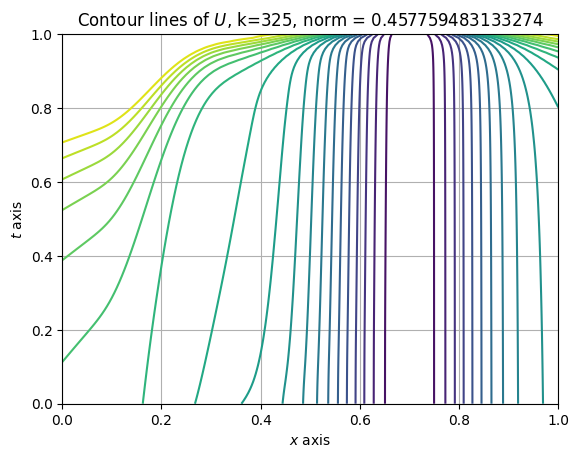

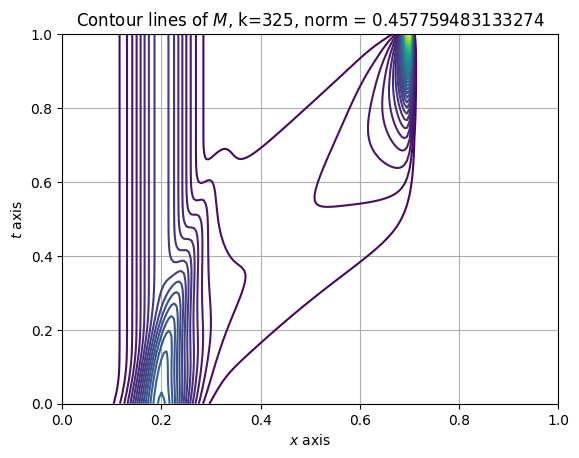

[Fixed Point] Iteration 325, previous norm: 0.457759483133274, theta: 0.002, elapsed time: 180.31023788452148
[Fixed Point] Iteration 326, previous norm: 0.45677628133910947, theta: 0.002, elapsed time: 180.83088207244873
[Fixed Point] Iteration 327, previous norm: 0.45579508030463706, theta: 0.002, elapsed time: 181.37252497673035
[Fixed Point] Iteration 328, previous norm: 0.4548158745130818, theta: 0.002, elapsed time: 181.83529567718506
[Fixed Point] Iteration 329, previous norm: 0.4538386585270575, theta: 0.002, elapsed time: 182.29154920578003
[Fixed Point] Iteration 330, previous norm: 0.45286342698769105, theta: 0.002, elapsed time: 182.7361137866974
[Fixed Point] Iteration 331, previous norm: 0.45189017461376574, theta: 0.002, elapsed time: 183.2055642604828
[Fixed Point] Iteration 332, previous norm: 0.4509188962008522, theta: 0.002, elapsed time: 183.69482517242432
[Fixed Point] Iteration 333, previous norm: 0.44994958662047224, theta: 0.002, elapsed time: 184.21754121780396

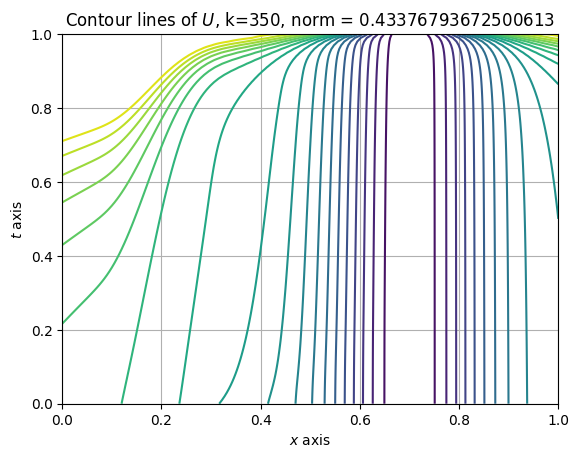

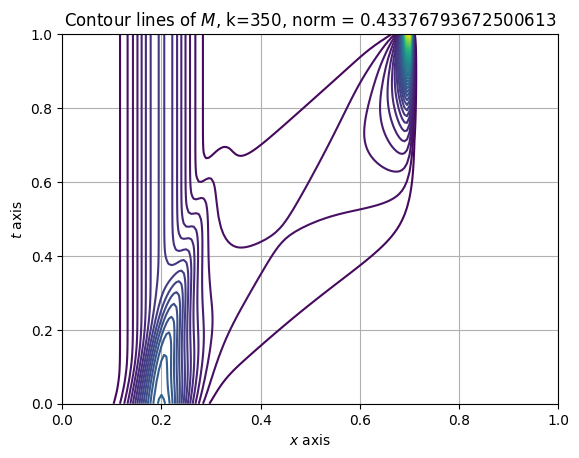

[Fixed Point] Iteration 350, previous norm: 0.43376793672500613, theta: 0.002, elapsed time: 194.6439871788025
[Fixed Point] Iteration 351, previous norm: 0.4328332708027798, theta: 0.002, elapsed time: 195.18129920959473
[Fixed Point] Iteration 352, previous norm: 0.43190048961697614, theta: 0.002, elapsed time: 195.69173073768616
[Fixed Point] Iteration 353, previous norm: 0.4309695893894925, theta: 0.002, elapsed time: 196.14482951164246
[Fixed Point] Iteration 354, previous norm: 0.4300405664018602, theta: 0.002, elapsed time: 196.6099488735199
[Fixed Point] Iteration 355, previous norm: 0.42911341699452654, theta: 0.002, elapsed time: 197.08094191551208
[Fixed Point] Iteration 356, previous norm: 0.4281881375661801, theta: 0.002, elapsed time: 198.0026524066925
[Fixed Point] Iteration 357, previous norm: 0.4272647245730626, theta: 0.002, elapsed time: 199.41813278198242
[Fixed Point] Iteration 358, previous norm: 0.4263431745282795, theta: 0.002, elapsed time: 200.59174847602844
[

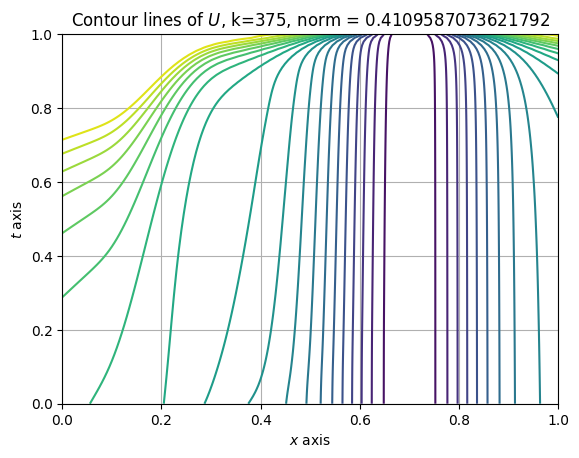

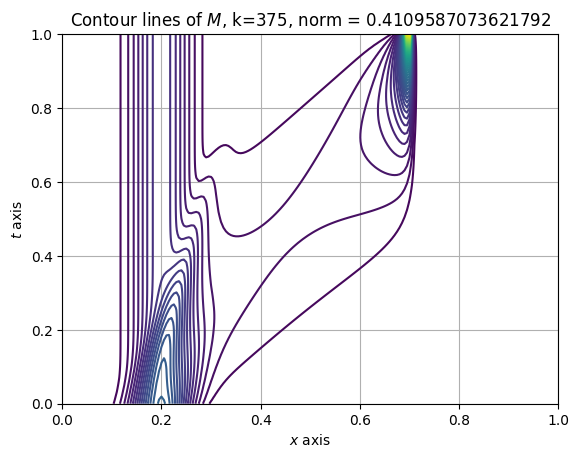

[Fixed Point] Iteration 375, previous norm: 0.4109587073621792, theta: 0.002, elapsed time: 209.6159167289734
[Fixed Point] Iteration 376, previous norm: 0.41007014847953566, theta: 0.002, elapsed time: 210.14064741134644
[Fixed Point] Iteration 377, previous norm: 0.4091833962996012, theta: 0.002, elapsed time: 210.75176525115967
[Fixed Point] Iteration 378, previous norm: 0.4082984483398045, theta: 0.002, elapsed time: 212.09355974197388
[Fixed Point] Iteration 379, previous norm: 0.4074153021617006, theta: 0.002, elapsed time: 213.14409756660461
[Fixed Point] Iteration 380, previous norm: 0.40653395537045145, theta: 0.002, elapsed time: 214.0090253353119
[Fixed Point] Iteration 381, previous norm: 0.40565440561430605, theta: 0.002, elapsed time: 214.46647119522095
[Fixed Point] Iteration 382, previous norm: 0.4047766505840427, theta: 0.002, elapsed time: 214.98050570487976
[Fixed Point] Iteration 383, previous norm: 0.40390068801249823, theta: 0.002, elapsed time: 215.43547320365906

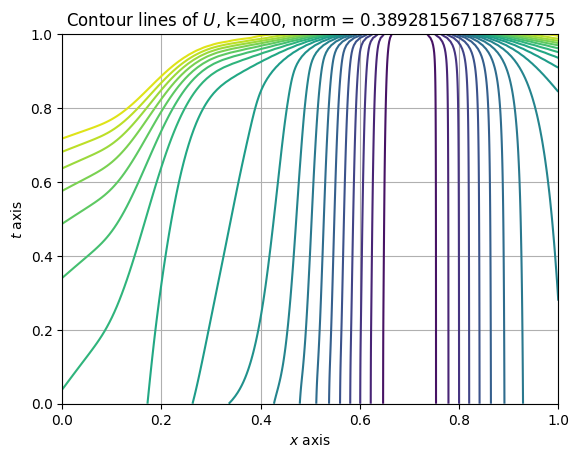

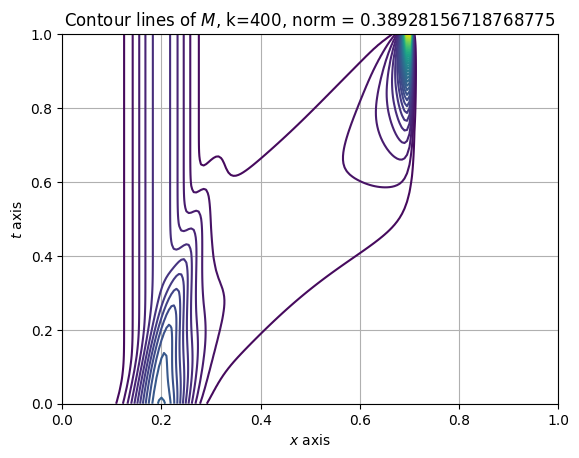

[Fixed Point] Iteration 400, previous norm: 0.38928156718768775, theta: 0.002, elapsed time: 224.26283717155457
[Fixed Point] Iteration 401, previous norm: 0.38843752616309746, theta: 0.002, elapsed time: 225.51260805130005
[Fixed Point] Iteration 402, previous norm: 0.38759524186453426, theta: 0.002, elapsed time: 226.878253698349
[Fixed Point] Iteration 403, previous norm: 0.3867547127662045, theta: 0.002, elapsed time: 227.4642252922058
[Fixed Point] Iteration 404, previous norm: 0.3859159373748506, theta: 0.002, elapsed time: 227.9272313117981
[Fixed Point] Iteration 405, previous norm: 0.3850789142293538, theta: 0.002, elapsed time: 228.39922881126404
[Fixed Point] Iteration 406, previous norm: 0.38424364190035387, theta: 0.002, elapsed time: 228.86363983154297
[Fixed Point] Iteration 407, previous norm: 0.3834101189898671, theta: 0.002, elapsed time: 229.34331846237183
[Fixed Point] Iteration 408, previous norm: 0.38257834413089925, theta: 0.002, elapsed time: 229.81480741500854


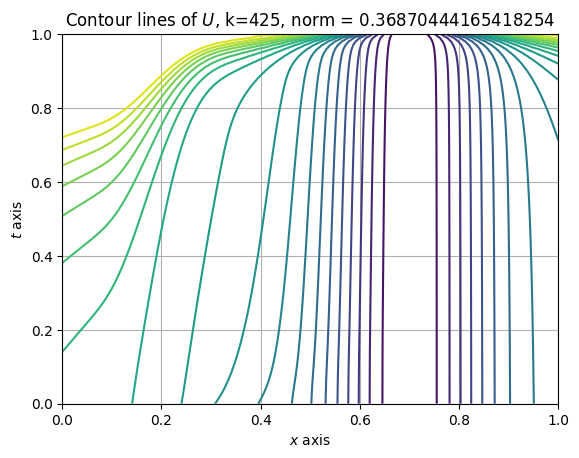

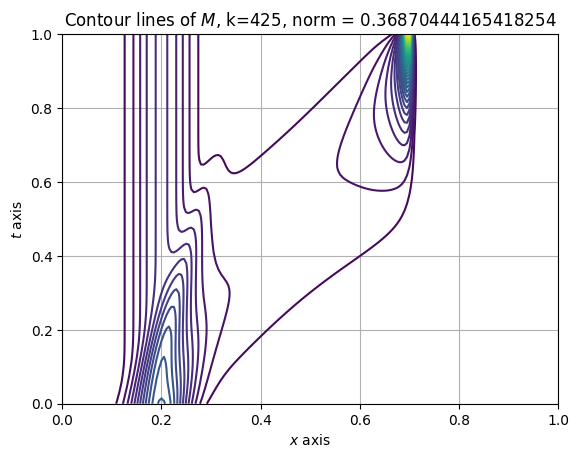

[Fixed Point] Iteration 425, previous norm: 0.36870444165418254, theta: 0.002, elapsed time: 240.18929362297058
[Fixed Point] Iteration 426, previous norm: 0.36790393116971976, theta: 0.002, elapsed time: 240.76293063163757
[Fixed Point] Iteration 427, previous norm: 0.36710514818573936, theta: 0.002, elapsed time: 241.29272174835205
[Fixed Point] Iteration 428, previous norm: 0.36630809188304875, theta: 0.002, elapsed time: 241.78854846954346
[Fixed Point] Iteration 429, previous norm: 0.36551276146657485, theta: 0.002, elapsed time: 242.2488739490509
[Fixed Point] Iteration 430, previous norm: 0.36471915616507344, theta: 0.002, elapsed time: 242.7235713005066
[Fixed Point] Iteration 431, previous norm: 0.3639272752308469, theta: 0.002, elapsed time: 243.16578459739685
[Fixed Point] Iteration 432, previous norm: 0.36313711793947684, theta: 0.002, elapsed time: 243.63690662384033
[Fixed Point] Iteration 433, previous norm: 0.36234868358954253, theta: 0.002, elapsed time: 244.1401991844

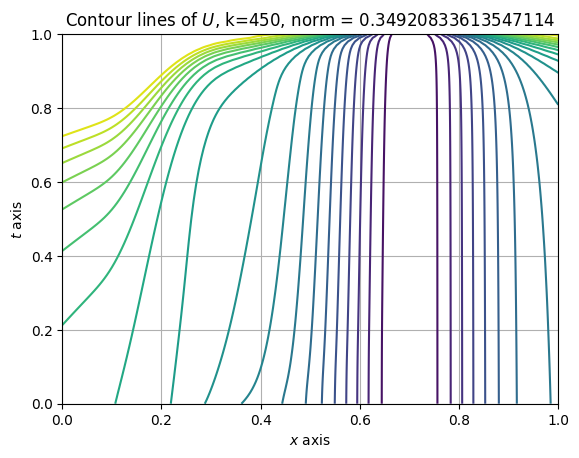

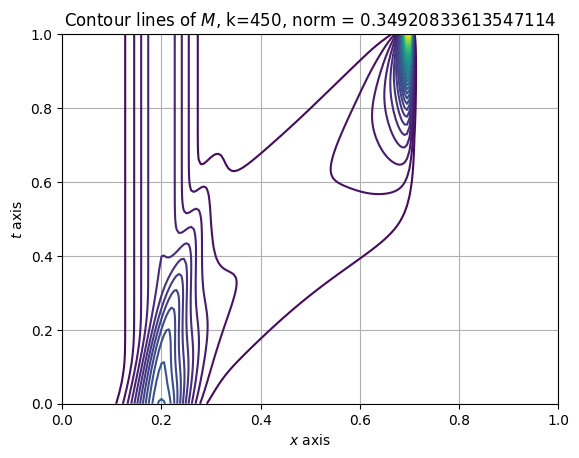

[Fixed Point] Iteration 450, previous norm: 0.34920833613547114, theta: 0.002, elapsed time: 255.13201570510864
[Fixed Point] Iteration 451, previous norm: 0.3484508194613862, theta: 0.002, elapsed time: 255.71280574798584
[Fixed Point] Iteration 452, previous norm: 0.34769501643213563, theta: 0.002, elapsed time: 256.21755814552307
[Fixed Point] Iteration 453, previous norm: 0.34694092675374755, theta: 0.002, elapsed time: 256.71663427352905
[Fixed Point] Iteration 454, previous norm: 0.3461885501501995, theta: 0.002, elapsed time: 257.2607023715973
[Fixed Point] Iteration 455, previous norm: 0.34543788601371644, theta: 0.002, elapsed time: 257.7857220172882
[Fixed Point] Iteration 456, previous norm: 0.34468893423114544, theta: 0.002, elapsed time: 258.27622723579407
[Fixed Point] Iteration 457, previous norm: 0.3439416948036088, theta: 0.002, elapsed time: 258.77721643447876
[Fixed Point] Iteration 458, previous norm: 0.34319616752473453, theta: 0.002, elapsed time: 259.328734636306

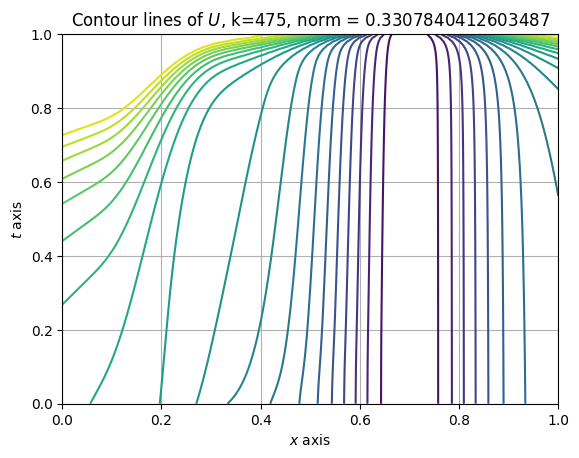

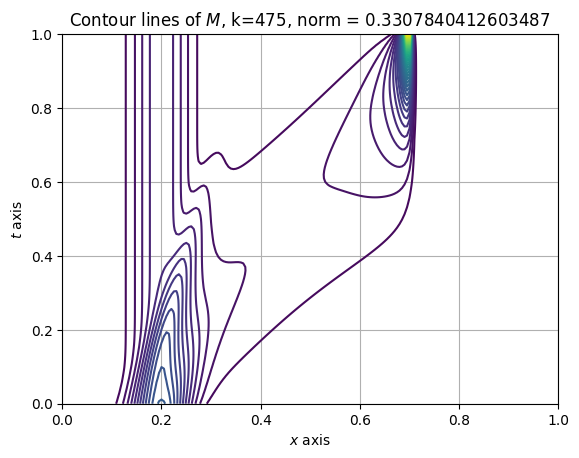

[Fixed Point] Iteration 475, previous norm: 0.3307840412603487, theta: 0.002, elapsed time: 270.468487739563
[Fixed Point] Iteration 476, previous norm: 0.33006931564884123, theta: 0.002, elapsed time: 271.0700464248657
[Fixed Point] Iteration 477, previous norm: 0.3293563012460666, theta: 0.002, elapsed time: 271.5359501838684
[Fixed Point] Iteration 478, previous norm: 0.32864499814574893, theta: 0.002, elapsed time: 272.0682735443115
[Fixed Point] Iteration 479, previous norm: 0.32793540645457897, theta: 0.002, elapsed time: 272.6017789840698
[Fixed Point] Iteration 480, previous norm: 0.3272275262920213, theta: 0.002, elapsed time: 273.12570333480835
[Fixed Point] Iteration 481, previous norm: 0.326521357790138, theta: 0.002, elapsed time: 273.57040762901306
[Fixed Point] Iteration 482, previous norm: 0.32581690109338773, theta: 0.002, elapsed time: 274.06145882606506
[Fixed Point] Iteration 483, previous norm: 0.32511415635091856, theta: 0.002, elapsed time: 274.5262801647186
[Fix

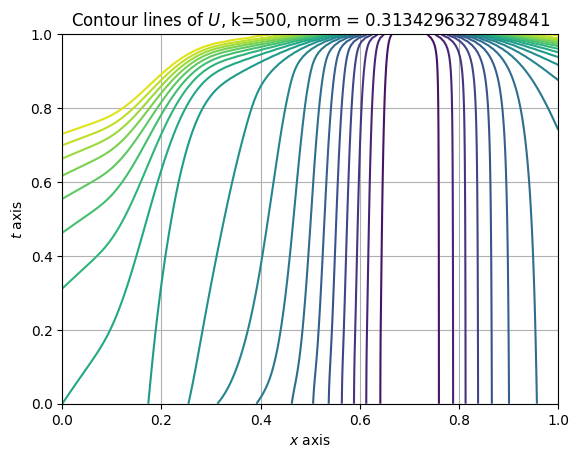

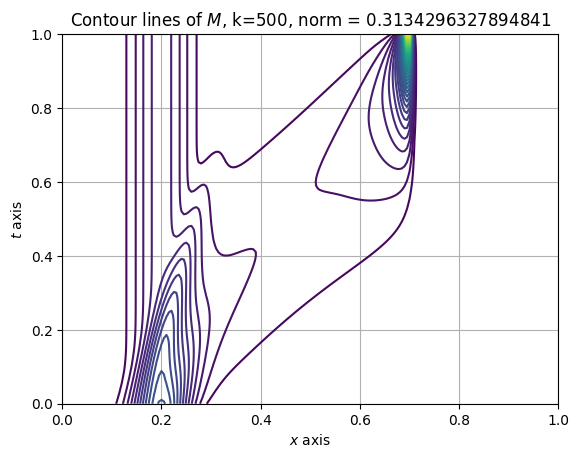

[Fixed Point] Iteration 500, previous norm: 0.3134296327894841, theta: 0.002, elapsed time: 285.3602674007416
[Fixed Point] Iteration 501, previous norm: 0.31275774289930847, theta: 0.002, elapsed time: 285.96048402786255
[Fixed Point] Iteration 502, previous norm: 0.31208757000810405, theta: 0.002, elapsed time: 286.45431756973267
[Fixed Point] Iteration 503, previous norm: 0.31141911447544474, theta: 0.002, elapsed time: 287.01264214515686
[Fixed Point] Iteration 504, previous norm: 0.31075237666889255, theta: 0.002, elapsed time: 287.4911165237427
[Fixed Point] Iteration 505, previous norm: 0.3100873569637832, theta: 0.002, elapsed time: 288.01831555366516
[Fixed Point] Iteration 506, previous norm: 0.30942405574301873, theta: 0.002, elapsed time: 288.4801495075226
[Fixed Point] Iteration 507, previous norm: 0.308762473396842, theta: 0.002, elapsed time: 289.00151324272156
[Fixed Point] Iteration 508, previous norm: 0.30810261032259983, theta: 0.002, elapsed time: 289.4813165664673


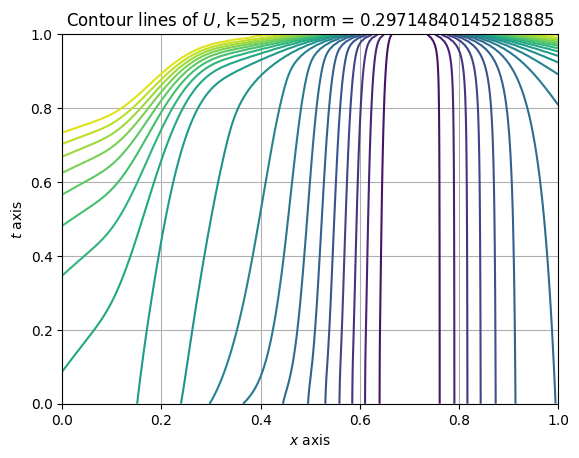

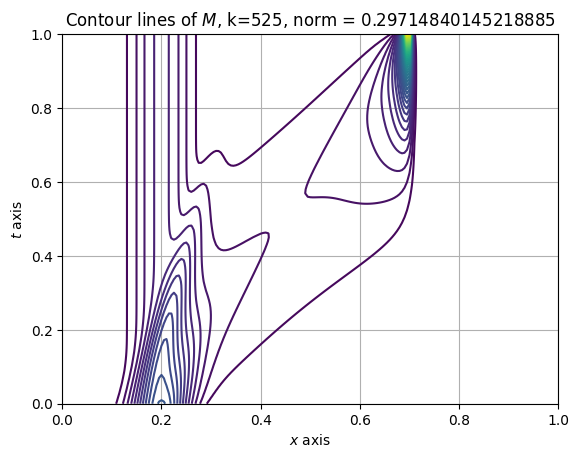

[Fixed Point] Iteration 525, previous norm: 0.29714840145218885, theta: 0.002, elapsed time: 300.51252126693726
[Fixed Point] Iteration 526, previous norm: 0.29651955993042317, theta: 0.002, elapsed time: 301.08811259269714
[Fixed Point] Iteration 527, previous norm: 0.29589244626672917, theta: 0.002, elapsed time: 301.6183559894562
[Fixed Point] Iteration 528, previous norm: 0.2952670609498293, theta: 0.002, elapsed time: 302.10402965545654
[Fixed Point] Iteration 529, previous norm: 0.29464340447023946, theta: 0.002, elapsed time: 302.6903085708618
[Fixed Point] Iteration 530, previous norm: 0.2940214773199563, theta: 0.002, elapsed time: 303.14720702171326
[Fixed Point] Iteration 531, previous norm: 0.293401279992191, theta: 0.002, elapsed time: 304.16310024261475
[Fixed Point] Iteration 532, previous norm: 0.292782812981049, theta: 0.002, elapsed time: 305.6661250591278
[Fixed Point] Iteration 533, previous norm: 0.29216607678123124, theta: 0.002, elapsed time: 306.8593261241913
[F

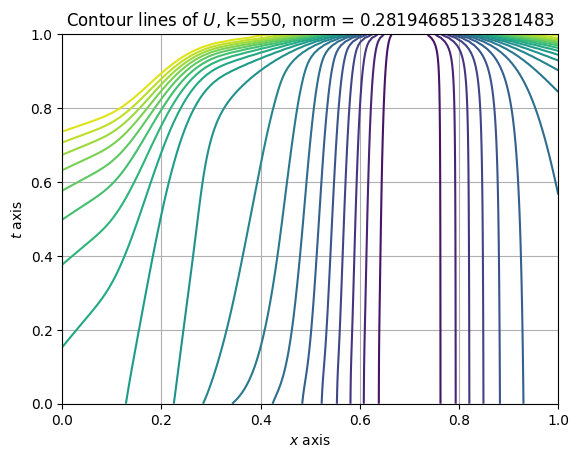

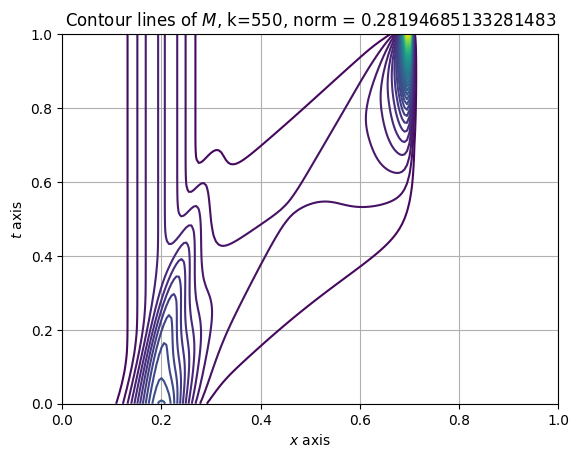

[Fixed Point] Iteration 550, previous norm: 0.28194685133281483, theta: 0.002, elapsed time: 315.92090940475464
[Fixed Point] Iteration 551, previous norm: 0.2813613530962994, theta: 0.002, elapsed time: 316.55426597595215
[Fixed Point] Iteration 552, previous norm: 0.2807775947516662, theta: 0.002, elapsed time: 317.32313418388367
[Fixed Point] Iteration 553, previous norm: 0.2801955767355821, theta: 0.002, elapsed time: 318.71679735183716
[Fixed Point] Iteration 554, previous norm: 0.2796152994779496, theta: 0.002, elapsed time: 319.8693161010742
[Fixed Point] Iteration 555, previous norm: 0.27903676340154027, theta: 0.002, elapsed time: 320.59373688697815
[Fixed Point] Iteration 556, previous norm: 0.27845996892154984, theta: 0.002, elapsed time: 321.067987203598
[Fixed Point] Iteration 557, previous norm: 0.27788491644521646, theta: 0.002, elapsed time: 321.6009769439697
[Fixed Point] Iteration 558, previous norm: 0.2773116063713893, theta: 0.002, elapsed time: 322.1013548374176
[F

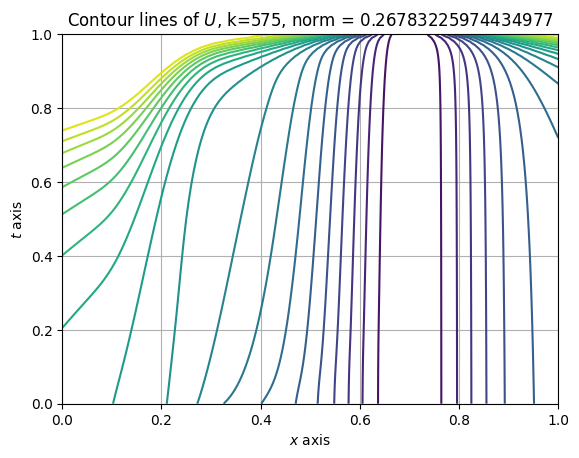

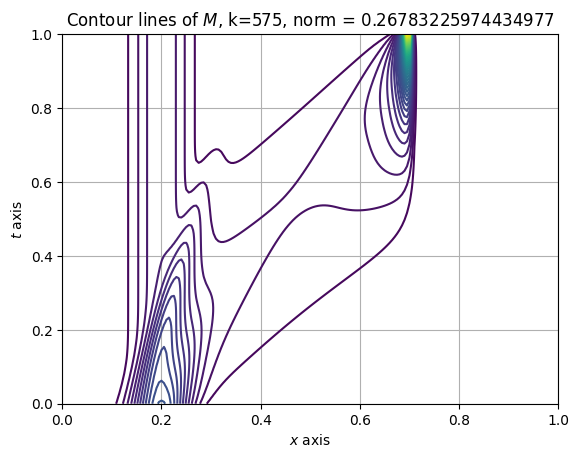

[Fixed Point] Iteration 575, previous norm: 0.26783225974434977, theta: 0.002, elapsed time: 332.88821148872375
[Fixed Point] Iteration 576, previous norm: 0.26729036894565456, theta: 0.002, elapsed time: 333.71633553504944
[Fixed Point] Iteration 577, previous norm: 0.26675022594634434, theta: 0.002, elapsed time: 334.2289528846741
[Fixed Point] Iteration 578, previous norm: 0.2662118308828547, theta: 0.002, elapsed time: 334.80438113212585
[Fixed Point] Iteration 579, previous norm: 0.26567518387339045, theta: 0.002, elapsed time: 335.2930133342743
[Fixed Point] Iteration 580, previous norm: 0.2651402850174137, theta: 0.002, elapsed time: 335.81053829193115
[Fixed Point] Iteration 581, previous norm: 0.26460713439512357, theta: 0.002, elapsed time: 336.31074357032776
[Fixed Point] Iteration 582, previous norm: 0.2640757320669256, theta: 0.002, elapsed time: 336.8314697742462
[Fixed Point] Iteration 583, previous norm: 0.2635460780728863, theta: 0.002, elapsed time: 337.3212625980377


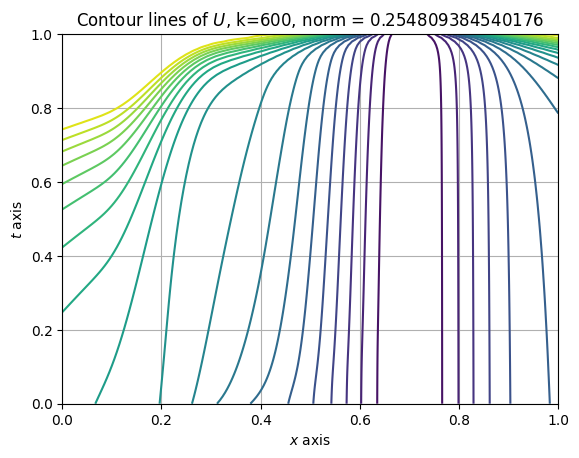

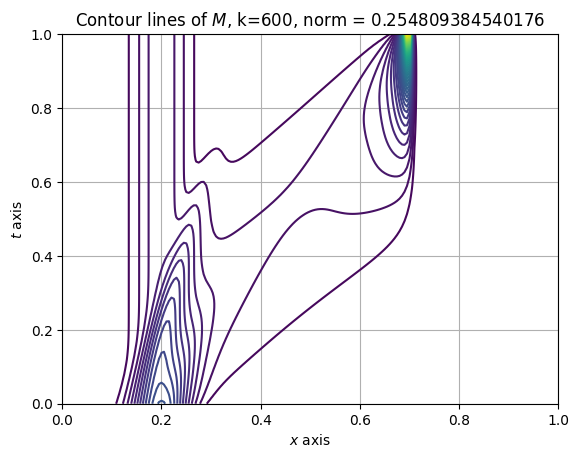

[Fixed Point] Iteration 600, previous norm: 0.254809384540176, theta: 0.002, elapsed time: 348.7010266780853
[Fixed Point] Iteration 601, previous norm: 0.2543111809575371, theta: 0.002, elapsed time: 349.30973267555237
[Fixed Point] Iteration 602, previous norm: 0.25381472187353943, theta: 0.002, elapsed time: 349.77499318122864
[Fixed Point] Iteration 603, previous norm: 0.2533200068044162, theta: 0.002, elapsed time: 350.2469849586487
[Fixed Point] Iteration 604, previous norm: 0.25282703523411454, theta: 0.002, elapsed time: 350.750009059906
[Fixed Point] Iteration 605, previous norm: 0.2523358066136926, theta: 0.002, elapsed time: 351.24037408828735
[Fixed Point] Iteration 606, previous norm: 0.2518463203607225, theta: 0.002, elapsed time: 351.7453167438507
[Fixed Point] Iteration 607, previous norm: 0.2513585758586909, theta: 0.002, elapsed time: 352.24703788757324
[Fixed Point] Iteration 608, previous norm: 0.25087257245639083, theta: 0.002, elapsed time: 352.83388566970825
[Fix

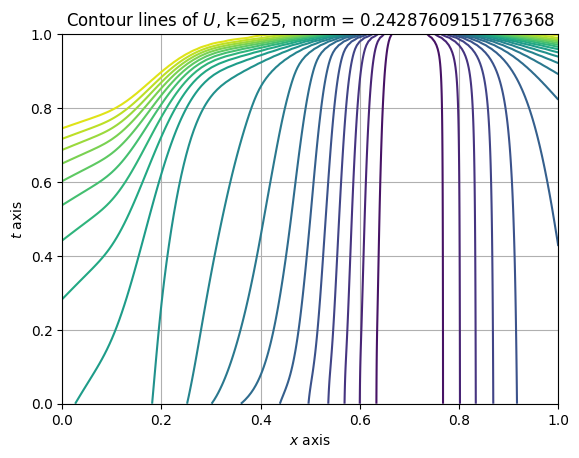

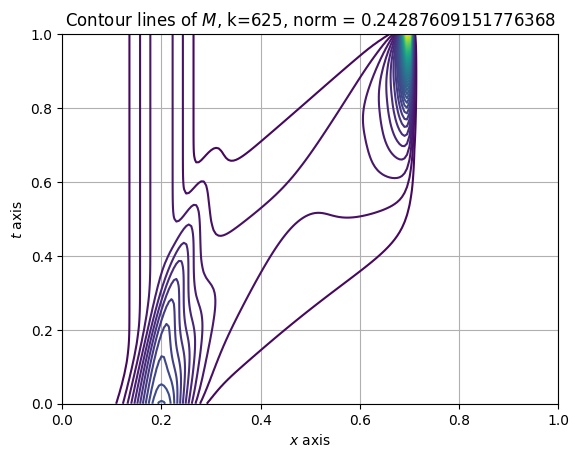

[Fixed Point] Iteration 625, previous norm: 0.24287609151776368, theta: 0.002, elapsed time: 363.8902201652527
[Fixed Point] Iteration 626, previous norm: 0.24242127339944902, theta: 0.002, elapsed time: 364.53684163093567
[Fixed Point] Iteration 627, previous norm: 0.24196817661528963, theta: 0.002, elapsed time: 365.0904417037964
[Fixed Point] Iteration 628, previous norm: 0.24151679969392062, theta: 0.002, elapsed time: 365.66741466522217
[Fixed Point] Iteration 629, previous norm: 0.2410671411167608, theta: 0.002, elapsed time: 366.20423674583435
[Fixed Point] Iteration 630, previous norm: 0.24061919931739628, theta: 0.002, elapsed time: 366.7058594226837
[Fixed Point] Iteration 631, previous norm: 0.24017297268103008, theta: 0.002, elapsed time: 367.2363784313202
[Fixed Point] Iteration 632, previous norm: 0.2397284595439002, theta: 0.002, elapsed time: 367.72018814086914
[Fixed Point] Iteration 633, previous norm: 0.23928565819273437, theta: 0.002, elapsed time: 368.2667548656463

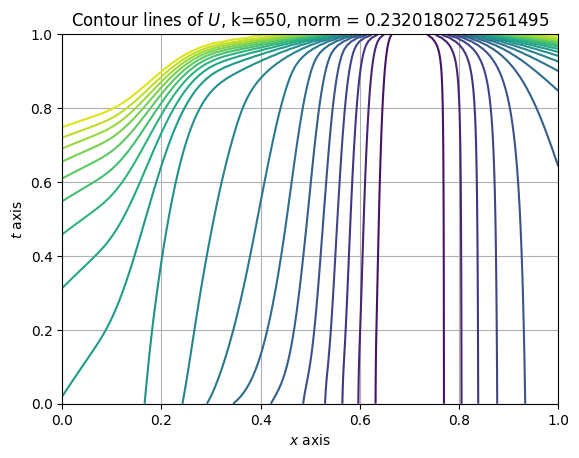

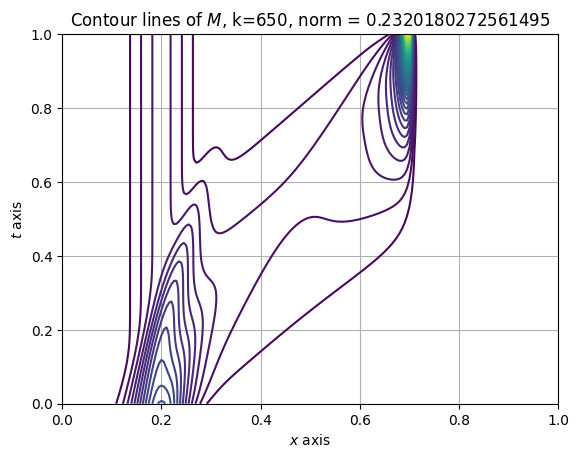

[Fixed Point] Iteration 650, previous norm: 0.2320180272561495, theta: 0.002, elapsed time: 379.4971649646759
[Fixed Point] Iteration 651, previous norm: 0.23160568538290363, theta: 0.002, elapsed time: 380.11878991127014
[Fixed Point] Iteration 652, previous norm: 0.2311950126224261, theta: 0.002, elapsed time: 380.6440212726593
[Fixed Point] Iteration 653, previous norm: 0.2307860061611629, theta: 0.002, elapsed time: 381.14821004867554
[Fixed Point] Iteration 654, previous norm: 0.23037866312559932, theta: 0.002, elapsed time: 381.6821849346161
[Fixed Point] Iteration 655, previous norm: 0.22997298058185262, theta: 0.002, elapsed time: 382.181884765625
[Fixed Point] Iteration 656, previous norm: 0.22956895553529408, theta: 0.002, elapsed time: 382.72826957702637
[Fixed Point] Iteration 657, previous norm: 0.22916658493014522, theta: 0.002, elapsed time: 383.35606122016907
[Fixed Point] Iteration 658, previous norm: 0.2287658656491062, theta: 0.002, elapsed time: 384.85341906547546
[

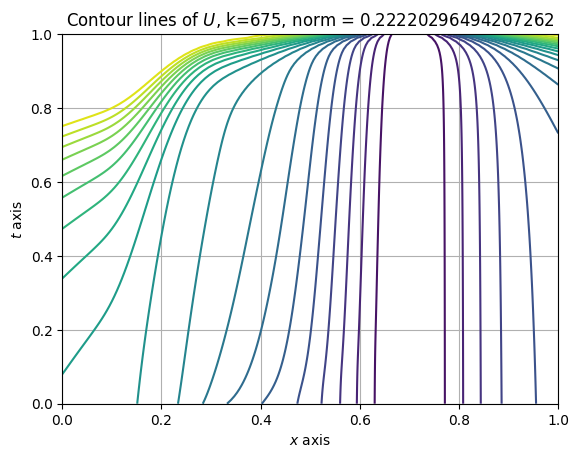

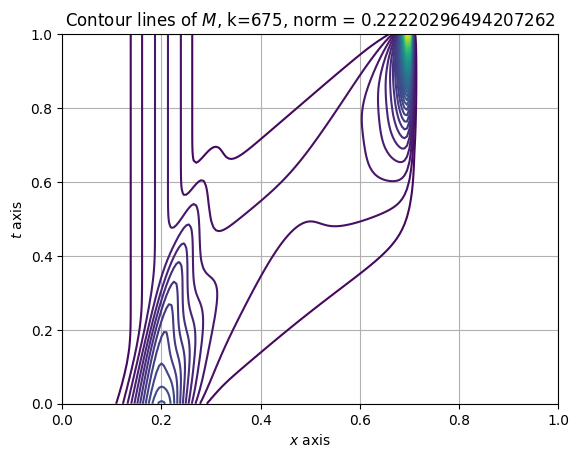

[Fixed Point] Iteration 675, previous norm: 0.22220296494207262, theta: 0.002, elapsed time: 395.0479459762573
[Fixed Point] Iteration 676, previous norm: 0.22183136436074424, theta: 0.002, elapsed time: 395.6863703727722
[Fixed Point] Iteration 677, previous norm: 0.22146134377256807, theta: 0.002, elapsed time: 396.2267863750458
[Fixed Point] Iteration 678, previous norm: 0.22109289876952593, theta: 0.002, elapsed time: 396.7374267578125
[Fixed Point] Iteration 679, previous norm: 0.2207260248684367, theta: 0.002, elapsed time: 398.2468490600586
[Fixed Point] Iteration 680, previous norm: 0.22036071753362513, theta: 0.002, elapsed time: 399.3915686607361
[Fixed Point] Iteration 681, previous norm: 0.21999697216048292, theta: 0.002, elapsed time: 400.20911288261414
[Fixed Point] Iteration 682, previous norm: 0.21963478407448636, theta: 0.002, elapsed time: 400.7334327697754
[Fixed Point] Iteration 683, previous norm: 0.21927414853436802, theta: 0.002, elapsed time: 401.2346498966217
[

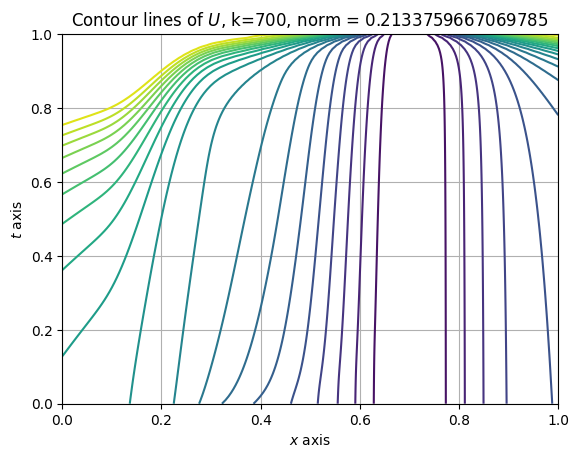

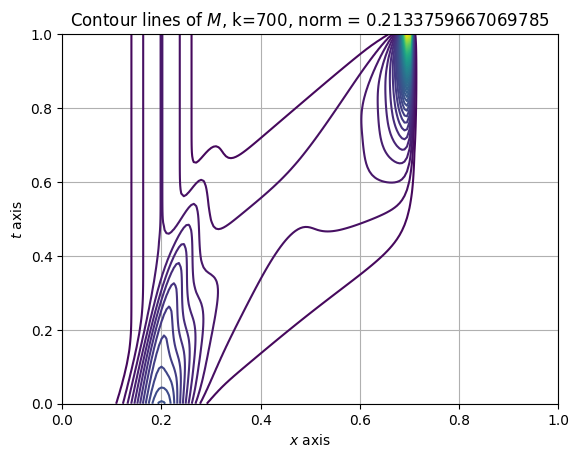

[Fixed Point] Iteration 700, previous norm: 0.2133759667069785, theta: 0.002, elapsed time: 410.91847038269043
[Fixed Point] Iteration 701, previous norm: 0.21304239037142436, theta: 0.002, elapsed time: 412.44873237609863
[Fixed Point] Iteration 702, previous norm: 0.2127102638915163, theta: 0.002, elapsed time: 413.66842579841614
[Fixed Point] Iteration 703, previous norm: 0.21237958120967418, theta: 0.002, elapsed time: 414.1526463031769
[Fixed Point] Iteration 704, previous norm: 0.2120503362047801, theta: 0.002, elapsed time: 414.72219347953796
[Fixed Point] Iteration 705, previous norm: 0.21172252269251668, theta: 0.002, elapsed time: 415.253705739975
[Fixed Point] Iteration 706, previous norm: 0.2113961344257361, theta: 0.002, elapsed time: 415.812947511673
[Fixed Point] Iteration 707, previous norm: 0.21107116509484192, theta: 0.002, elapsed time: 416.3641219139099
[Fixed Point] Iteration 708, previous norm: 0.21074760832818254, theta: 0.002, elapsed time: 416.8885533809662
[Fi

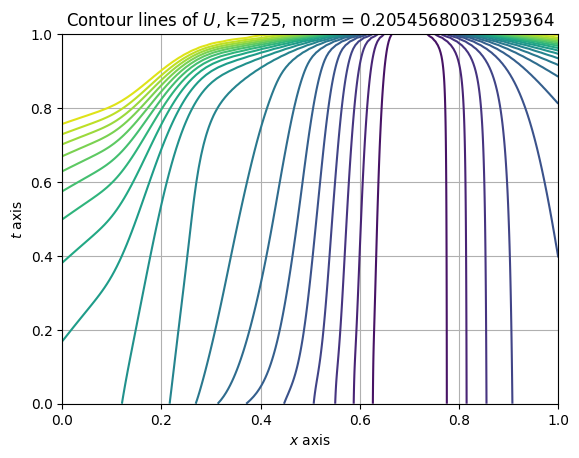

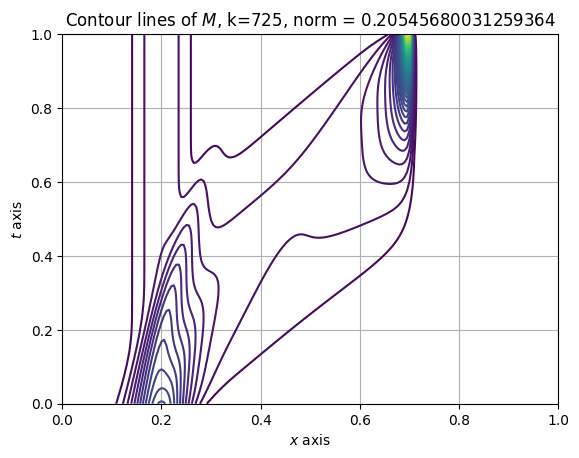

[Fixed Point] Iteration 725, previous norm: 0.20545680031259364, theta: 0.002, elapsed time: 428.19941782951355
[Fixed Point] Iteration 726, previous norm: 0.20515751226917178, theta: 0.002, elapsed time: 428.79352021217346
[Fixed Point] Iteration 727, previous norm: 0.20485950459920024, theta: 0.002, elapsed time: 429.34930658340454
[Fixed Point] Iteration 728, previous norm: 0.20456276980084695, theta: 0.002, elapsed time: 429.9015543460846
[Fixed Point] Iteration 729, previous norm: 0.20426730032262413, theta: 0.002, elapsed time: 430.4714136123657
[Fixed Point] Iteration 730, previous norm: 0.2039730885641482, theta: 0.002, elapsed time: 431.02242827415466
[Fixed Point] Iteration 731, previous norm: 0.20368012687692122, theta: 0.002, elapsed time: 431.57612323760986
[Fixed Point] Iteration 732, previous norm: 0.20338840756511634, theta: 0.002, elapsed time: 432.1184914112091
[Fixed Point] Iteration 733, previous norm: 0.20309792288642478, theta: 0.002, elapsed time: 432.70401000976

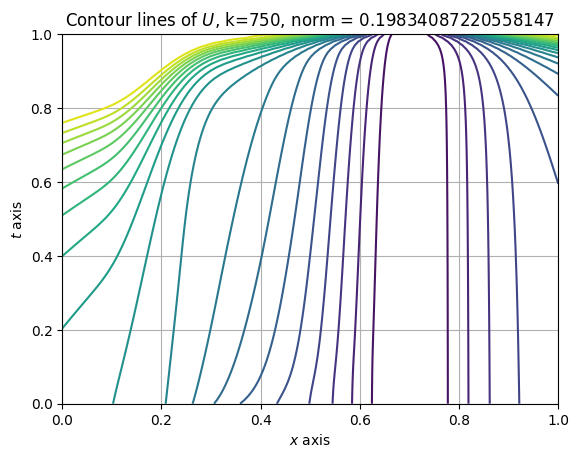

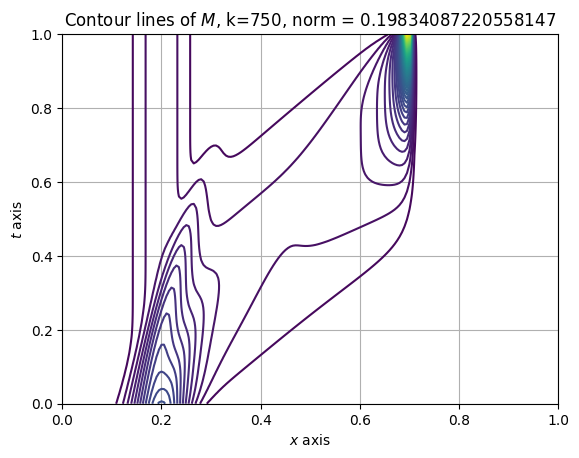

[Fixed Point] Iteration 750, previous norm: 0.19834087220558147, theta: 0.002, elapsed time: 445.5006580352783
[Fixed Point] Iteration 751, previous norm: 0.19807123920657688, theta: 0.002, elapsed time: 446.22066259384155
[Fixed Point] Iteration 752, previous norm: 0.19780268608234516, theta: 0.002, elapsed time: 447.78241062164307
[Fixed Point] Iteration 753, previous norm: 0.19753520435169322, theta: 0.002, elapsed time: 448.2929410934448
[Fixed Point] Iteration 754, previous norm: 0.19726878550692578, theta: 0.002, elapsed time: 448.8339650630951
[Fixed Point] Iteration 755, previous norm: 0.19700342101490514, theta: 0.002, elapsed time: 449.3319642543793
[Fixed Point] Iteration 756, previous norm: 0.19673910231814165, theta: 0.002, elapsed time: 449.88615322113037
[Fixed Point] Iteration 757, previous norm: 0.1964758208358548, theta: 0.002, elapsed time: 450.54826617240906
[Fixed Point] Iteration 758, previous norm: 0.19621356796507863, theta: 0.002, elapsed time: 452.595177888870

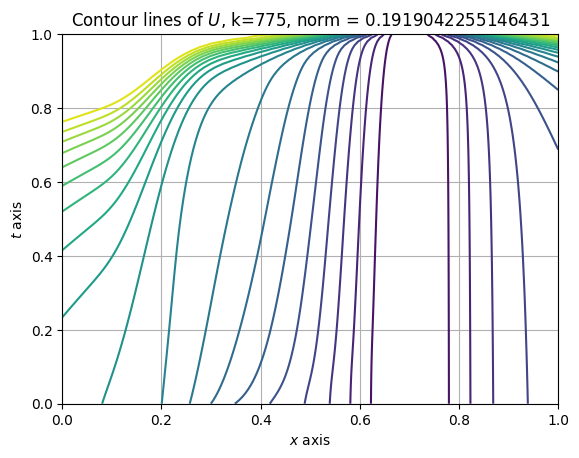

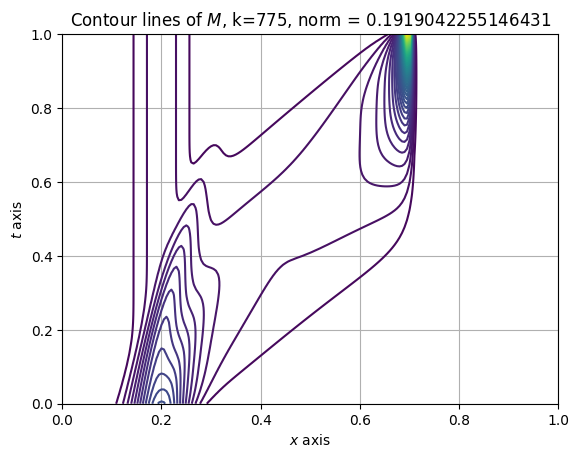

[Fixed Point] Iteration 775, previous norm: 0.1919042255146431, theta: 0.002, elapsed time: 464.73564553260803
[Fixed Point] Iteration 776, previous norm: 0.19165899790897695, theta: 0.002, elapsed time: 466.4327280521393
[Fixed Point] Iteration 777, previous norm: 0.19141463272926348, theta: 0.002, elapsed time: 467.2380590438843
[Fixed Point] Iteration 778, previous norm: 0.19117112116498428, theta: 0.002, elapsed time: 467.8005197048187
[Fixed Point] Iteration 779, previous norm: 0.1909284544072856, theta: 0.002, elapsed time: 468.3135578632355
[Fixed Point] Iteration 780, previous norm: 0.19068662365011924, theta: 0.002, elapsed time: 468.85374331474304
[Fixed Point] Iteration 781, previous norm: 0.1904456200914126, theta: 0.002, elapsed time: 469.35575008392334
[Fixed Point] Iteration 782, previous norm: 0.19020543493420117, theta: 0.002, elapsed time: 469.92558002471924
[Fixed Point] Iteration 783, previous norm: 0.18996605938777886, theta: 0.002, elapsed time: 470.4348599910736


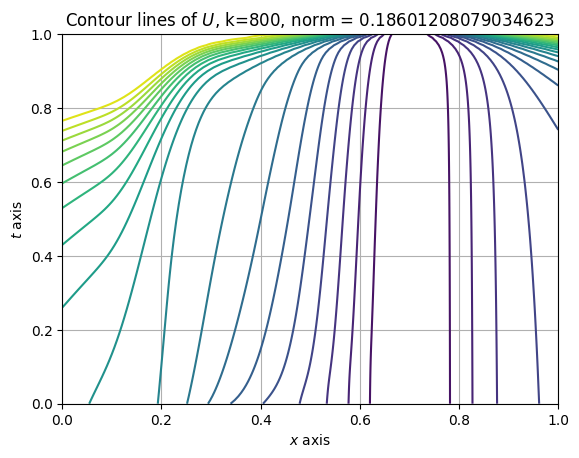

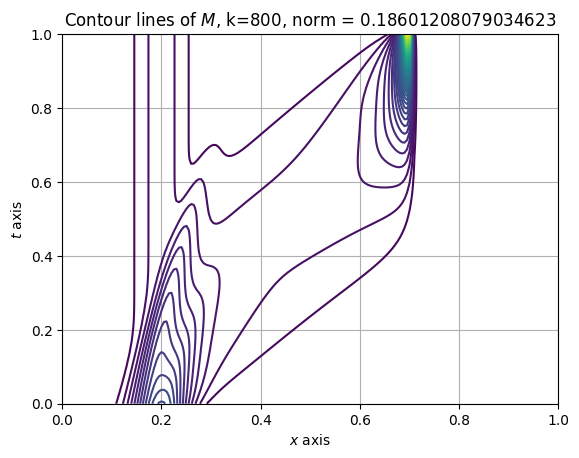

[Fixed Point] Iteration 800, previous norm: 0.18601208079034623, theta: 0.002, elapsed time: 483.7471971511841
[Fixed Point] Iteration 801, previous norm: 0.18578578893980158, theta: 0.002, elapsed time: 484.4342312812805
[Fixed Point] Iteration 802, previous norm: 0.1855601423647825, theta: 0.002, elapsed time: 484.9835078716278
[Fixed Point] Iteration 803, previous norm: 0.18533513263438303, theta: 0.002, elapsed time: 485.95640754699707
[Fixed Point] Iteration 804, previous norm: 0.18511075134696361, theta: 0.002, elapsed time: 486.80409502983093
[Fixed Point] Iteration 805, previous norm: 0.18488699013116724, theta: 0.002, elapsed time: 487.33358454704285
[Fixed Point] Iteration 806, previous norm: 0.18466384064690458, theta: 0.002, elapsed time: 488.0301351547241
[Fixed Point] Iteration 807, previous norm: 0.18444129458637107, theta: 0.002, elapsed time: 489.07717871665955
[Fixed Point] Iteration 808, previous norm: 0.18421934367502701, theta: 0.002, elapsed time: 489.604035377502

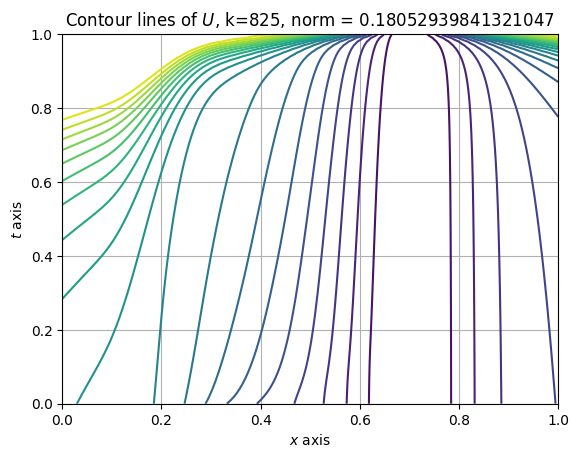

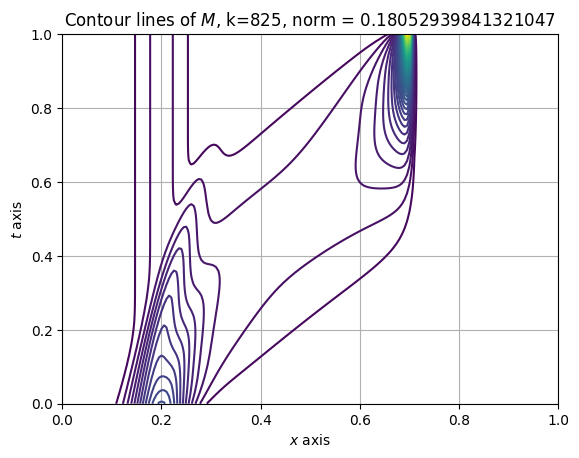

[Fixed Point] Iteration 825, previous norm: 0.18052939841321047, theta: 0.002, elapsed time: 502.1147346496582
[Fixed Point] Iteration 826, previous norm: 0.18031678877916282, theta: 0.002, elapsed time: 502.81316471099854
[Fixed Point] Iteration 827, previous norm: 0.18010462462928192, theta: 0.002, elapsed time: 503.7048592567444
[Fixed Point] Iteration 828, previous norm: 0.1798928985440419, theta: 0.002, elapsed time: 505.2760021686554
[Fixed Point] Iteration 829, previous norm: 0.17968160315517898, theta: 0.002, elapsed time: 506.5674834251404
[Fixed Point] Iteration 830, previous norm: 0.1794707311464226, theta: 0.002, elapsed time: 507.16261100769043
[Fixed Point] Iteration 831, previous norm: 0.17926027525417482, theta: 0.002, elapsed time: 507.7784833908081
[Fixed Point] Iteration 832, previous norm: 0.17905022826821007, theta: 0.002, elapsed time: 508.4232060909271
[Fixed Point] Iteration 833, previous norm: 0.17884058303233905, theta: 0.002, elapsed time: 508.99064588546753


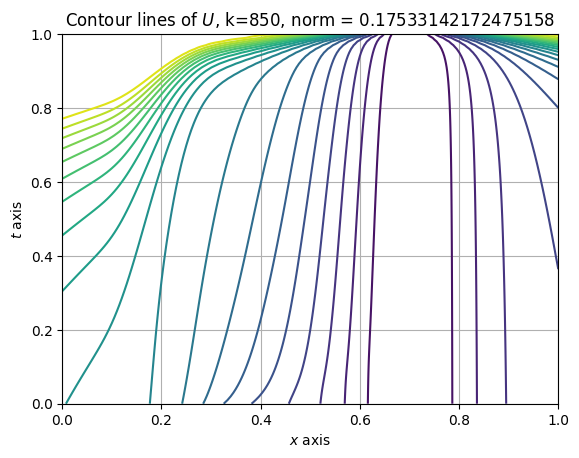

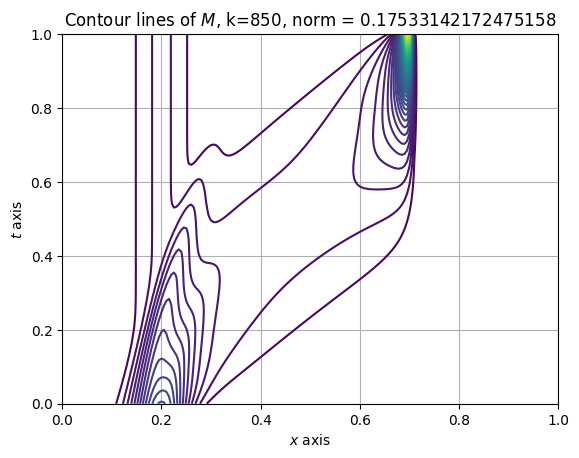

[Fixed Point] Iteration 850, previous norm: 0.17533142172475158, theta: 0.002, elapsed time: 523.2258718013763
[Fixed Point] Iteration 851, previous norm: 0.17512784948876237, theta: 0.002, elapsed time: 524.3496446609497
[Fixed Point] Iteration 852, previous norm: 0.17492455408130117, theta: 0.002, elapsed time: 525.0195205211639
[Fixed Point] Iteration 853, previous norm: 0.17472152954406936, theta: 0.002, elapsed time: 525.5857872962952
[Fixed Point] Iteration 854, previous norm: 0.17451876998334892, theta: 0.002, elapsed time: 526.0944294929504
[Fixed Point] Iteration 855, previous norm: 0.17431626957031388, theta: 0.002, elapsed time: 526.6624462604523
[Fixed Point] Iteration 856, previous norm: 0.17411402254136787, theta: 0.002, elapsed time: 527.433342218399
[Fixed Point] Iteration 857, previous norm: 0.17391202319843063, theta: 0.002, elapsed time: 528.1282026767731
[Fixed Point] Iteration 858, previous norm: 0.17371026590922553, theta: 0.002, elapsed time: 528.6883993148804
[F

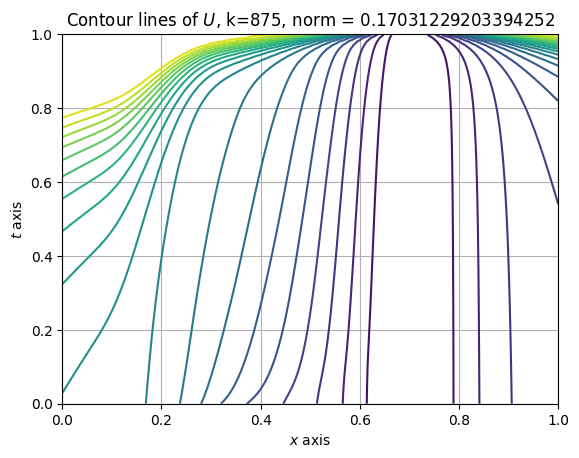

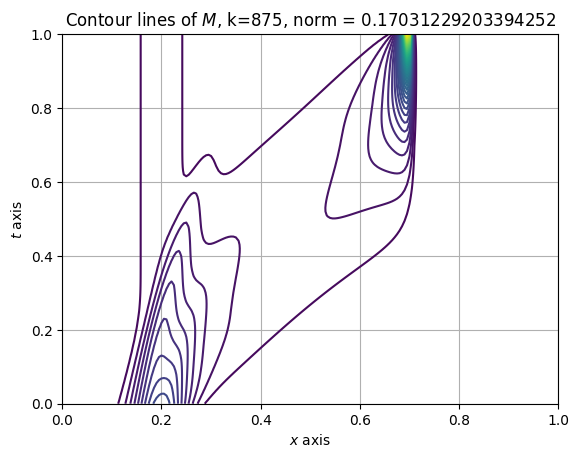

[Fixed Point] Iteration 875, previous norm: 0.17031229203394252, theta: 0.002, elapsed time: 541.58638048172
[Fixed Point] Iteration 876, previous norm: 0.17011400491725528, theta: 0.002, elapsed time: 542.2429854869843
[Fixed Point] Iteration 877, previous norm: 0.16991586561234598, theta: 0.002, elapsed time: 542.8028104305267
[Fixed Point] Iteration 878, previous norm: 0.16971786983965492, theta: 0.002, elapsed time: 544.6987860202789
[Fixed Point] Iteration 879, previous norm: 0.16952001338796371, theta: 0.002, elapsed time: 545.7451412677765
[Fixed Point] Iteration 880, previous norm: 0.1693222921143491, theta: 0.002, elapsed time: 546.6843721866608
[Fixed Point] Iteration 881, previous norm: 0.1691247019441223, theta: 0.002, elapsed time: 547.3013541698456
[Fixed Point] Iteration 882, previous norm: 0.16892723887079564, theta: 0.002, elapsed time: 547.8163585662842
[Fixed Point] Iteration 883, previous norm: 0.16872989895595736, theta: 0.002, elapsed time: 548.6073069572449
[Fixe

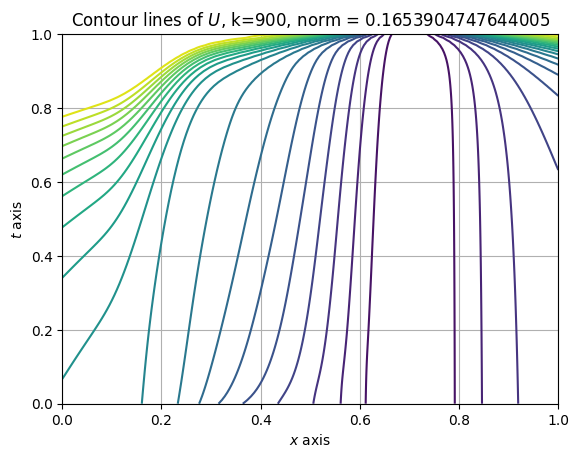

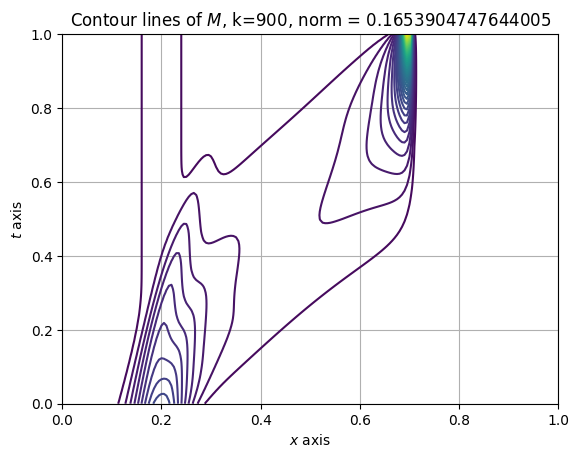

[Fixed Point] Iteration 900, previous norm: 0.1653904747644005, theta: 0.002, elapsed time: 563.1362595558167
[Fixed Point] Iteration 901, previous norm: 0.16519475507205203, theta: 0.002, elapsed time: 563.8263399600983
[Fixed Point] Iteration 902, previous norm: 0.16499909645209684, theta: 0.002, elapsed time: 564.3931367397308
[Fixed Point] Iteration 903, previous norm: 0.16480349629261584, theta: 0.002, elapsed time: 564.9441587924957
[Fixed Point] Iteration 904, previous norm: 0.16460795204531703, theta: 0.002, elapsed time: 565.5392003059387
[Fixed Point] Iteration 905, previous norm: 0.16441246122523956, theta: 0.002, elapsed time: 566.5040638446808
[Fixed Point] Iteration 906, previous norm: 0.16421702141037592, theta: 0.002, elapsed time: 567.2740550041199
[Fixed Point] Iteration 907, previous norm: 0.16402163024133745, theta: 0.002, elapsed time: 567.8438665866852
[Fixed Point] Iteration 908, previous norm: 0.16382628542098954, theta: 0.002, elapsed time: 568.4336607456207
[F

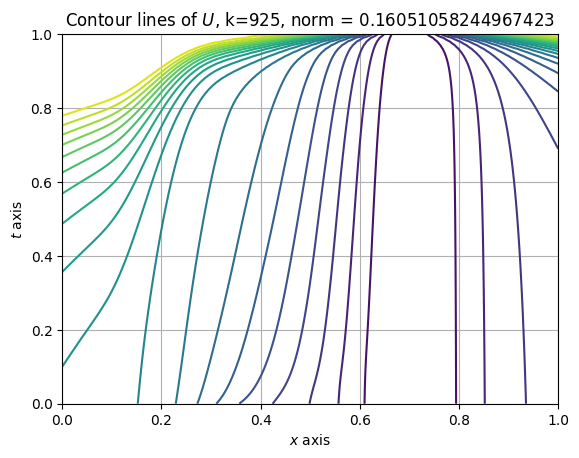

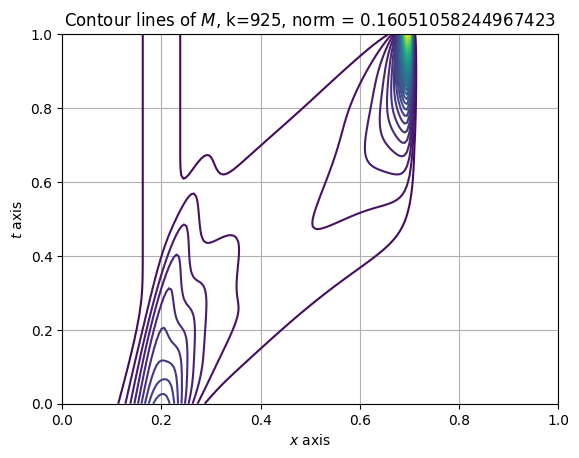

[Fixed Point] Iteration 925, previous norm: 0.16051058244967423, theta: 0.002, elapsed time: 581.4344251155853
[Fixed Point] Iteration 926, previous norm: 0.16031574765517662, theta: 0.002, elapsed time: 582.9867265224457
[Fixed Point] Iteration 927, previous norm: 0.16012092684465407, theta: 0.002, elapsed time: 583.9077866077423
[Fixed Point] Iteration 928, previous norm: 0.1599261188765815, theta: 0.002, elapsed time: 585.3996934890747
[Fixed Point] Iteration 929, previous norm: 0.15973132266215204, theta: 0.002, elapsed time: 586.6917023658752
[Fixed Point] Iteration 930, previous norm: 0.15953653716476213, theta: 0.002, elapsed time: 587.2308883666992
[Fixed Point] Iteration 931, previous norm: 0.15934176139946404, theta: 0.002, elapsed time: 587.7725439071655
[Fixed Point] Iteration 932, previous norm: 0.1591469944324257, theta: 0.002, elapsed time: 588.3793165683746
[Fixed Point] Iteration 933, previous norm: 0.15895223538039394, theta: 0.002, elapsed time: 589.3427338600159
[Fi

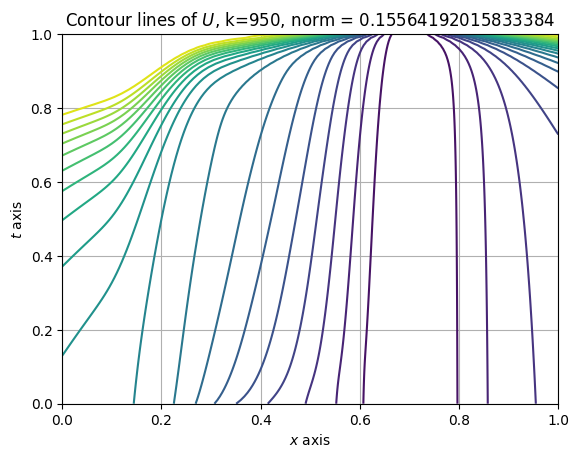

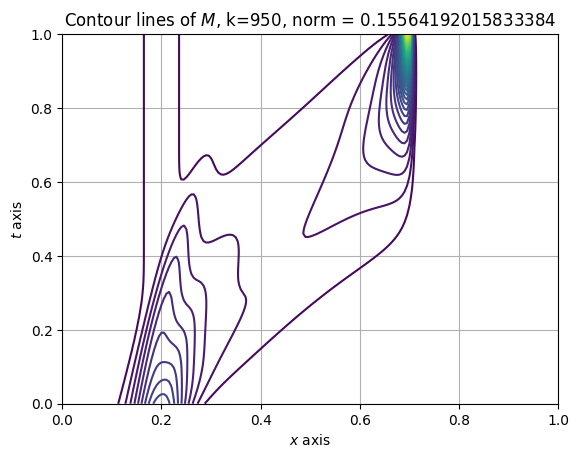

[Fixed Point] Iteration 950, previous norm: 0.15564192015833384, theta: 0.002, elapsed time: 603.2232491970062
[Fixed Point] Iteration 951, previous norm: 0.15544720679660037, theta: 0.002, elapsed time: 603.915360212326
[Fixed Point] Iteration 952, previous norm: 0.15525249341621297, theta: 0.002, elapsed time: 604.4652671813965
[Fixed Point] Iteration 953, previous norm: 0.15505778002377735, theta: 0.002, elapsed time: 605.6521077156067
[Fixed Point] Iteration 954, previous norm: 0.1548630666640607, theta: 0.002, elapsed time: 606.2513875961304
[Fixed Point] Iteration 955, previous norm: 0.15466835341933835, theta: 0.002, elapsed time: 606.7652621269226
[Fixed Point] Iteration 956, previous norm: 0.15447364040877784, theta: 0.002, elapsed time: 607.3333594799042
[Fixed Point] Iteration 957, previous norm: 0.15427892778781402, theta: 0.002, elapsed time: 607.8789675235748
[Fixed Point] Iteration 958, previous norm: 0.1540842157475191, theta: 0.002, elapsed time: 608.5290429592133
[Fix

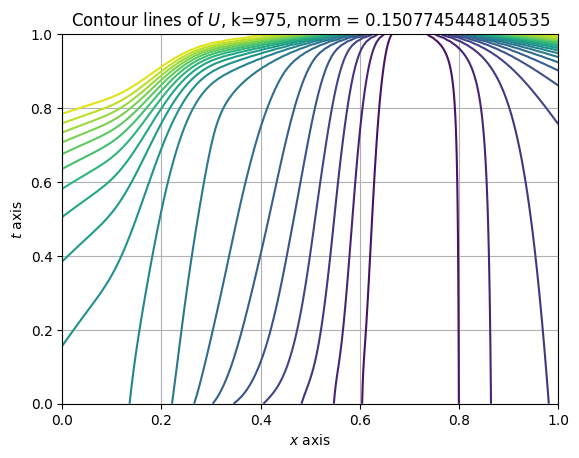

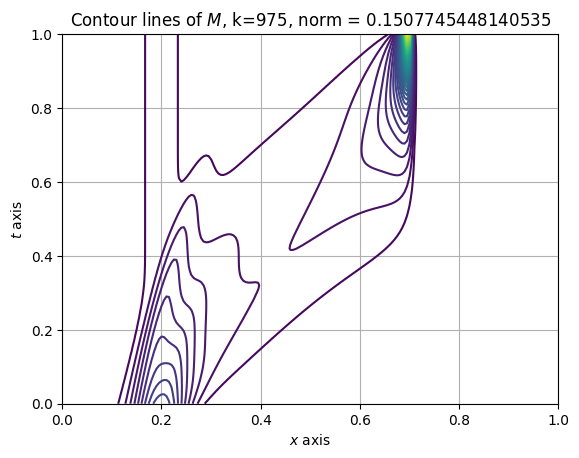

[Fixed Point] Iteration 975, previous norm: 0.1507745448140535, theta: 0.002, elapsed time: 622.2428629398346
[Fixed Point] Iteration 976, previous norm: 0.15057991272847027, theta: 0.002, elapsed time: 623.0180144309998
[Fixed Point] Iteration 977, previous norm: 0.1503852907805228, theta: 0.002, elapsed time: 623.8836424350739
[Fixed Point] Iteration 978, previous norm: 0.15019067974057754, theta: 0.002, elapsed time: 626.0307574272156
[Fixed Point] Iteration 979, previous norm: 0.1499960804012703, theta: 0.002, elapsed time: 627.0572504997253
[Fixed Point] Iteration 980, previous norm: 0.14980149357690895, theta: 0.002, elapsed time: 627.6054983139038
[Fixed Point] Iteration 981, previous norm: 0.1496069201028185, theta: 0.002, elapsed time: 628.1178262233734
[Fixed Point] Iteration 982, previous norm: 0.1494123608347224, theta: 0.002, elapsed time: 628.670848608017
[Fixed Point] Iteration 983, previous norm: 0.14921781664810851, theta: 0.002, elapsed time: 629.1952245235443
[Fixed 

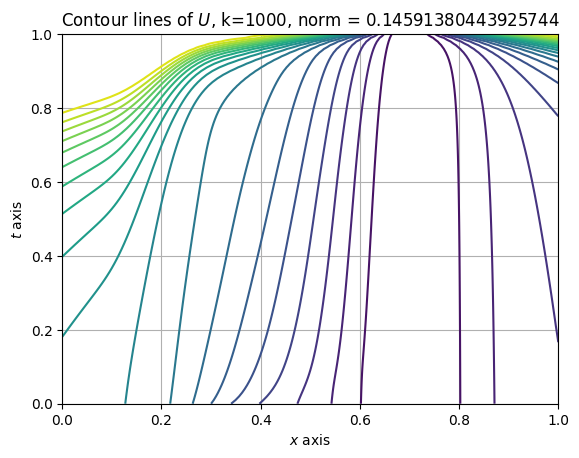

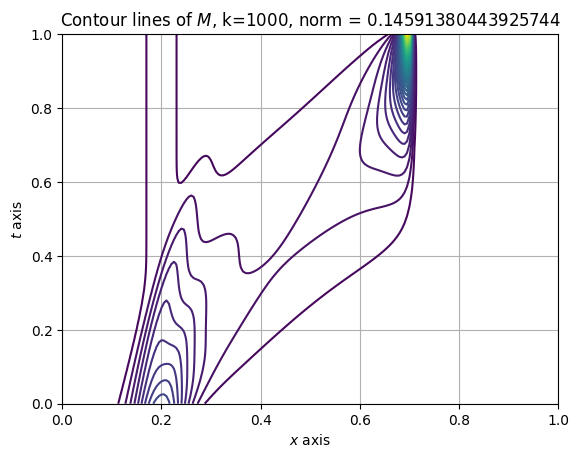

[Fixed Point] Iteration 1000, previous norm: 0.14591380443925744, theta: 0.002, elapsed time: 640.7929861545563
[Fixed Point] Iteration 1001, previous norm: 0.1457197002581831, theta: 0.002, elapsed time: 641.4184000492096
[Fixed Point] Iteration 1002, previous norm: 0.1455256307285752, theta: 0.002, elapsed time: 642.0167801380157
[Fixed Point] Iteration 1003, previous norm: 0.1453315969926834, theta: 0.002, elapsed time: 642.5914776325226
[Fixed Point] Iteration 1004, previous norm: 0.1451376001998544, theta: 0.002, elapsed time: 643.1343474388123
[Fixed Point] Iteration 1005, previous norm: 0.14494364150597375, theta: 0.002, elapsed time: 643.709105014801
[Fixed Point] Iteration 1006, previous norm: 0.14474972207289094, theta: 0.002, elapsed time: 644.2615683078766
[Fixed Point] Iteration 1007, previous norm: 0.1445558430678693, theta: 0.002, elapsed time: 644.8119556903839
[Fixed Point] Iteration 1008, previous norm: 0.14436200566301033, theta: 0.002, elapsed time: 645.371286392211

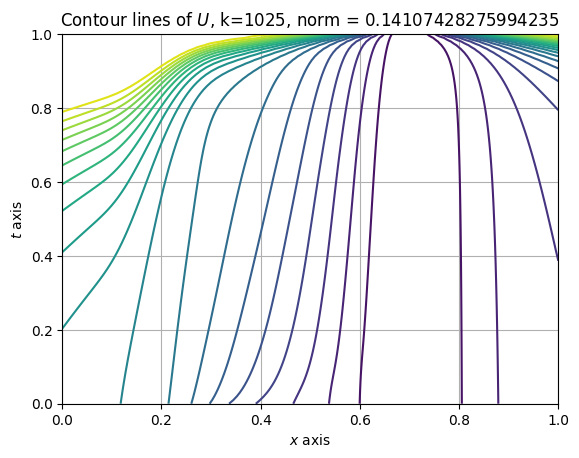

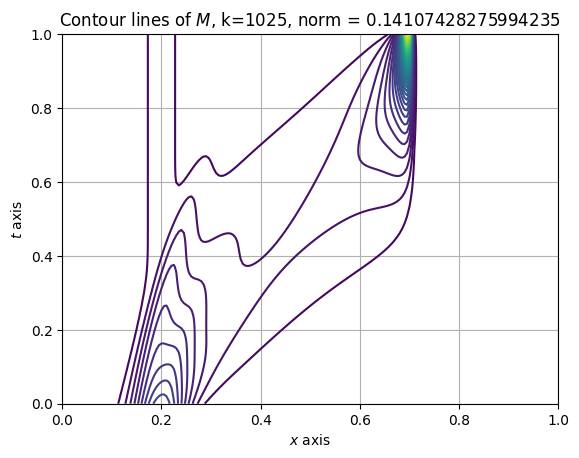

[Fixed Point] Iteration 1025, previous norm: 0.14107428275994235, theta: 0.002, elapsed time: 657.5210647583008
[Fixed Point] Iteration 1026, previous norm: 0.14088139686883933, theta: 0.002, elapsed time: 658.1488308906555
[Fixed Point] Iteration 1027, previous norm: 0.14068857505433877, theta: 0.002, elapsed time: 658.7688734531403
[Fixed Point] Iteration 1028, previous norm: 0.14049581847442377, theta: 0.002, elapsed time: 659.4054307937622
[Fixed Point] Iteration 1029, previous norm: 0.14030312828117966, theta: 0.002, elapsed time: 659.999575138092
[Fixed Point] Iteration 1030, previous norm: 0.14011050562033234, theta: 0.002, elapsed time: 660.5603733062744
[Fixed Point] Iteration 1031, previous norm: 0.13991795163080592, theta: 0.002, elapsed time: 661.166225194931
[Fixed Point] Iteration 1032, previous norm: 0.13972546744426653, theta: 0.002, elapsed time: 661.7384285926819
[Fixed Point] Iteration 1033, previous norm: 0.13953305418470155, theta: 0.002, elapsed time: 662.33099269

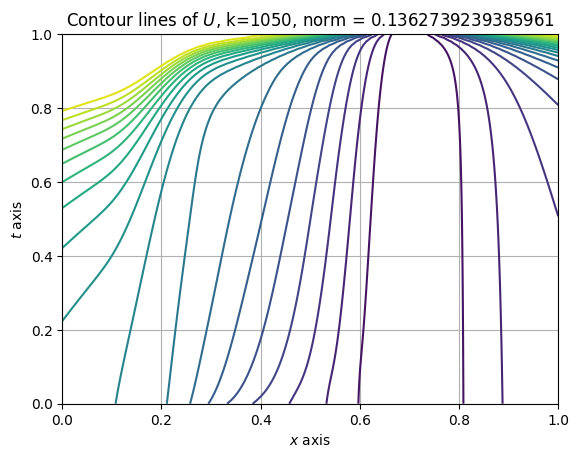

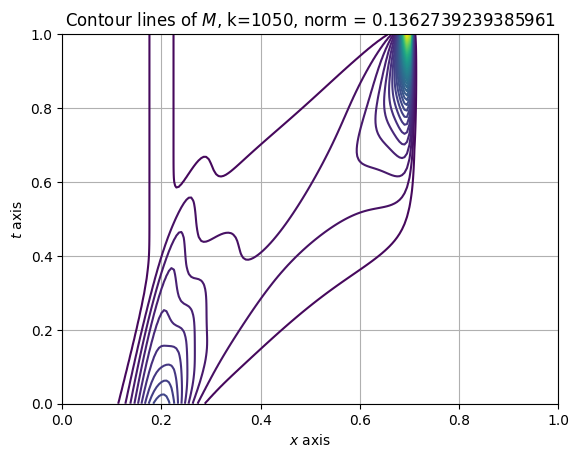

[Fixed Point] Iteration 1050, previous norm: 0.1362739239385961, theta: 0.002, elapsed time: 674.6860563755035
[Fixed Point] Iteration 1051, previous norm: 0.1360829683158066, theta: 0.002, elapsed time: 675.3718593120575
[Fixed Point] Iteration 1052, previous norm: 0.135892102972276, theta: 0.002, elapsed time: 675.9796290397644
[Fixed Point] Iteration 1053, previous norm: 0.13570132879507107, theta: 0.002, elapsed time: 676.5518081188202
[Fixed Point] Iteration 1054, previous norm: 0.13551064665577156, theta: 0.002, elapsed time: 677.1844232082367
[Fixed Point] Iteration 1055, previous norm: 0.13532005741017106, theta: 0.002, elapsed time: 678.0144095420837
[Fixed Point] Iteration 1056, previous norm: 0.13512956189798692, theta: 0.002, elapsed time: 679.3505845069885
[Fixed Point] Iteration 1057, previous norm: 0.13493916094258807, theta: 0.002, elapsed time: 680.4148328304291
[Fixed Point] Iteration 1058, previous norm: 0.13474885535071449, theta: 0.002, elapsed time: 681.4018404483

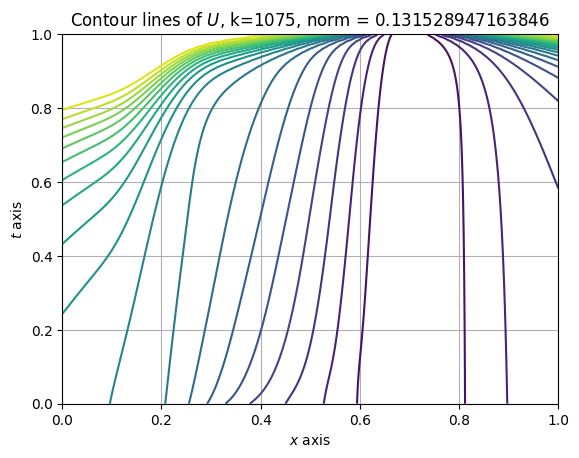

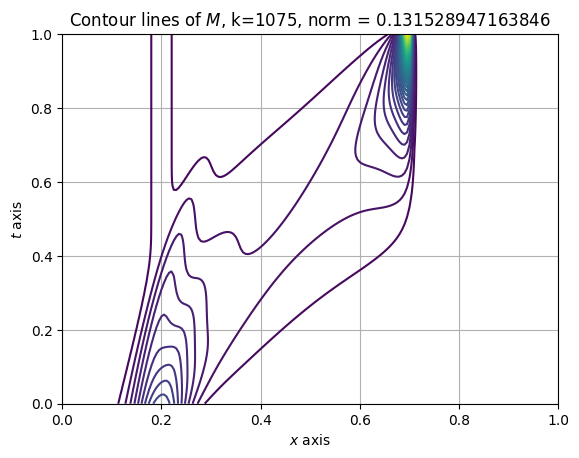

[Fixed Point] Iteration 1075, previous norm: 0.131528947163846, theta: 0.002, elapsed time: 693.6461353302002
[Fixed Point] Iteration 1076, previous norm: 0.13134047570346413, theta: 0.002, elapsed time: 694.8386287689209
[Fixed Point] Iteration 1077, previous norm: 0.13115211147476954, theta: 0.002, elapsed time: 695.3379654884338
[Fixed Point] Iteration 1078, previous norm: 0.13096385490785498, theta: 0.002, elapsed time: 695.8640170097351
[Fixed Point] Iteration 1079, previous norm: 0.1307757064124778, theta: 0.002, elapsed time: 696.5095455646515
[Fixed Point] Iteration 1080, previous norm: 0.13058766637798577, theta: 0.002, elapsed time: 697.1775624752045
[Fixed Point] Iteration 1081, previous norm: 0.13039973517326275, theta: 0.002, elapsed time: 697.7437102794647
[Fixed Point] Iteration 1082, previous norm: 0.13021191314667777, theta: 0.002, elapsed time: 698.3047490119934
[Fixed Point] Iteration 1083, previous norm: 0.13002420062604822, theta: 0.002, elapsed time: 698.934172630

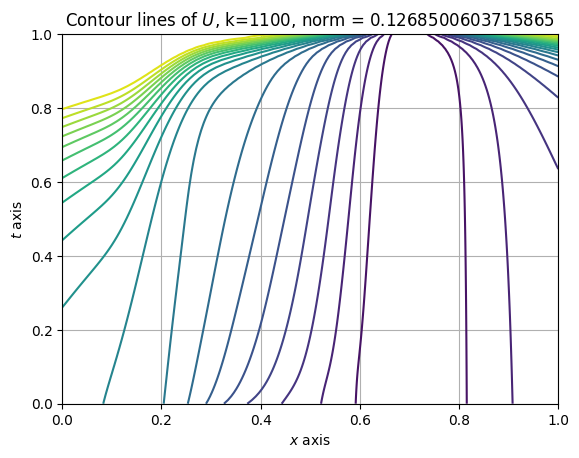

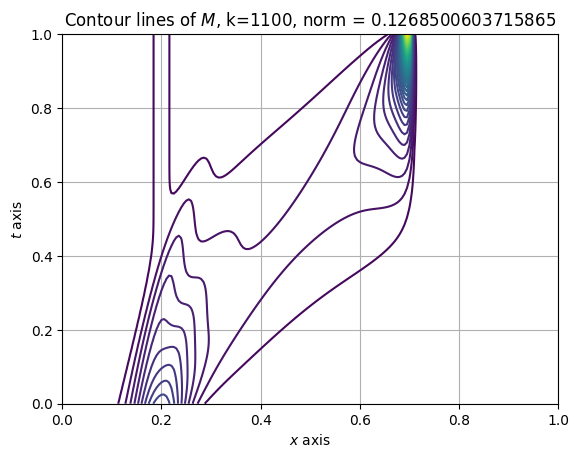

[Fixed Point] Iteration 1100, previous norm: 0.1268500603715865, theta: 0.002, elapsed time: 711.1793282032013
[Fixed Point] Iteration 1101, previous norm: 0.12666435167114595, theta: 0.002, elapsed time: 711.8456542491913
[Fixed Point] Iteration 1102, previous norm: 0.12647875483784018, theta: 0.002, elapsed time: 712.4082956314087
[Fixed Point] Iteration 1103, previous norm: 0.1262932697993703, theta: 0.002, elapsed time: 713.0131931304932
[Fixed Point] Iteration 1104, previous norm: 0.12610789646501294, theta: 0.002, elapsed time: 713.5360369682312
[Fixed Point] Iteration 1105, previous norm: 0.12592263472588008, theta: 0.002, elapsed time: 714.1427364349365
[Fixed Point] Iteration 1106, previous norm: 0.1257374844552028, theta: 0.002, elapsed time: 714.7118422985077
[Fixed Point] Iteration 1107, previous norm: 0.12555244550861275, theta: 0.002, elapsed time: 715.2614576816559
[Fixed Point] Iteration 1108, previous norm: 0.12536751772446358, theta: 0.002, elapsed time: 715.851658344

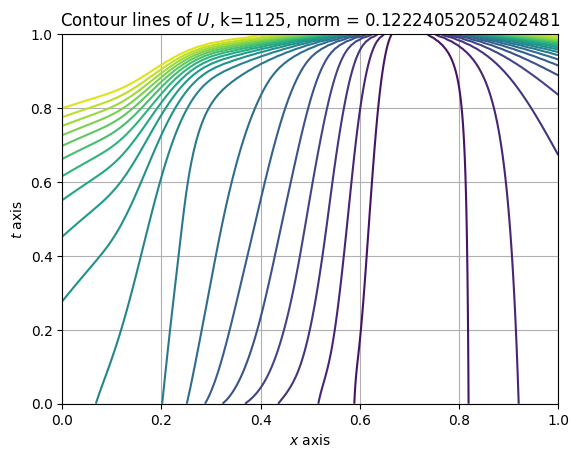

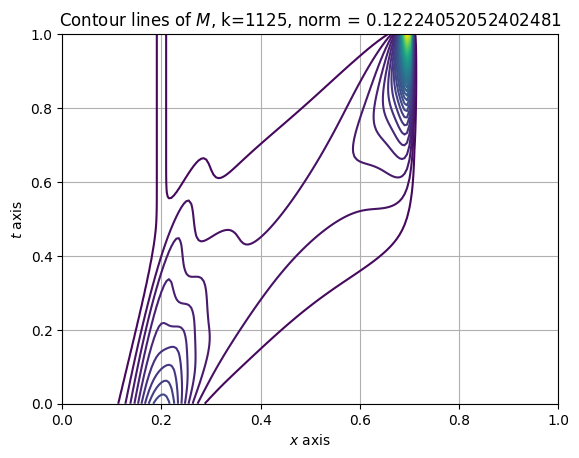

[Fixed Point] Iteration 1125, previous norm: 0.12224052052402481, theta: 0.002, elapsed time: 728.0784537792206
[Fixed Point] Iteration 1126, previous norm: 0.12205754865254446, theta: 0.002, elapsed time: 728.851212978363
[Fixed Point] Iteration 1127, previous norm: 0.12187468213578716, theta: 0.002, elapsed time: 729.4541223049164
[Fixed Point] Iteration 1128, previous norm: 0.12169192056062206, theta: 0.002, elapsed time: 730.0227415561676
[Fixed Point] Iteration 1129, previous norm: 0.12150926350767396, theta: 0.002, elapsed time: 730.589467048645
[Fixed Point] Iteration 1130, previous norm: 0.12132671055209027, theta: 0.002, elapsed time: 731.1618659496307
[Fixed Point] Iteration 1131, previous norm: 0.12114426126434062, theta: 0.002, elapsed time: 731.7202112674713
[Fixed Point] Iteration 1132, previous norm: 0.1209619152110549, theta: 0.002, elapsed time: 732.99729347229
[Fixed Point] Iteration 1133, previous norm: 0.1207796719558578, theta: 0.002, elapsed time: 734.251117706298

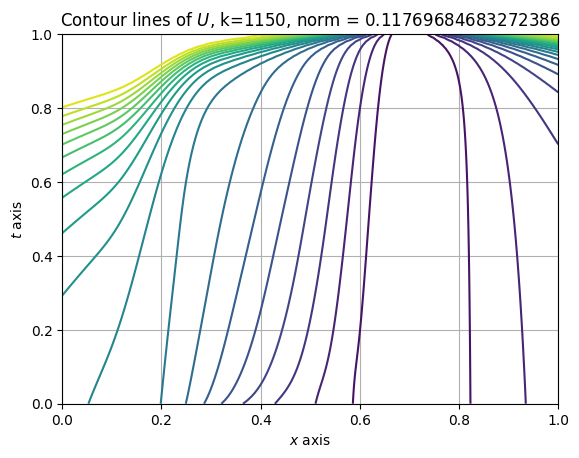

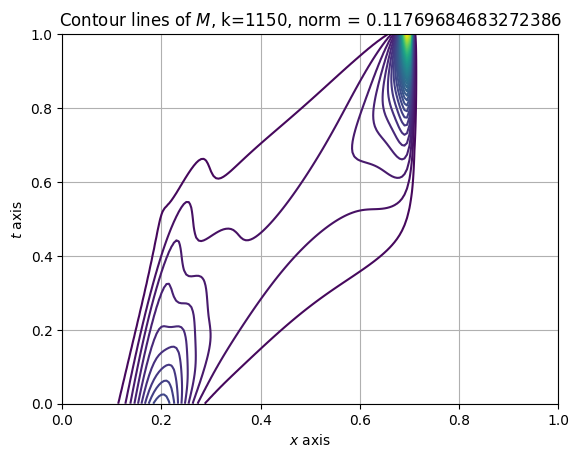

[Fixed Point] Iteration 1150, previous norm: 0.11769684683272386, theta: 0.002, elapsed time: 745.4716467857361
[Fixed Point] Iteration 1151, previous norm: 0.11751638176547237, theta: 0.002, elapsed time: 746.5395584106445
[Fixed Point] Iteration 1152, previous norm: 0.11733601198241506, theta: 0.002, elapsed time: 747.9382150173187
[Fixed Point] Iteration 1153, previous norm: 0.1171557372119573, theta: 0.002, elapsed time: 749.0787134170532
[Fixed Point] Iteration 1154, previous norm: 0.11697555720449263, theta: 0.002, elapsed time: 749.6610457897186
[Fixed Point] Iteration 1155, previous norm: 0.11679547173398978, theta: 0.002, elapsed time: 750.2030601501465
[Fixed Point] Iteration 1156, previous norm: 0.11661548059958331, theta: 0.002, elapsed time: 750.786328792572
[Fixed Point] Iteration 1157, previous norm: 0.11643558362724263, theta: 0.002, elapsed time: 751.3361268043518
[Fixed Point] Iteration 1158, previous norm: 0.11625578067145656, theta: 0.002, elapsed time: 751.89785075

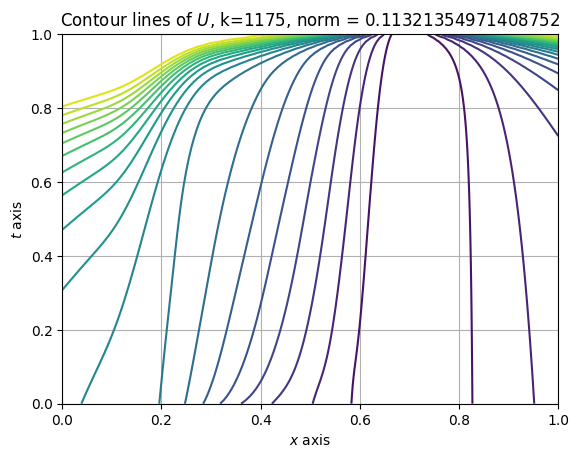

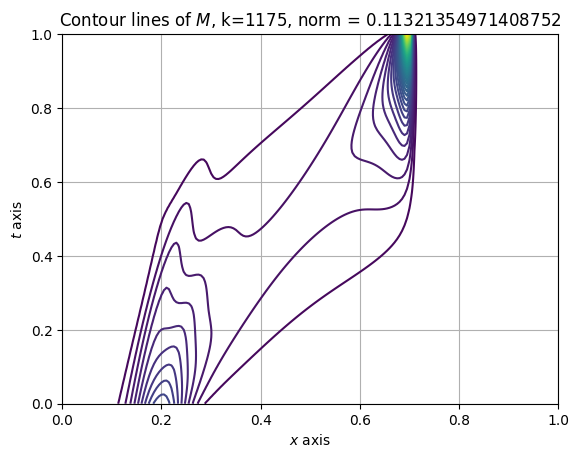

[Fixed Point] Iteration 1175, previous norm: 0.11321354971408752, theta: 0.002, elapsed time: 763.9668023586273
[Fixed Point] Iteration 1176, previous norm: 0.11303545793208954, theta: 0.002, elapsed time: 764.6340925693512
[Fixed Point] Iteration 1177, previous norm: 0.11285746538481072, theta: 0.002, elapsed time: 765.1673424243927
[Fixed Point] Iteration 1178, previous norm: 0.11267957291943313, theta: 0.002, elapsed time: 765.7033331394196
[Fixed Point] Iteration 1179, previous norm: 0.11250178145746409, theta: 0.002, elapsed time: 766.218535900116
[Fixed Point] Iteration 1180, previous norm: 0.11232409199744267, theta: 0.002, elapsed time: 766.8502261638641
[Fixed Point] Iteration 1181, previous norm: 0.11214650561771453, theta: 0.002, elapsed time: 767.4394738674164
[Fixed Point] Iteration 1182, previous norm: 0.1119690234792315, theta: 0.002, elapsed time: 768.0230166912079
[Fixed Point] Iteration 1183, previous norm: 0.11179164682842987, theta: 0.002, elapsed time: 768.58810377

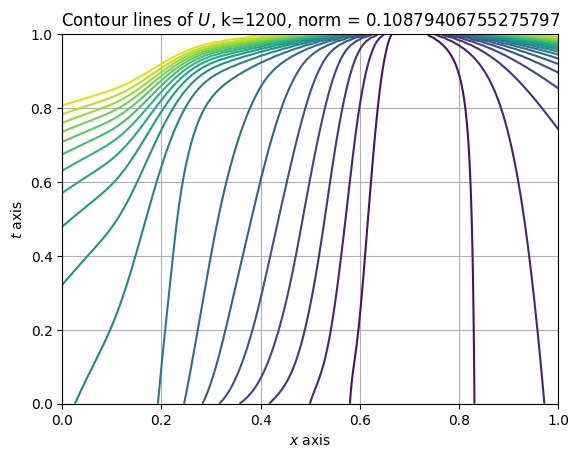

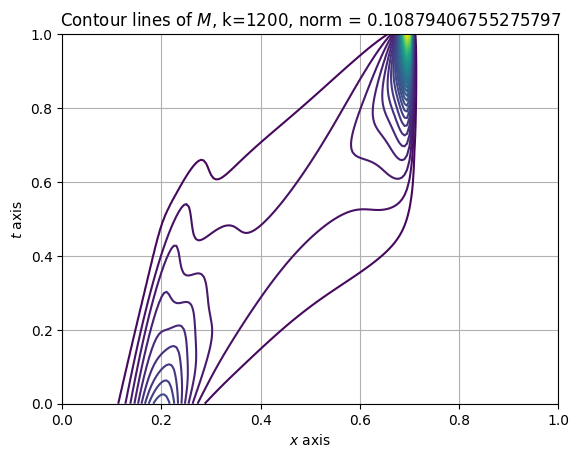

[Fixed Point] Iteration 1200, previous norm: 0.10879406755275797, theta: 0.002, elapsed time: 781.1648442745209
[Fixed Point] Iteration 1201, previous norm: 0.10861891879903018, theta: 0.002, elapsed time: 781.9227621555328
[Fixed Point] Iteration 1202, previous norm: 0.10844391965116361, theta: 0.002, elapsed time: 782.5377585887909
[Fixed Point] Iteration 1203, previous norm: 0.10826907374753293, theta: 0.002, elapsed time: 783.1413474082947
[Fixed Point] Iteration 1204, previous norm: 0.10809438488418374, theta: 0.002, elapsed time: 783.6672828197479
[Fixed Point] Iteration 1205, previous norm: 0.10791985701880777, theta: 0.002, elapsed time: 784.2682695388794
[Fixed Point] Iteration 1206, previous norm: 0.10774549427478651, theta: 0.002, elapsed time: 784.8800981044769
[Fixed Point] Iteration 1207, previous norm: 0.10757130094524991, theta: 0.002, elapsed time: 785.4716579914093
[Fixed Point] Iteration 1208, previous norm: 0.1073972814971973, theta: 0.002, elapsed time: 786.0497636

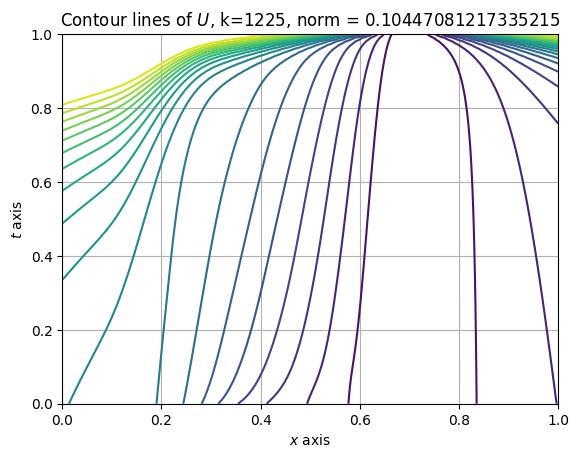

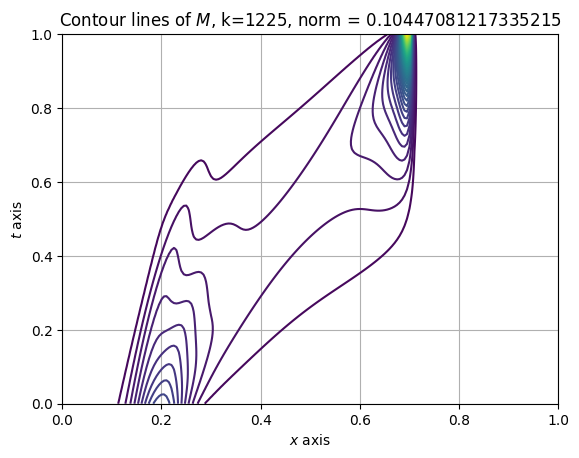

[Fixed Point] Iteration 1225, previous norm: 0.10447081217335215, theta: 0.002, elapsed time: 798.5910995006561
[Fixed Point] Iteration 1226, previous norm: 0.1043009102395162, theta: 0.002, elapsed time: 799.380330324173
[Fixed Point] Iteration 1227, previous norm: 0.10413130582156213, theta: 0.002, elapsed time: 800.3780570030212
[Fixed Point] Iteration 1228, previous norm: 0.10396200777761075, theta: 0.002, elapsed time: 801.9920921325684
[Fixed Point] Iteration 1229, previous norm: 0.10379302523248803, theta: 0.002, elapsed time: 803.2612245082855
[Fixed Point] Iteration 1230, previous norm: 0.10362436758220452, theta: 0.002, elapsed time: 803.8835363388062
[Fixed Point] Iteration 1231, previous norm: 0.10345604449844654, theta: 0.002, elapsed time: 804.5364413261414
[Fixed Point] Iteration 1232, previous norm: 0.10328806593303462, theta: 0.002, elapsed time: 805.0873684883118
[Fixed Point] Iteration 1233, previous norm: 0.10312044212234639, theta: 0.002, elapsed time: 805.70559883

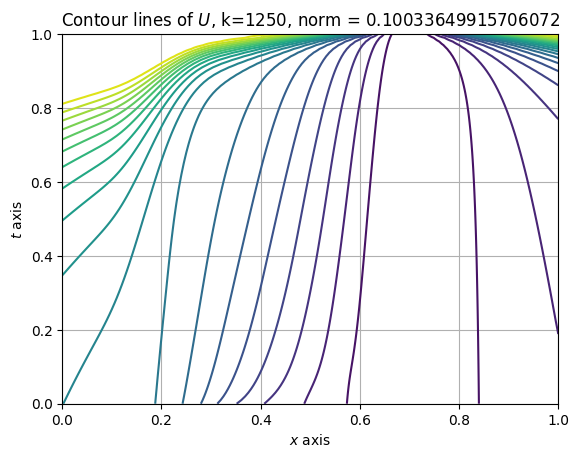

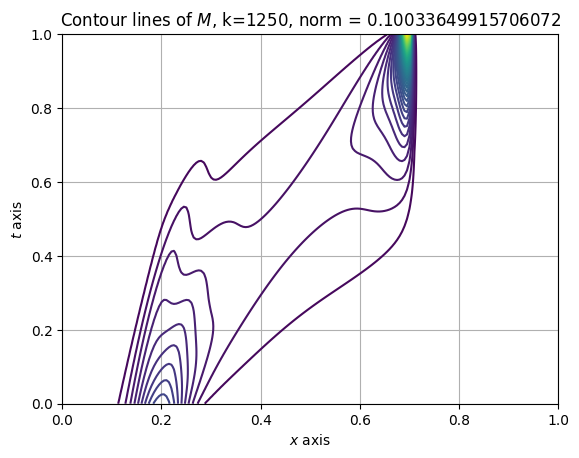

[Fixed Point] Iteration 1250, previous norm: 0.10033649915706072, theta: 0.002, elapsed time: 817.9808773994446
[Fixed Point] Iteration 1251, previous norm: 0.10017736093186975, theta: 0.002, elapsed time: 818.6112759113312
[Fixed Point] Iteration 1252, previous norm: 0.10001883150795711, theta: 0.002, elapsed time: 819.2137274742126
[Fixed Point] Iteration 1253, previous norm: 0.09986092764744332, theta: 0.002, elapsed time: 819.7863526344299
[Fixed Point] Iteration 1254, previous norm: 0.09970366647277519, theta: 0.002, elapsed time: 820.393394947052
[Fixed Point] Iteration 1255, previous norm: 0.09954706546890305, theta: 0.002, elapsed time: 821.005471944809
[Fixed Point] Iteration 1256, previous norm: 0.09939114248529077, theta: 0.002, elapsed time: 821.6356384754181
[Fixed Point] Iteration 1257, previous norm: 0.09923591573770721, theta: 0.002, elapsed time: 822.3152456283569
[Fixed Point] Iteration 1258, previous norm: 0.09908140380980195, theta: 0.002, elapsed time: 822.98917150

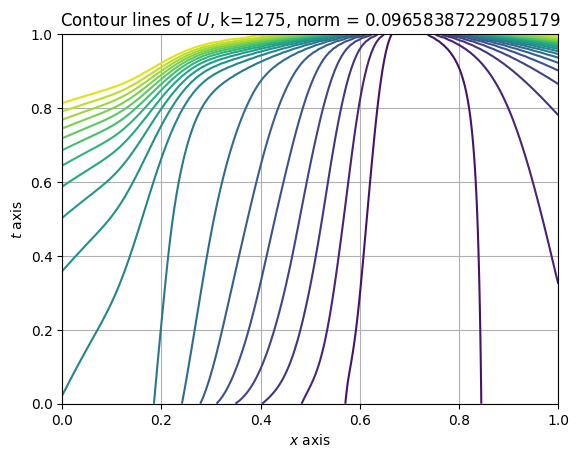

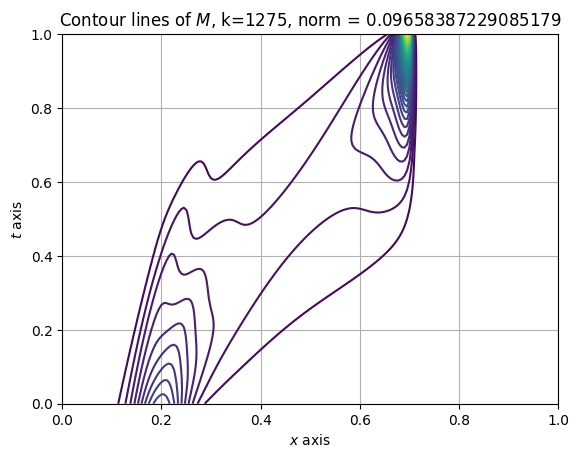

[Fixed Point] Iteration 1275, previous norm: 0.09658387229085179, theta: 0.002, elapsed time: 835.6639564037323
[Fixed Point] Iteration 1276, previous norm: 0.09644582716897455, theta: 0.002, elapsed time: 836.3040709495544
[Fixed Point] Iteration 1277, previous norm: 0.09630892006398115, theta: 0.002, elapsed time: 836.9362368583679
[Fixed Point] Iteration 1278, previous norm: 0.09617317683198434, theta: 0.002, elapsed time: 837.4824690818787
[Fixed Point] Iteration 1279, previous norm: 0.09603862366287783, theta: 0.002, elapsed time: 838.08908867836
[Fixed Point] Iteration 1280, previous norm: 0.09590528707461478, theta: 0.002, elapsed time: 838.6362929344177
[Fixed Point] Iteration 1281, previous norm: 0.09577319390701171, theta: 0.002, elapsed time: 839.2193446159363
[Fixed Point] Iteration 1282, previous norm: 0.09564237131511175, theta: 0.002, elapsed time: 839.830456495285
[Fixed Point] Iteration 1283, previous norm: 0.09551284676206516, theta: 0.002, elapsed time: 840.424844026

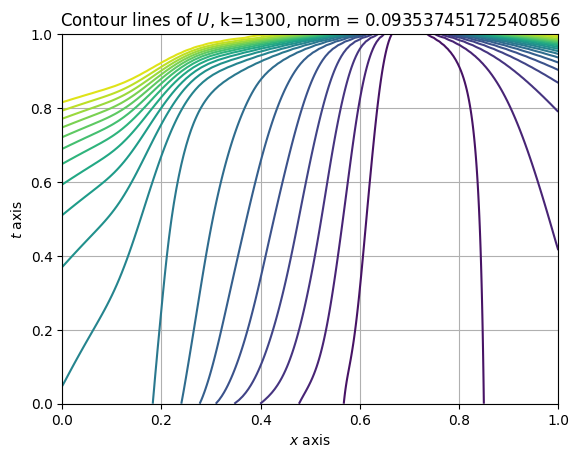

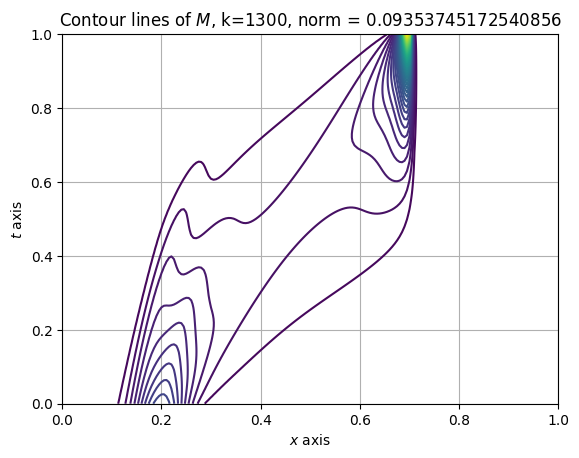

[Fixed Point] Iteration 1300, previous norm: 0.09353745172540856, theta: 0.002, elapsed time: 852.6651811599731
[Fixed Point] Iteration 1301, previous norm: 0.09343628344920105, theta: 0.002, elapsed time: 853.4319467544556
[Fixed Point] Iteration 1302, previous norm: 0.09333698036640993, theta: 0.002, elapsed time: 854.0149397850037
[Fixed Point] Iteration 1303, previous norm: 0.09323957381477405, theta: 0.002, elapsed time: 854.6357569694519
[Fixed Point] Iteration 1304, previous norm: 0.0931440951697149, theta: 0.002, elapsed time: 856.1633994579315
[Fixed Point] Iteration 1305, previous norm: 0.09305057582544762, theta: 0.002, elapsed time: 857.352080821991
[Fixed Point] Iteration 1306, previous norm: 0.09295904717557657, theta: 0.002, elapsed time: 858.3458139896393
[Fixed Point] Iteration 1307, previous norm: 0.0928695405931593, theta: 0.002, elapsed time: 858.9264509677887
[Fixed Point] Iteration 1308, previous norm: 0.09278208741024695, theta: 0.002, elapsed time: 859.519026041

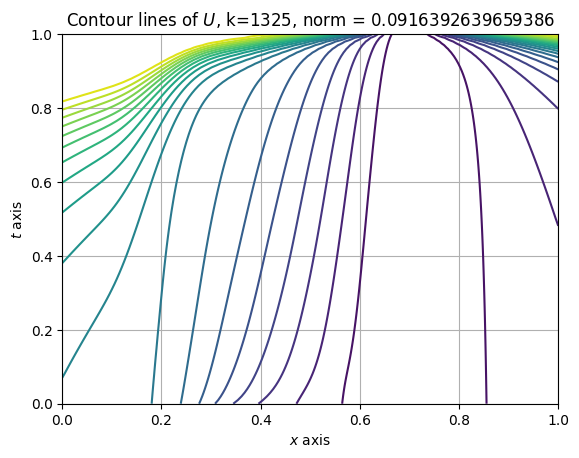

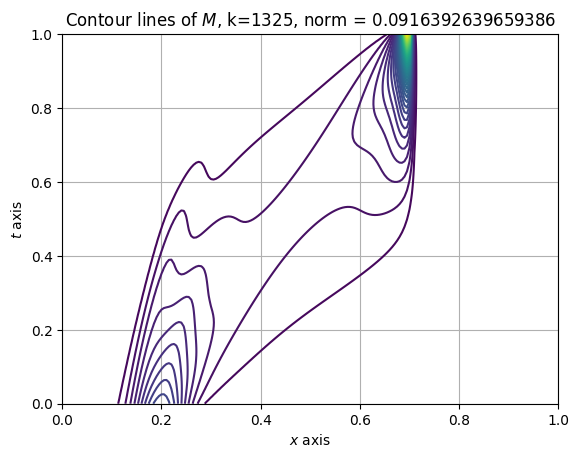

[Fixed Point] Iteration 1325, previous norm: 0.0916392639659386, theta: 0.002, elapsed time: 872.1914501190186
[Fixed Point] Iteration 1326, previous norm: 0.09159394835052649, theta: 0.002, elapsed time: 872.9470629692078
[Fixed Point] Iteration 1327, previous norm: 0.09155124314323303, theta: 0.002, elapsed time: 873.5415890216827
[Fixed Point] Iteration 1328, previous norm: 0.09151117389728117, theta: 0.002, elapsed time: 874.1360294818878
[Fixed Point] Iteration 1329, previous norm: 0.09147376560483846, theta: 0.002, elapsed time: 874.7508487701416
[Fixed Point] Iteration 1330, previous norm: 0.09143904266992822, theta: 0.002, elapsed time: 875.3226029872894
[Fixed Point] Iteration 1331, previous norm: 0.09140702888129736, theta: 0.002, elapsed time: 875.9480655193329
[Fixed Point] Iteration 1332, previous norm: 0.09137774738539, theta: 0.002, elapsed time: 876.5225465297699
[Fixed Point] Iteration 1333, previous norm: 0.09135122065937933, theta: 0.002, elapsed time: 877.1252179145

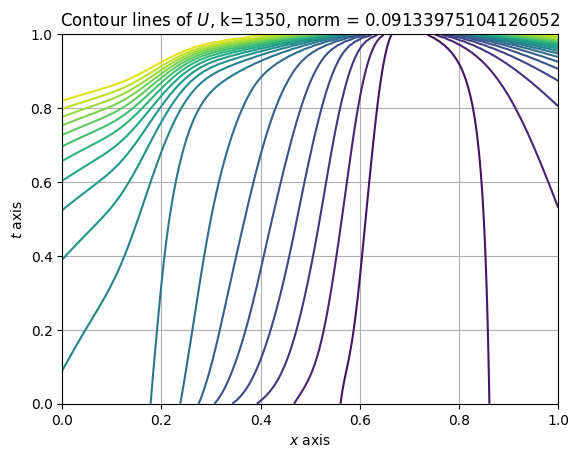

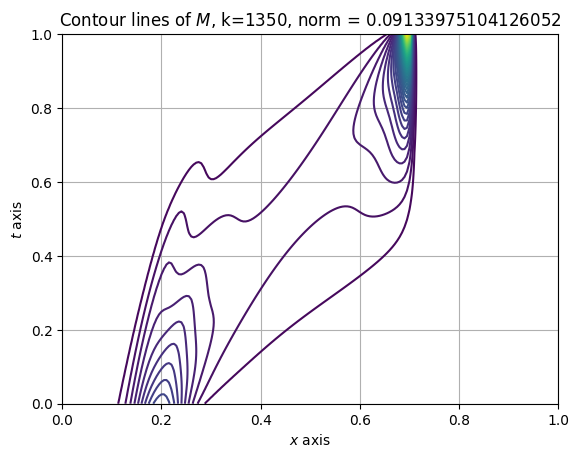

[Fixed Point] Iteration 1350, previous norm: 0.09133975104126052, theta: 0.002, elapsed time: 889.7068319320679
[Fixed Point] Iteration 1351, previous norm: 0.09136573557225677, theta: 0.002, elapsed time: 890.551304101944
[Fixed Point] Iteration 1352, previous norm: 0.09139474083986651, theta: 0.002, elapsed time: 891.160275220871
[Fixed Point] Iteration 1353, previous norm: 0.0914267707463342, theta: 0.002, elapsed time: 891.7734806537628
[Fixed Point] Iteration 1354, previous norm: 0.09146182804615931, theta: 0.002, elapsed time: 892.3437187671661
[Fixed Point] Iteration 1355, previous norm: 0.09149991433056935, theta: 0.002, elapsed time: 892.9180178642273
[Fixed Point] Iteration 1356, previous norm: 0.09154103001299177, theta: 0.002, elapsed time: 893.4527630805969
[Fixed Point] Iteration 1357, previous norm: 0.0915851743154085, theta: 0.002, elapsed time: 894.0034902095795
[Fixed Point] Iteration 1358, previous norm: 0.09163234525570665, theta: 0.002, elapsed time: 894.7326183319

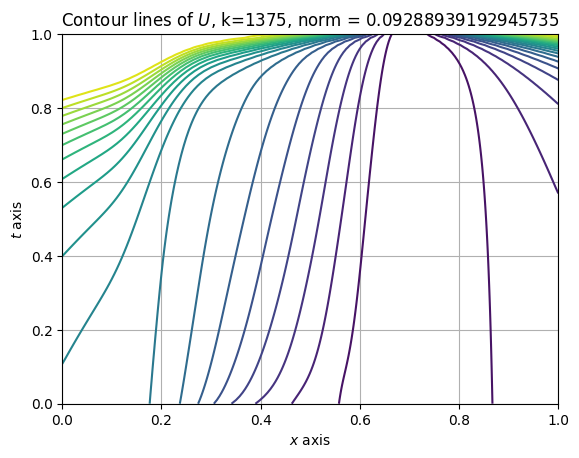

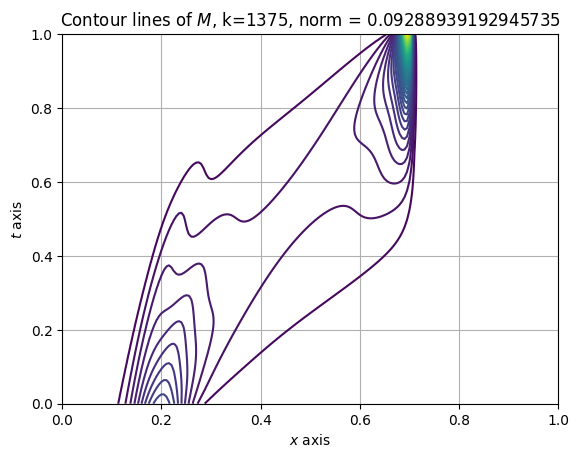

[Fixed Point] Iteration 1375, previous norm: 0.09288939192945735, theta: 0.002, elapsed time: 907.0068862438202
[Fixed Point] Iteration 1376, previous norm: 0.09298928242454556, theta: 0.002, elapsed time: 907.7449338436127
[Fixed Point] Iteration 1377, previous norm: 0.09309192397592415, theta: 0.002, elapsed time: 908.334486246109
[Fixed Point] Iteration 1378, previous norm: 0.09319728949875782, theta: 0.002, elapsed time: 909.0645620822906
[Fixed Point] Iteration 1379, previous norm: 0.09330535068705118, theta: 0.002, elapsed time: 910.5896782875061
[Fixed Point] Iteration 1380, previous norm: 0.09341607802487206, theta: 0.002, elapsed time: 911.570714712143
[Fixed Point] Iteration 1381, previous norm: 0.09352944079863022, theta: 0.002, elapsed time: 912.6543402671814
[Fixed Point] Iteration 1382, previous norm: 0.0936454071103375, theta: 0.002, elapsed time: 913.2430958747864
[Fixed Point] Iteration 1383, previous norm: 0.09376394389185971, theta: 0.002, elapsed time: 913.809810400

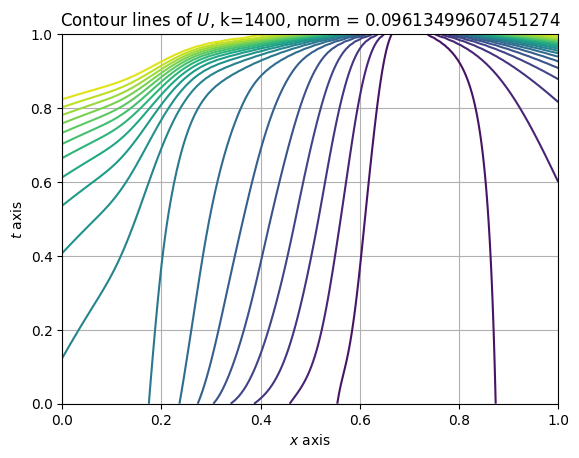

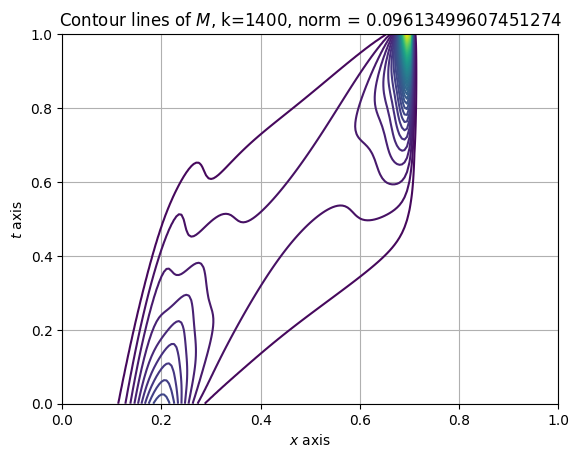

[Fixed Point] Iteration 1400, previous norm: 0.09613499607451274, theta: 0.002, elapsed time: 925.65869140625
[Fixed Point] Iteration 1401, previous norm: 0.09629292135527101, theta: 0.002, elapsed time: 926.6899132728577
[Fixed Point] Iteration 1402, previous norm: 0.09645259176191658, theta: 0.002, elapsed time: 927.2788393497467
[Fixed Point] Iteration 1403, previous norm: 0.09661395509371265, theta: 0.002, elapsed time: 927.8784620761871
[Fixed Point] Iteration 1404, previous norm: 0.09677695845681322, theta: 0.002, elapsed time: 928.516818523407
[Fixed Point] Iteration 1405, previous norm: 0.09694154829269411, theta: 0.002, elapsed time: 929.1271092891693
[Fixed Point] Iteration 1406, previous norm: 0.09710767040684003, theta: 0.002, elapsed time: 929.7481756210327
[Fixed Point] Iteration 1407, previous norm: 0.09727526999765736, theta: 0.002, elapsed time: 930.3065786361694
[Fixed Point] Iteration 1408, previous norm: 0.09744429168561443, theta: 0.002, elapsed time: 930.884342432

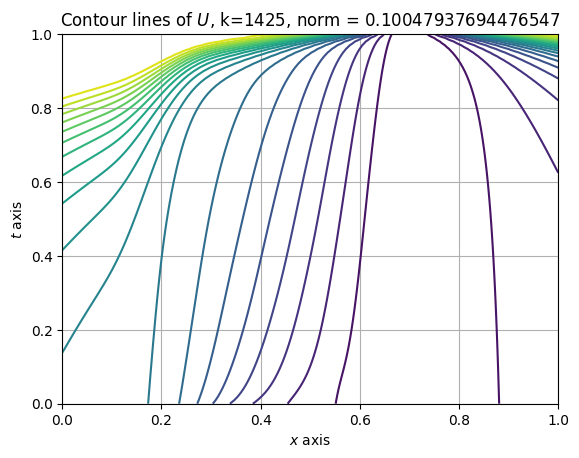

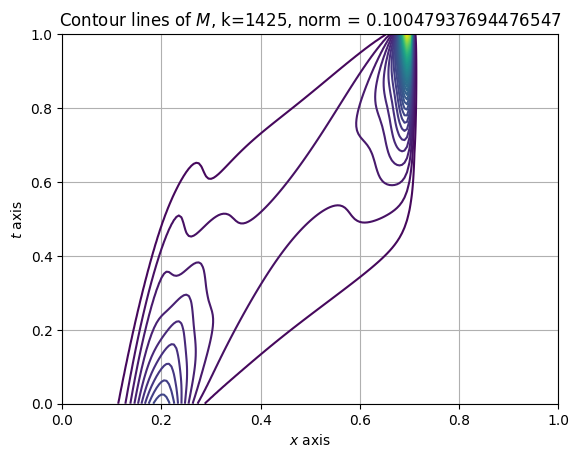

[Fixed Point] Iteration 1425, previous norm: 0.10047937694476547, theta: 0.002, elapsed time: 943.620178937912
[Fixed Point] Iteration 1426, previous norm: 0.1006640436404374, theta: 0.002, elapsed time: 944.3518149852753
[Fixed Point] Iteration 1427, previous norm: 0.10084900946736743, theta: 0.002, elapsed time: 944.9211158752441
[Fixed Point] Iteration 1428, previous norm: 0.10103421362218763, theta: 0.002, elapsed time: 945.5460121631622
[Fixed Point] Iteration 1429, previous norm: 0.10121959532635483, theta: 0.002, elapsed time: 946.1572709083557
[Fixed Point] Iteration 1430, previous norm: 0.10140509385239332, theta: 0.002, elapsed time: 946.7383716106415
[Fixed Point] Iteration 1431, previous norm: 0.10159064854970531, theta: 0.002, elapsed time: 947.3052146434784
[Fixed Point] Iteration 1432, previous norm: 0.10177619887002352, theta: 0.002, elapsed time: 947.8813316822052
[Fixed Point] Iteration 1433, previous norm: 0.10196168439245702, theta: 0.002, elapsed time: 948.48135948

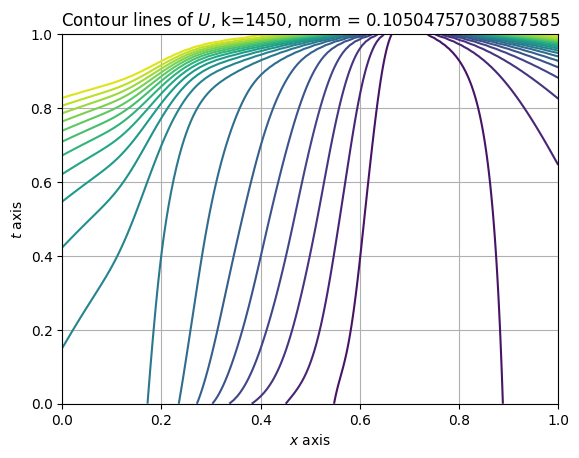

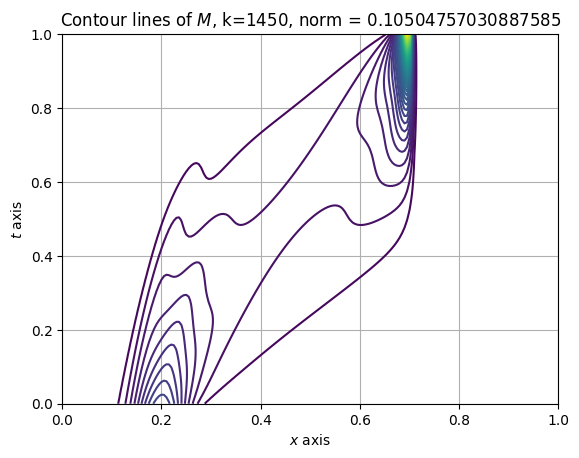

[Fixed Point] Iteration 1450, previous norm: 0.10504757030887585, theta: 0.002, elapsed time: 960.9570116996765
[Fixed Point] Iteration 1451, previous norm: 0.10522184090253828, theta: 0.002, elapsed time: 961.6597266197205
[Fixed Point] Iteration 1452, previous norm: 0.1053949529221783, theta: 0.002, elapsed time: 962.3124032020569
[Fixed Point] Iteration 1453, previous norm: 0.10556685304937832, theta: 0.002, elapsed time: 962.9095435142517
[Fixed Point] Iteration 1454, previous norm: 0.10573748851089891, theta: 0.002, elapsed time: 963.4796509742737
[Fixed Point] Iteration 1455, previous norm: 0.10590680709305404, theta: 0.002, elapsed time: 964.4002857208252
[Fixed Point] Iteration 1456, previous norm: 0.10607475715563083, theta: 0.002, elapsed time: 965.7539219856262
[Fixed Point] Iteration 1457, previous norm: 0.10624128764526727, theta: 0.002, elapsed time: 966.8384521007538
[Fixed Point] Iteration 1458, previous norm: 0.10640634810835936, theta: 0.002, elapsed time: 967.8369481

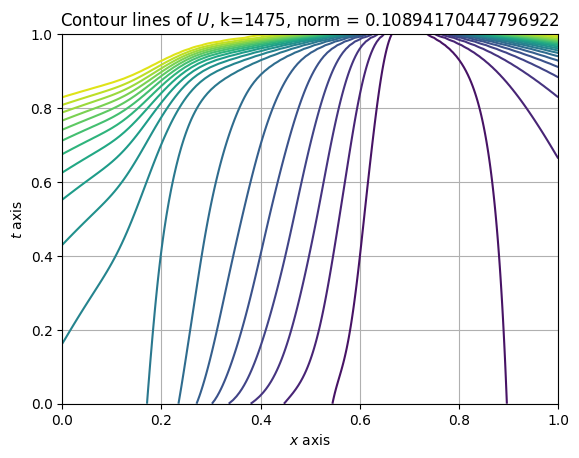

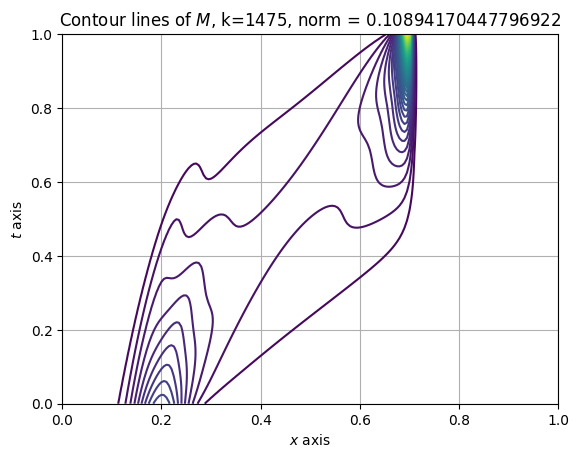

[Fixed Point] Iteration 1475, previous norm: 0.10894170447796922, theta: 0.002, elapsed time: 978.7922086715698
[Fixed Point] Iteration 1476, previous norm: 0.10907242511299692, theta: 0.002, elapsed time: 980.2791476249695
[Fixed Point] Iteration 1477, previous norm: 0.10920084471113549, theta: 0.002, elapsed time: 981.5591387748718
[Fixed Point] Iteration 1478, previous norm: 0.10932692679503153, theta: 0.002, elapsed time: 982.1221885681152
[Fixed Point] Iteration 1479, previous norm: 0.10945063565132473, theta: 0.002, elapsed time: 982.7507448196411
[Fixed Point] Iteration 1480, previous norm: 0.10957193633388229, theta: 0.002, elapsed time: 983.3632264137268
[Fixed Point] Iteration 1481, previous norm: 0.1096907946667347, theta: 0.002, elapsed time: 983.9315848350525
[Fixed Point] Iteration 1482, previous norm: 0.10980717724658699, theta: 0.002, elapsed time: 984.544065952301
[Fixed Point] Iteration 1483, previous norm: 0.1099210514450246, theta: 0.002, elapsed time: 985.154510021

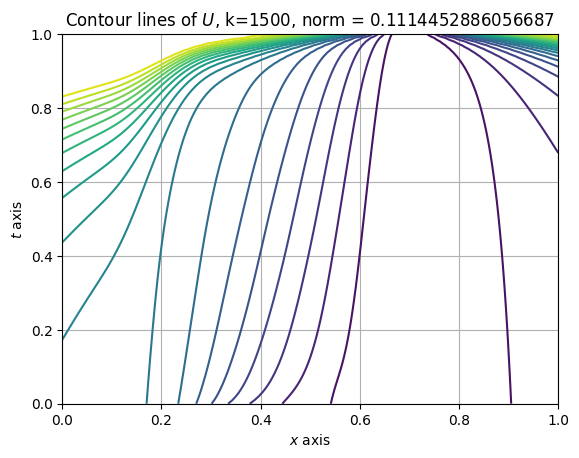

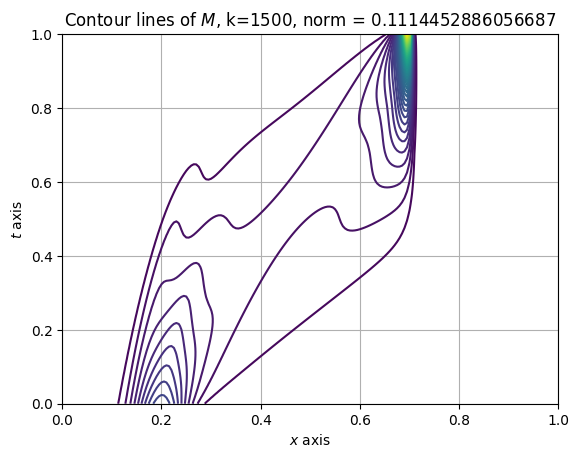

[Fixed Point] Iteration 1500, previous norm: 0.1114452886056687, theta: 0.002, elapsed time: 998.0325531959534
[Fixed Point] Iteration 1501, previous norm: 0.11150932065829015, theta: 0.002, elapsed time: 998.7667932510376
[Fixed Point] Iteration 1502, previous norm: 0.11157037226672091, theta: 0.002, elapsed time: 999.3963792324066
[Fixed Point] Iteration 1503, previous norm: 0.11162842629670078, theta: 0.002, elapsed time: 999.9614865779877
[Fixed Point] Iteration 1504, previous norm: 0.11168346636858953, theta: 0.002, elapsed time: 1000.5821342468262
[Fixed Point] Iteration 1505, previous norm: 0.111735476853926, theta: 0.002, elapsed time: 1001.2231142520905
[Fixed Point] Iteration 1506, previous norm: 0.11178444287173579, theta: 0.002, elapsed time: 1001.7843165397644
[Fixed Point] Iteration 1507, previous norm: 0.11183035028469099, theta: 0.002, elapsed time: 1002.4266374111176
[Fixed Point] Iteration 1508, previous norm: 0.11187318569511297, theta: 0.002, elapsed time: 1002.9761

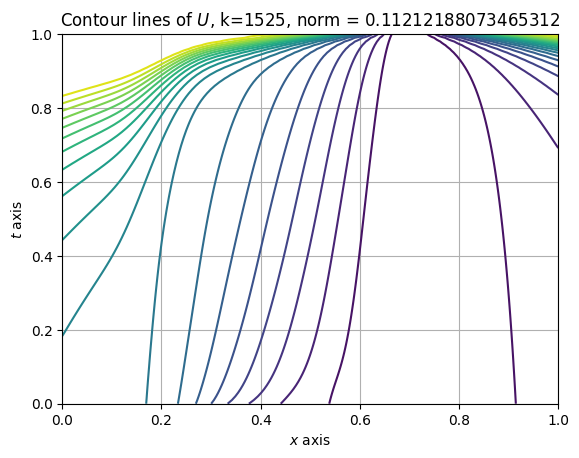

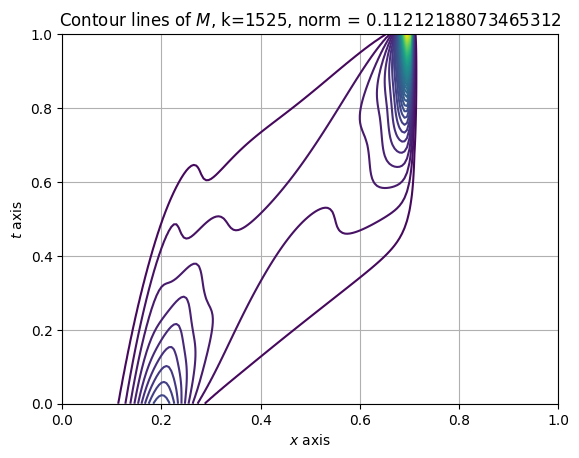

[Fixed Point] Iteration 1525, previous norm: 0.11212188073465312, theta: 0.002, elapsed time: 1015.4067368507385
[Fixed Point] Iteration 1526, previous norm: 0.11210794476294503, theta: 0.002, elapsed time: 1016.1214363574982
[Fixed Point] Iteration 1527, previous norm: 0.11209081647941312, theta: 0.002, elapsed time: 1016.7347650527954
[Fixed Point] Iteration 1528, previous norm: 0.11207049624587692, theta: 0.002, elapsed time: 1017.4002976417542
[Fixed Point] Iteration 1529, previous norm: 0.112046985053247, theta: 0.002, elapsed time: 1017.9943993091583
[Fixed Point] Iteration 1530, previous norm: 0.11202028451548292, theta: 0.002, elapsed time: 1018.5728900432587
[Fixed Point] Iteration 1531, previous norm: 0.11199039686344657, theta: 0.002, elapsed time: 1019.4877610206604
[Fixed Point] Iteration 1532, previous norm: 0.1119573249388057, theta: 0.002, elapsed time: 1020.7289485931396
[Fixed Point] Iteration 1533, previous norm: 0.11192107218782757, theta: 0.002, elapsed time: 1021.

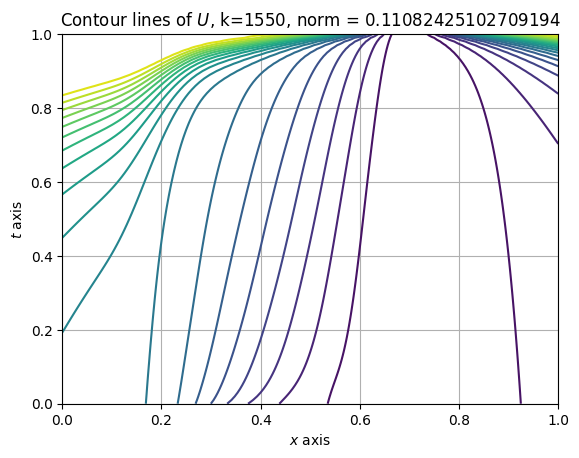

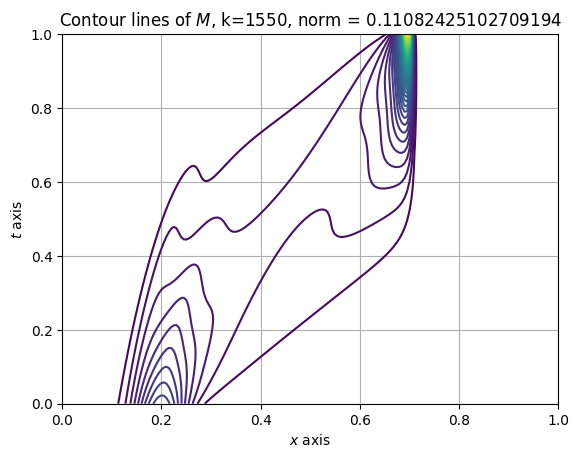

[Fixed Point] Iteration 1550, previous norm: 0.11082425102709194, theta: 0.002, elapsed time: 1033.5143420696259
[Fixed Point] Iteration 1551, previous norm: 0.11073198467192355, theta: 0.002, elapsed time: 1034.8286170959473
[Fixed Point] Iteration 1552, previous norm: 0.11063670955463228, theta: 0.002, elapsed time: 1035.9501631259918
[Fixed Point] Iteration 1553, previous norm: 0.11053843990572494, theta: 0.002, elapsed time: 1036.978833913803
[Fixed Point] Iteration 1554, previous norm: 0.11043719043027132, theta: 0.002, elapsed time: 1037.614274263382
[Fixed Point] Iteration 1555, previous norm: 0.11033297630188431, theta: 0.002, elapsed time: 1038.2978768348694
[Fixed Point] Iteration 1556, previous norm: 0.1102258131567935, theta: 0.002, elapsed time: 1038.9269592761993
[Fixed Point] Iteration 1557, previous norm: 0.1101157170879292, theta: 0.002, elapsed time: 1039.6307435035706
[Fixed Point] Iteration 1558, previous norm: 0.11000270463905945, theta: 0.002, elapsed time: 1040.2

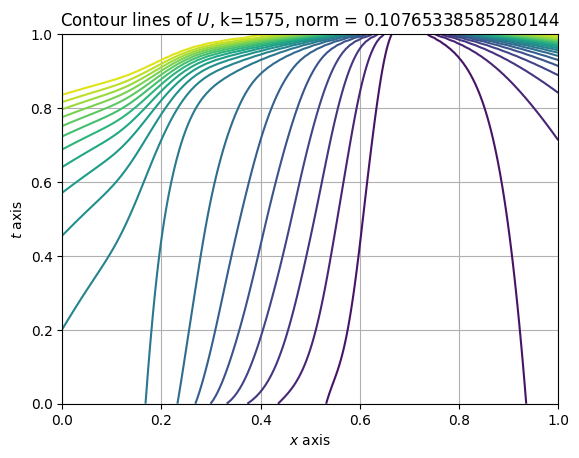

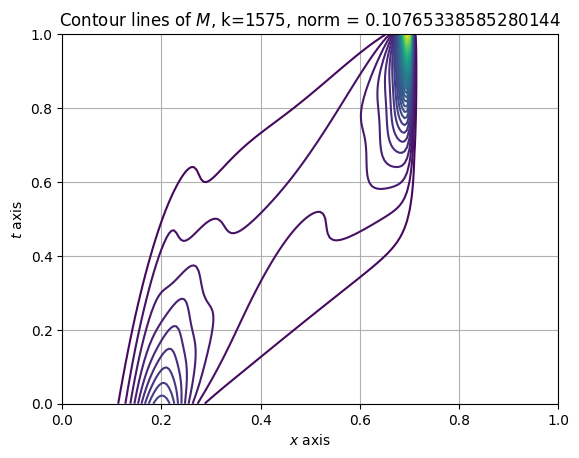

[Fixed Point] Iteration 1575, previous norm: 0.10765338585280144, theta: 0.002, elapsed time: 1053.0752489566803
[Fixed Point] Iteration 1576, previous norm: 0.10749118753154396, theta: 0.002, elapsed time: 1053.779201745987
[Fixed Point] Iteration 1577, previous norm: 0.10732646534337108, theta: 0.002, elapsed time: 1054.3989915847778
[Fixed Point] Iteration 1578, previous norm: 0.10715924368696604, theta: 0.002, elapsed time: 1055.0181303024292
[Fixed Point] Iteration 1579, previous norm: 0.1069895472995236, theta: 0.002, elapsed time: 1055.6064655780792
[Fixed Point] Iteration 1580, previous norm: 0.10681740125197582, theta: 0.002, elapsed time: 1056.2523038387299
[Fixed Point] Iteration 1581, previous norm: 0.10664283094425436, theta: 0.002, elapsed time: 1056.8085186481476
[Fixed Point] Iteration 1582, previous norm: 0.10646586210061083, theta: 0.002, elapsed time: 1057.4423468112946
[Fixed Point] Iteration 1583, previous norm: 0.10628652076500317, theta: 0.002, elapsed time: 1058

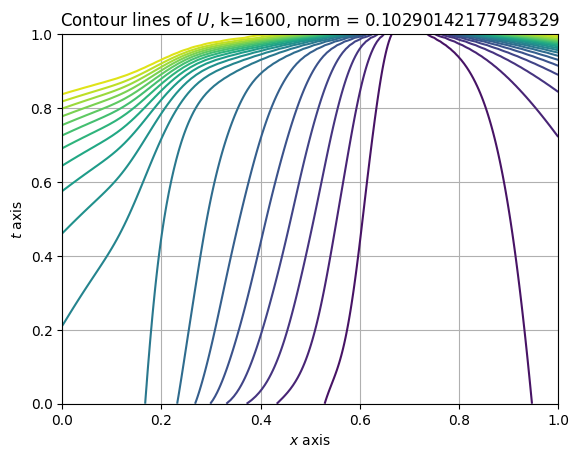

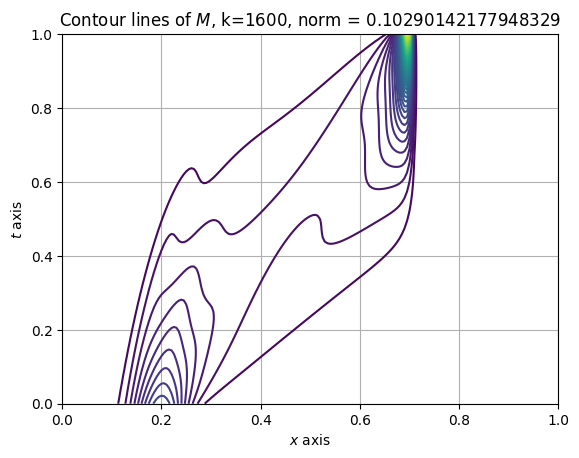

[Fixed Point] Iteration 1600, previous norm: 0.10290142177948329, theta: 0.002, elapsed time: 1070.851526260376
[Fixed Point] Iteration 1601, previous norm: 0.10268416713400841, theta: 0.002, elapsed time: 1071.6424927711487
[Fixed Point] Iteration 1602, previous norm: 0.10246508976737441, theta: 0.002, elapsed time: 1072.2554140090942
[Fixed Point] Iteration 1603, previous norm: 0.10224422121713796, theta: 0.002, elapsed time: 1072.8405644893646
[Fixed Point] Iteration 1604, previous norm: 0.10202159325359075, theta: 0.002, elapsed time: 1073.4158730506897
[Fixed Point] Iteration 1605, previous norm: 0.10179723787598159, theta: 0.002, elapsed time: 1073.9919016361237
[Fixed Point] Iteration 1606, previous norm: 0.10157118730878203, theta: 0.002, elapsed time: 1074.809591293335
[Fixed Point] Iteration 1607, previous norm: 0.10134347399794938, theta: 0.002, elapsed time: 1076.4094908237457
[Fixed Point] Iteration 1608, previous norm: 0.10111413060723812, theta: 0.002, elapsed time: 1077

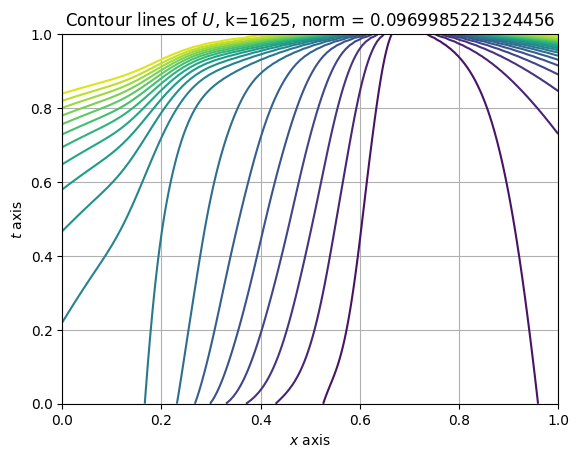

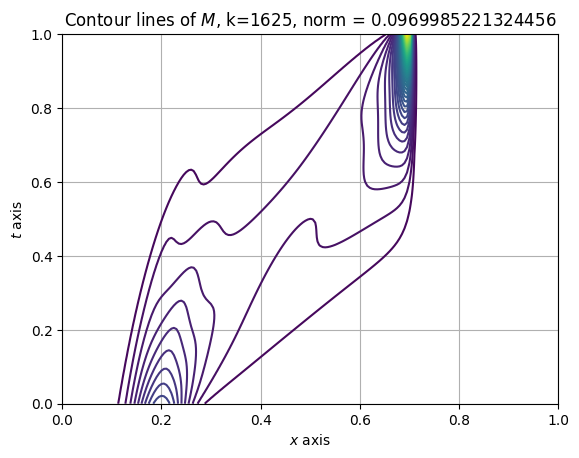

[Fixed Point] Iteration 1625, previous norm: 0.0969985221324456, theta: 0.002, elapsed time: 1088.4574868679047
[Fixed Point] Iteration 1626, previous norm: 0.09674564903378889, theta: 0.002, elapsed time: 1089.7916522026062
[Fixed Point] Iteration 1627, previous norm: 0.09649180294104442, theta: 0.002, elapsed time: 1091.1249289512634
[Fixed Point] Iteration 1628, previous norm: 0.0962370200959849, theta: 0.002, elapsed time: 1092.3402519226074
[Fixed Point] Iteration 1629, previous norm: 0.09598133687916621, theta: 0.002, elapsed time: 1093.0082383155823
[Fixed Point] Iteration 1630, previous norm: 0.09572478980588466, theta: 0.002, elapsed time: 1093.5660254955292
[Fixed Point] Iteration 1631, previous norm: 0.09546741552202322, theta: 0.002, elapsed time: 1094.1625936031342
[Fixed Point] Iteration 1632, previous norm: 0.09520925079986592, theta: 0.002, elapsed time: 1094.752748966217
[Fixed Point] Iteration 1633, previous norm: 0.09495033253384487, theta: 0.002, elapsed time: 1095.

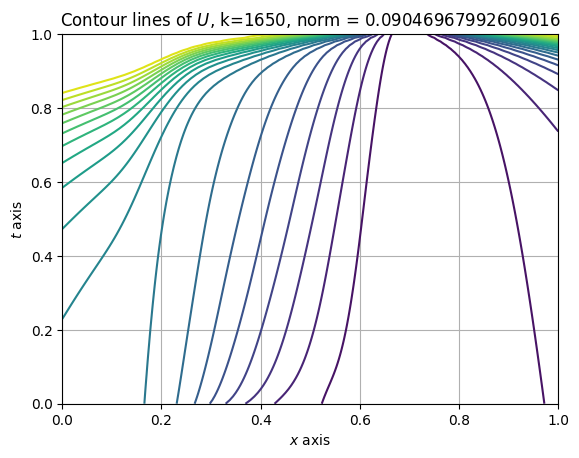

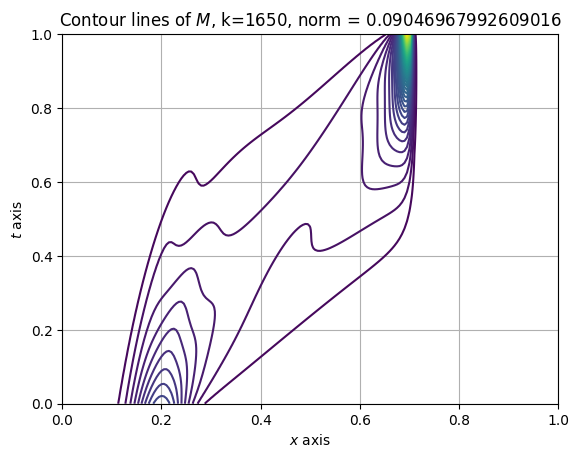

[Fixed Point] Iteration 1650, previous norm: 0.09046967992609016, theta: 0.002, elapsed time: 1108.2947375774384
[Fixed Point] Iteration 1651, previous norm: 0.09020361849153248, theta: 0.002, elapsed time: 1109.0638406276703
[Fixed Point] Iteration 1652, previous norm: 0.08993752144590404, theta: 0.002, elapsed time: 1109.6380829811096
[Fixed Point] Iteration 1653, previous norm: 0.08967142709672811, theta: 0.002, elapsed time: 1110.2451491355896
[Fixed Point] Iteration 1654, previous norm: 0.08940537376189654, theta: 0.002, elapsed time: 1110.8650951385498
[Fixed Point] Iteration 1655, previous norm: 0.08913939976289519, theta: 0.002, elapsed time: 1111.477864742279
[Fixed Point] Iteration 1656, previous norm: 0.08887354341788124, theta: 0.002, elapsed time: 1112.1169922351837
[Fixed Point] Iteration 1657, previous norm: 0.08860784303453591, theta: 0.002, elapsed time: 1112.738746881485
[Fixed Point] Iteration 1658, previous norm: 0.0883423369028118, theta: 0.002, elapsed time: 1113.

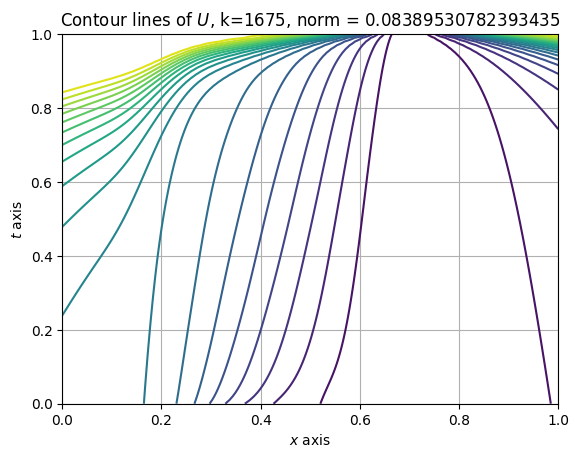

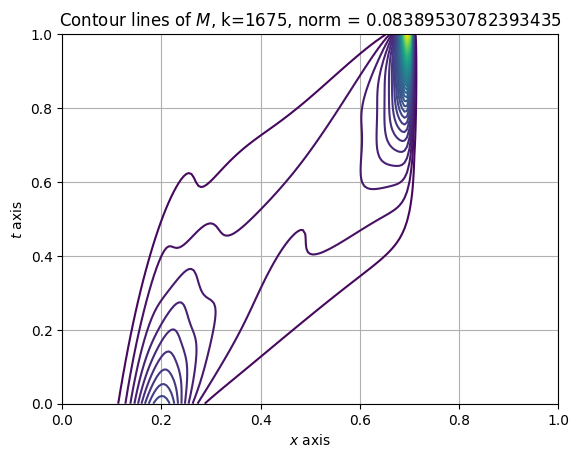

[Fixed Point] Iteration 1675, previous norm: 0.08389530782393435, theta: 0.002, elapsed time: 1126.140064239502
[Fixed Point] Iteration 1676, previous norm: 0.08363977694543837, theta: 0.002, elapsed time: 1127.0416243076324
[Fixed Point] Iteration 1677, previous norm: 0.08338515334968394, theta: 0.002, elapsed time: 1127.6631331443787
[Fixed Point] Iteration 1678, previous norm: 0.08313147313738854, theta: 0.002, elapsed time: 1128.2994713783264
[Fixed Point] Iteration 1679, previous norm: 0.08287877219147609, theta: 0.002, elapsed time: 1128.9324223995209
[Fixed Point] Iteration 1680, previous norm: 0.08262708616511241, theta: 0.002, elapsed time: 1129.506767988205
[Fixed Point] Iteration 1681, previous norm: 0.08237645046948841, theta: 0.002, elapsed time: 1130.4235899448395
[Fixed Point] Iteration 1682, previous norm: 0.08212690026136435, theta: 0.002, elapsed time: 1131.9166250228882
[Fixed Point] Iteration 1683, previous norm: 0.08187847043041362, theta: 0.002, elapsed time: 1133

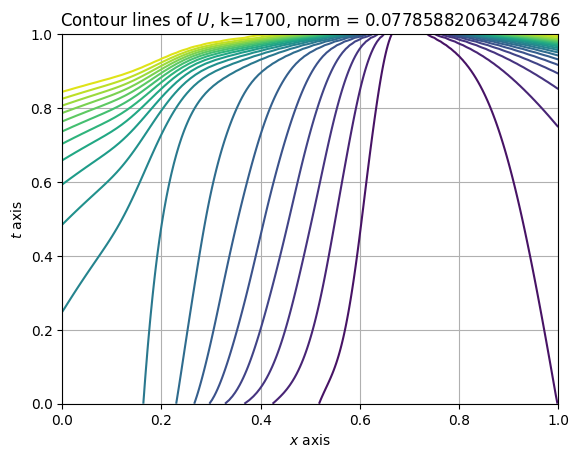

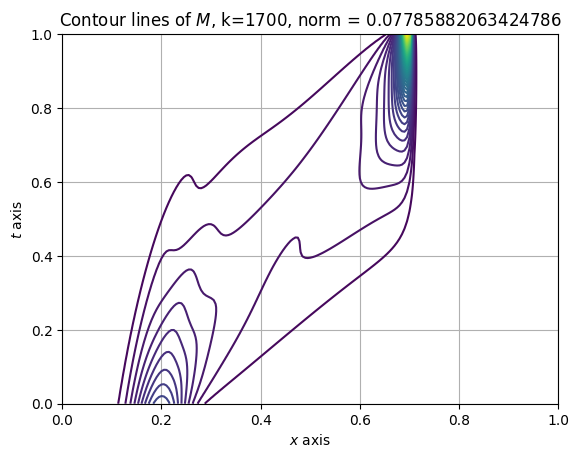

[Fixed Point] Iteration 1700, previous norm: 0.07785882063424786, theta: 0.002, elapsed time: 1145.1556062698364
[Fixed Point] Iteration 1701, previous norm: 0.07763613762791348, theta: 0.002, elapsed time: 1146.4631328582764
[Fixed Point] Iteration 1702, previous norm: 0.07741516872593798, theta: 0.002, elapsed time: 1147.6481227874756
[Fixed Point] Iteration 1703, previous norm: 0.0771959404930332, theta: 0.002, elapsed time: 1148.2818138599396
[Fixed Point] Iteration 1704, previous norm: 0.0769784789151714, theta: 0.002, elapsed time: 1148.93492269516
[Fixed Point] Iteration 1705, previous norm: 0.07676280938321241, theta: 0.002, elapsed time: 1149.5196597576141
[Fixed Point] Iteration 1706, previous norm: 0.07654895667648068, theta: 0.002, elapsed time: 1150.1138851642609
[Fixed Point] Iteration 1707, previous norm: 0.07633694494631325, theta: 0.002, elapsed time: 1150.706426858902
[Fixed Point] Iteration 1708, previous norm: 0.07612679769956161, theta: 0.002, elapsed time: 1151.30

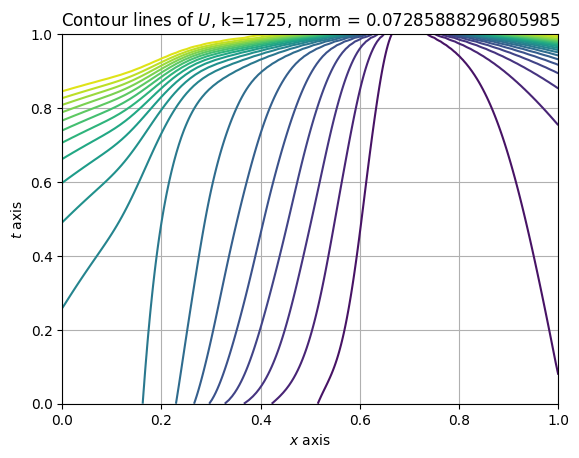

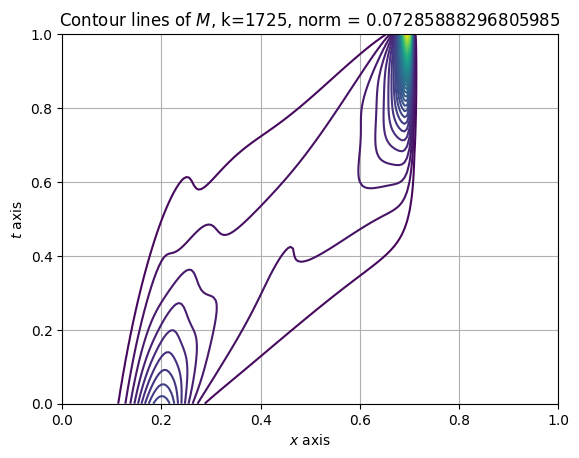

[Fixed Point] Iteration 1725, previous norm: 0.07285888296805985, theta: 0.002, elapsed time: 1164.60275888443
[Fixed Point] Iteration 1726, previous norm: 0.07268548381736148, theta: 0.002, elapsed time: 1165.530125617981
[Fixed Point] Iteration 1727, previous norm: 0.07251425181542157, theta: 0.002, elapsed time: 1166.197666168213
[Fixed Point] Iteration 1728, previous norm: 0.07234519423897526, theta: 0.002, elapsed time: 1166.8490703105927
[Fixed Point] Iteration 1729, previous norm: 0.07217831740121794, theta: 0.002, elapsed time: 1167.508512020111
[Fixed Point] Iteration 1730, previous norm: 0.07201362663964665, theta: 0.002, elapsed time: 1168.104897260666
[Fixed Point] Iteration 1731, previous norm: 0.07185112630439448, theta: 0.002, elapsed time: 1168.7153220176697
[Fixed Point] Iteration 1732, previous norm: 0.07169081974697701, theta: 0.002, elapsed time: 1169.2876324653625
[Fixed Point] Iteration 1733, previous norm: 0.07153270930958479, theta: 0.002, elapsed time: 1169.944

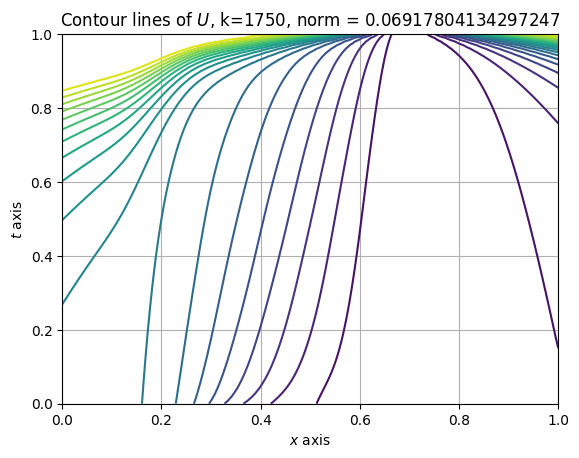

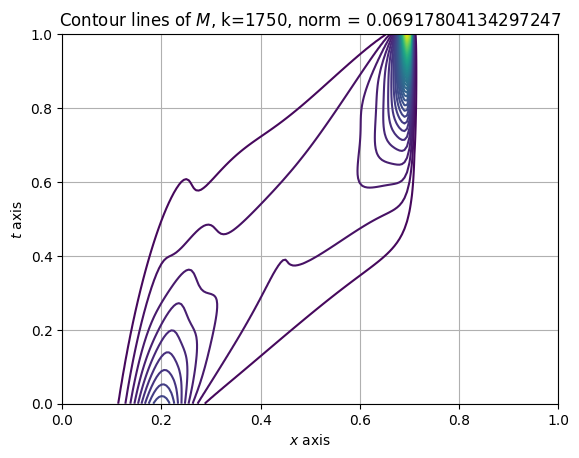

[Fixed Point] Iteration 1750, previous norm: 0.06917804134297247, theta: 0.002, elapsed time: 1183.2451877593994
[Fixed Point] Iteration 1751, previous norm: 0.06905866186847247, theta: 0.002, elapsed time: 1183.9536159038544
[Fixed Point] Iteration 1752, previous norm: 0.0689413212904228, theta: 0.002, elapsed time: 1184.6072804927826
[Fixed Point] Iteration 1753, previous norm: 0.0688260004545239, theta: 0.002, elapsed time: 1185.6537554264069
[Fixed Point] Iteration 1754, previous norm: 0.06871267912151384, theta: 0.002, elapsed time: 1186.9146091938019
[Fixed Point] Iteration 1755, previous norm: 0.06860133597209687, theta: 0.002, elapsed time: 1188.0767481327057
[Fixed Point] Iteration 1756, previous norm: 0.06849194861281568, theta: 0.002, elapsed time: 1188.8329029083252
[Fixed Point] Iteration 1757, previous norm: 0.06838449358275327, theta: 0.002, elapsed time: 1189.4189195632935
[Fixed Point] Iteration 1758, previous norm: 0.0682789463611787, theta: 0.002, elapsed time: 1190.

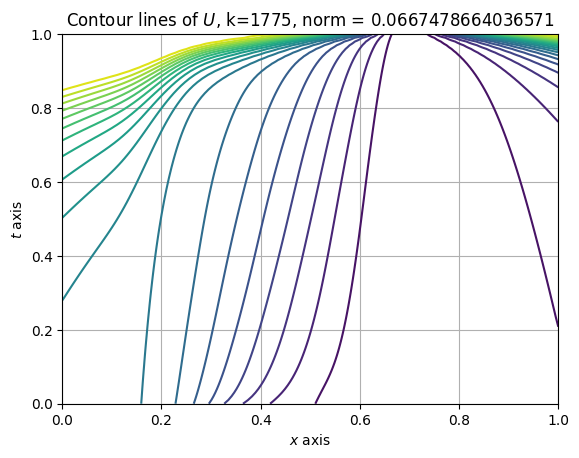

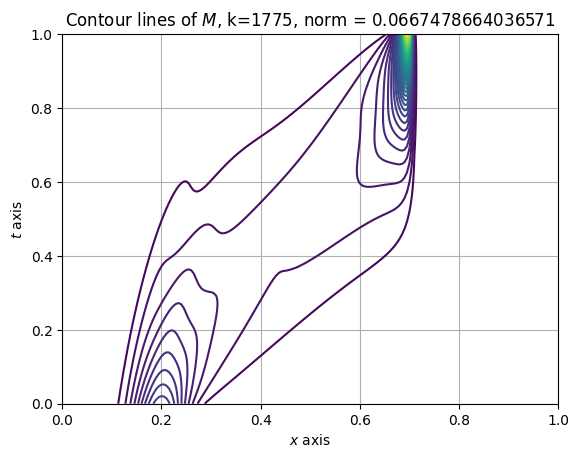

[Fixed Point] Iteration 1775, previous norm: 0.0667478664036571, theta: 0.002, elapsed time: 1203.6110022068024
[Fixed Point] Iteration 1776, previous norm: 0.06667132833564629, theta: 0.002, elapsed time: 1204.4052028656006
[Fixed Point] Iteration 1777, previous norm: 0.06659604770760819, theta: 0.002, elapsed time: 1205.0533146858215
[Fixed Point] Iteration 1778, previous norm: 0.06652198183202665, theta: 0.002, elapsed time: 1205.7771718502045
[Fixed Point] Iteration 1779, previous norm: 0.06644908733751881, theta: 0.002, elapsed time: 1206.4375655651093
[Fixed Point] Iteration 1780, previous norm: 0.06637732019724757, theta: 0.002, elapsed time: 1207.0845000743866
[Fixed Point] Iteration 1781, previous norm: 0.06630663575836289, theta: 0.002, elapsed time: 1207.7144644260406
[Fixed Point] Iteration 1782, previous norm: 0.06623698877235619, theta: 0.002, elapsed time: 1208.3678393363953
[Fixed Point] Iteration 1783, previous norm: 0.06616833342642561, theta: 0.002, elapsed time: 120

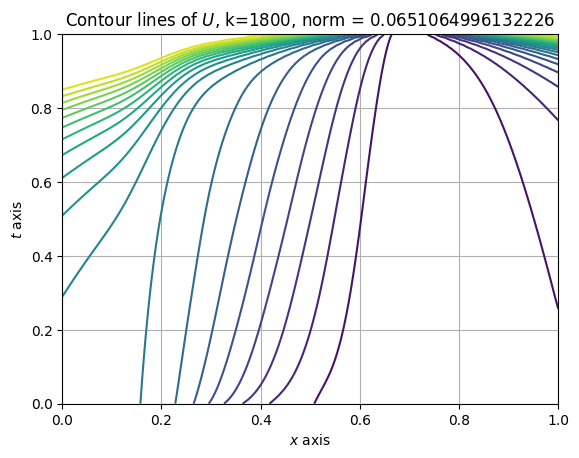

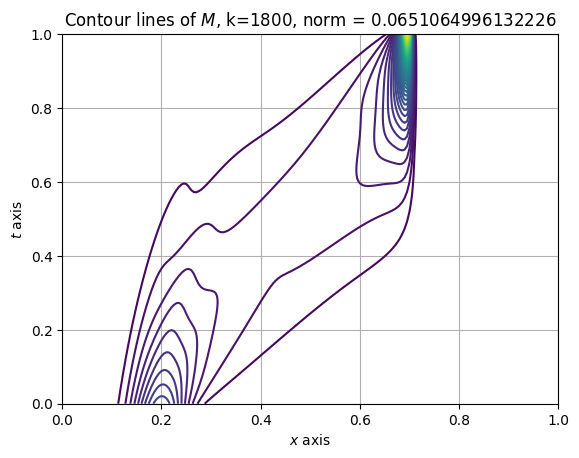

[Fixed Point] Iteration 1800, previous norm: 0.0651064996132226, theta: 0.002, elapsed time: 1222.275181055069
[Fixed Point] Iteration 1801, previous norm: 0.06504743061069972, theta: 0.002, elapsed time: 1223.1192877292633
[Fixed Point] Iteration 1802, previous norm: 0.0649884246742942, theta: 0.002, elapsed time: 1223.736011981964
[Fixed Point] Iteration 1803, previous norm: 0.06492943285753186, theta: 0.002, elapsed time: 1224.3985540866852
[Fixed Point] Iteration 1804, previous norm: 0.06487040654709957, theta: 0.002, elapsed time: 1225.0109078884125
[Fixed Point] Iteration 1805, previous norm: 0.0648112975178197, theta: 0.002, elapsed time: 1225.695719242096
[Fixed Point] Iteration 1806, previous norm: 0.06475205798886302, theta: 0.002, elapsed time: 1226.6693704128265
[Fixed Point] Iteration 1807, previous norm: 0.06469264068117299, theta: 0.002, elapsed time: 1228.0465235710144
[Fixed Point] Iteration 1808, previous norm: 0.06463299887610977, theta: 0.002, elapsed time: 1229.134

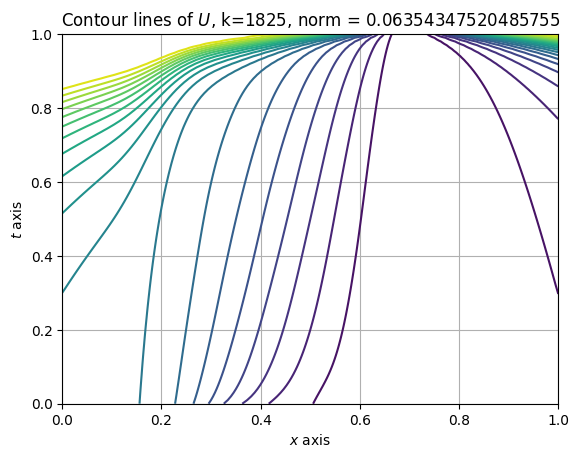

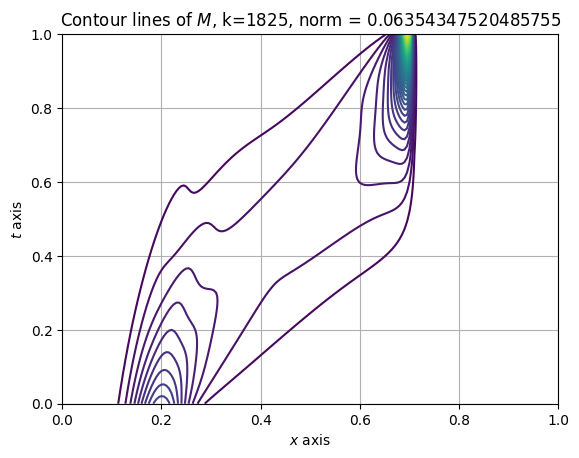

[Fixed Point] Iteration 1825, previous norm: 0.06354347520485755, theta: 0.002, elapsed time: 1241.3604652881622
[Fixed Point] Iteration 1826, previous norm: 0.06347282772587218, theta: 0.002, elapsed time: 1242.8552100658417
[Fixed Point] Iteration 1827, previous norm: 0.063401262139398, theta: 0.002, elapsed time: 1244.1792809963226
[Fixed Point] Iteration 1828, previous norm: 0.06332875727472063, theta: 0.002, elapsed time: 1244.8863291740417
[Fixed Point] Iteration 1829, previous norm: 0.06325529405789682, theta: 0.002, elapsed time: 1245.4732191562653
[Fixed Point] Iteration 1830, previous norm: 0.0631808555991826, theta: 0.002, elapsed time: 1246.0955550670624
[Fixed Point] Iteration 1831, previous norm: 0.06310542728153451, theta: 0.002, elapsed time: 1246.7989978790283
[Fixed Point] Iteration 1832, previous norm: 0.06302899685016065, theta: 0.002, elapsed time: 1247.413211107254
[Fixed Point] Iteration 1833, previous norm: 0.06295155450307795, theta: 0.002, elapsed time: 1248.0

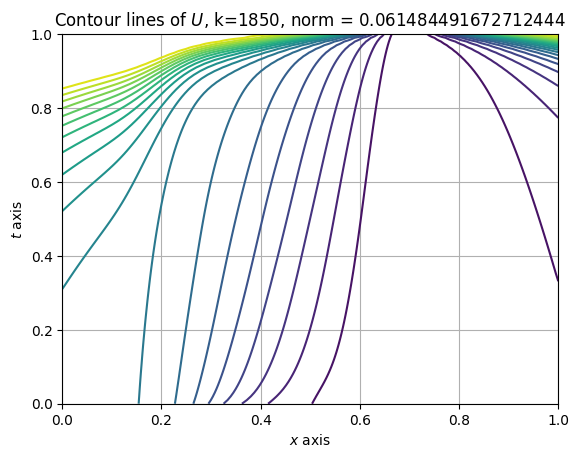

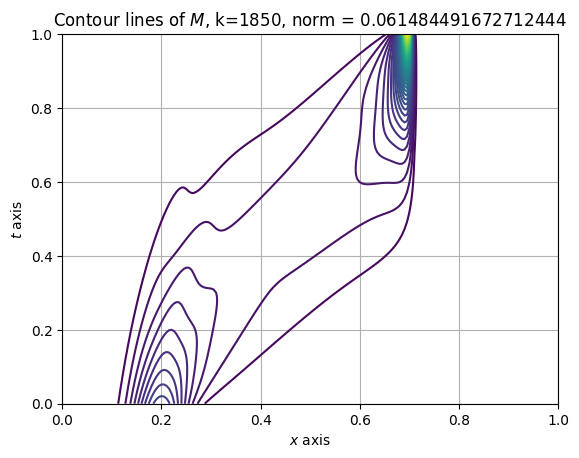

[Fixed Point] Iteration 1850, previous norm: 0.061484491672712444, theta: 0.002, elapsed time: 1261.6658775806427
[Fixed Point] Iteration 1851, previous norm: 0.061390513361713486, theta: 0.002, elapsed time: 1262.6629631519318
[Fixed Point] Iteration 1852, previous norm: 0.06129592719748198, theta: 0.002, elapsed time: 1263.2672770023346
[Fixed Point] Iteration 1853, previous norm: 0.06120079199276311, theta: 0.002, elapsed time: 1263.8848781585693
[Fixed Point] Iteration 1854, previous norm: 0.061105170919969094, theta: 0.002, elapsed time: 1264.472734451294
[Fixed Point] Iteration 1855, previous norm: 0.06100913158468164, theta: 0.002, elapsed time: 1265.1023547649384
[Fixed Point] Iteration 1856, previous norm: 0.06091274609513221, theta: 0.002, elapsed time: 1265.6942210197449
[Fixed Point] Iteration 1857, previous norm: 0.06081609112731742, theta: 0.002, elapsed time: 1266.3043451309204
[Fixed Point] Iteration 1858, previous norm: 0.06071924798528884, theta: 0.002, elapsed time: 

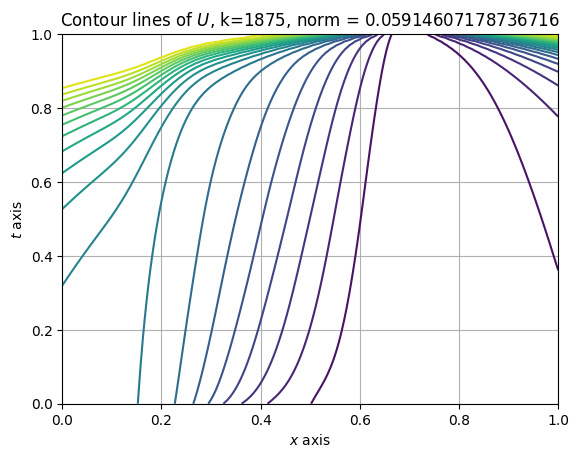

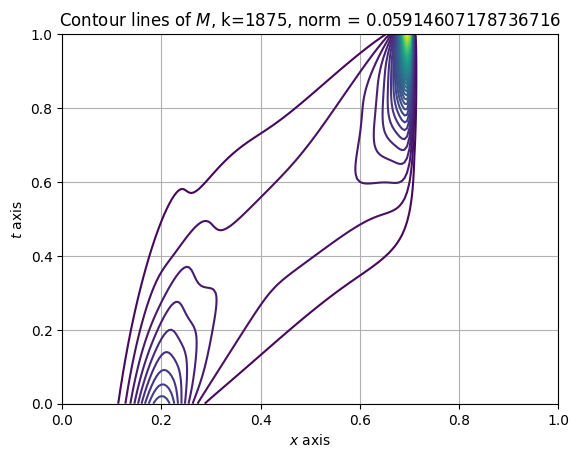

[Fixed Point] Iteration 1875, previous norm: 0.05914607178736716, theta: 0.002, elapsed time: 1280.1213879585266
[Fixed Point] Iteration 1876, previous norm: 0.05906520189166865, theta: 0.002, elapsed time: 1280.9670867919922


In [ ]:
M = np.zeros((N_T+1, N_h))
M[:] = m0_hat(space_grid)

U = np.zeros((N_T+1, N_h))
U[:] = phi(space_grid)

U_fixed2, M_fixed2 = FixedPoint(U, M)

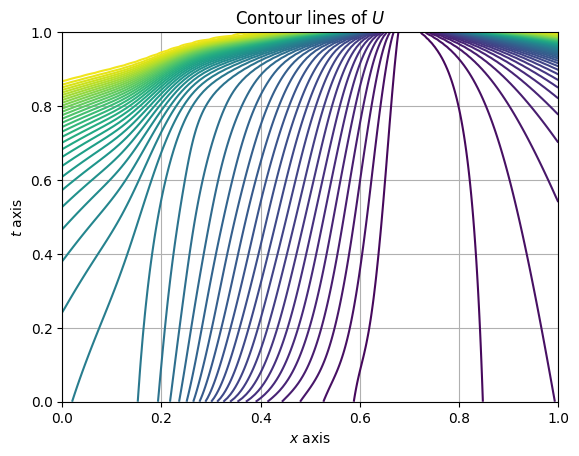

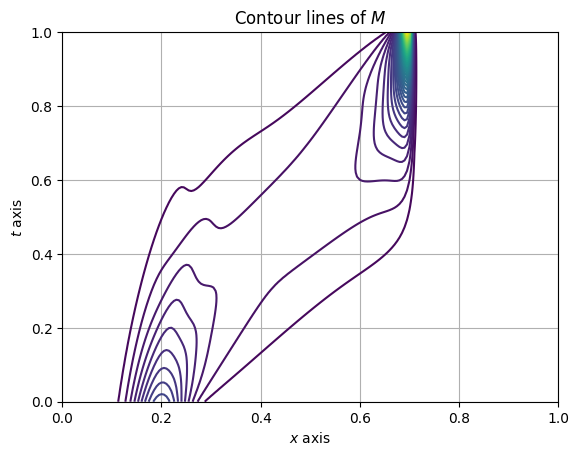

In [ ]:
plt.contour(space_grid, time_grid, U_fixed2, levels=50)
plt.title("Contour lines of $U$")
plt.xlabel("$x$ axis")
plt.ylabel("$t$ axis")
plt.grid()
plt.show()

plt.contour(space_grid, time_grid, M_fixed2, levels=50)
plt.grid()
plt.title("Contour lines of $M$")
plt.xlabel("$x$ axis")
plt.ylabel("$t$ axis")
plt.show()

### **2. Compare with the solution of the MFG with the same parameters**

We can notice that the whole shape of the solution for MFG (Mean Field Game) and MFC (Mean Field Control) are approximately similar. However, there are more field lines with MFG that are regular compared to those of MFC.